In [1]:
import os
import sys
cwd = os.getcwd()
module_path = os.path.abspath(os.path.join('..'))
sys.path.insert(0, os.path.join(cwd, "../"))

import pickle
import torch
import importlib
import numpy as np
import pandas as pd
import copy

import src.bin.tensorify as tensorify
import src.utils.data_conversion_utils as conversions
import src.data_manager.student_life_var_binned_data_manager as data_manager
import src.bin.trainer as trainer

from sklearn import metrics

from torch import nn
from copy import copy
from copy import deepcopy
from src import definitions
from src.bin import validations
from src.bin import statistics
from src.bin import plotting
from src.utils.read_utils import read_pickle
from src.utils import student_utils
from src.data_manager import sub_sampler
from src.data_manager import cross_val
from src.data_manager import helper as data_manager_helper
from tabulate import tabulate
from src.models import autoencoder
from src.models import multitask_learning
from src.models import user_dense_heads


pd.set_option('max_rows', 10000)

importlib.reload(validations)
importlib.reload(autoencoder)
importlib.reload(multitask_learning)
importlib.reload(user_dense_heads)
importlib.reload(sub_sampler)
importlib.reload(statistics)
importlib.reload(cross_val)
importlib.reload(definitions)
importlib.reload(conversions)
importlib.reload(tensorify)
importlib.reload(plotting)
importlib.reload(trainer)
importlib.reload(data_manager)
importlib.reload(student_utils)
importlib.reload(data_manager_helper)
feature_list = data_manager.FEATURE_LIST

data_file_name = 'training_date_normalized_midterm_select_features'
# ##### Pickle #####
data = read_pickle('../data/training_data/midterm_splits/{}.pkl'.format(data_file_name))


#### Data ####
# student_list = student_list =  [53, 46, 7, 49, 22, 24, 2]
# # student_list = [2]
# data = data_manager.get_data_for_training_in_dict_format(*student_list, normalize=True, 
#                                                          fill_na=True, flatten_sequence=False)

# ###### Randomize ######
# train_ids, val_ids, test_ids = cross_val.random_stratified_splits(data)
# data['train_ids'] = train_ids
# data['val_ids'] = val_ids
# data['test_ids'] = test_ids

# data = sub_sampler.get_sub_sampled_sequences(data)

############# Stats ############# 
# unnormalized_data = data_manager.get_data_for_training_in_dict_format(*student_list, normalize=False, fill_na=False)
# statistics_df, raw_df = statistics.get_statistics_on_data_dict(unnormalized_data, feature_list)
# print(statistics.get_train_test_val_label_counts_from_raw_data(data))


#### Data ####
# student_list =  [1, 2, 4 , 7,10, 22, 24, 33, 42, 46, 49, 53, 57 ]
# data = data_manager.get_data_for_training_in_dict_format(*student_list, normalize=True, 
#                                                          fill_na=True, flatten_sequence=False)

# ###### Randomize ######
# train_ids, val_ids, test_ids = cross_val.random_stratified_splits(data, stratify_by='students')
# data['train_ids'] = train_ids
# data['val_ids'] = val_ids
# data['test_ids'] = test_ids

# data = sub_sampler.get_sub_sampled_sequences(data)

############ Stats ############# 
# unnormalized_data = data_manager.get_data_for_training_in_dict_format(*student_list, normalize=False, fill_na=False)
# statistics_df, raw_df = statistics.get_statistics_on_data_dict(unnormalized_data, feature_list)
print(statistics.get_train_test_val_label_counts_from_raw_data(data))

      Train    Val    Test
--  -------  -----  ------
 0      139     33      12
 1      143     46      19
 2       74     41      25


In [2]:
################################## Init ##################################
use_historgram = True
autencoder_bottle_neck_feature_size = 128
autoencoder_num_layers = 1
alpha , beta = 0.00001, 1
decay = 0.0001
first_key = next(iter(data['data'].keys()))
if use_historgram:
    num_features = len(data['data'][first_key][4][0])
else:
    num_features = len(data['data'][first_key][0][0])
num_covariates = len(data['data'][first_key][3])
shared_hidden_layer_size = 256
user_dense_layer_hidden_size = 64
num_classes = 3
learning_rate = 0.000005
n_epochs = 300
shared_layer_dropout_prob=0.25
user_head_dropout_prob=0.25

print("Num Features:", num_features)

Num Features: 9


In [3]:
class_weights = torch.tensor(statistics.get_class_weights_in_inverse_proportion(data))
cuda_enabled = torch.cuda.is_available()
data = tensorify.tensorify_data_gru_d(data, cuda_enabled)

In [5]:
student_list = conversions.extract_distinct_student_idsfrom_keys(data['data'].keys())
model = multitask_learning.MultiTaskAutoEncoderLearner(
                               conversions.prepend_ids_with_string(student_list, "student_"),
                               num_features,
                               autencoder_bottle_neck_feature_size,
                               autoencoder_num_layers,
                               shared_hidden_layer_size,
                               user_dense_layer_hidden_size,
                               num_classes,
                               num_covariates,
                               shared_layer_dropout_prob,
                               user_head_dropout_prob)

if cuda_enabled:
    model.cuda()
    class_weights = class_weights.cuda()

reconstruction_criterion = torch.nn.L1Loss(reduction="sum")
classification_criterion = torch.nn.CrossEntropyLoss(weight=class_weights)
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate, weight_decay=decay)

/home/abhinavshaw/projects/MultiRes/student_life/notebooks/../src/models/autoencoder.py:21: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  nn.init.xavier_uniform(self.lstm.weight_ih_l0, gain=np.sqrt(2))
/home/abhinavshaw/projects/MultiRes/student_life/notebooks/../src/models/autoencoder.py:22: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  nn.init.xavier_uniform(self.lstm.weight_hh_l0, gain=np.sqrt(2))
/home/abhinavshaw/projects/MultiRes/student_life/notebooks/../src/models/autoencoder.py:56: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  nn.init.xavier_uniform(self.lstm.weight_ih_l0, gain=np.sqrt(2))
/home/abhinavshaw/projects/MultiRes/student_life/notebooks/../src/models/autoencoder.py:57: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  nn.init.xavier_uniform(self.lstm.weight_hh_l0, gain=np.sqrt(2))
/hom

xxxxxxxxxxxxxx epoch: 0 xxxxxxxxxxxxxx


/home/abhinavshaw/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/abhinavshaw/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


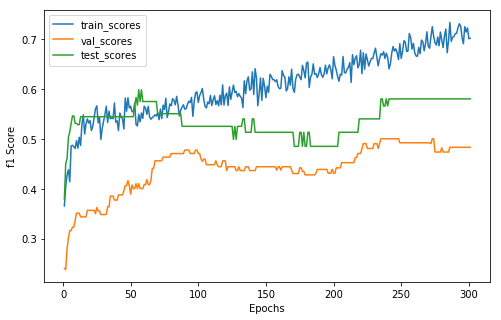

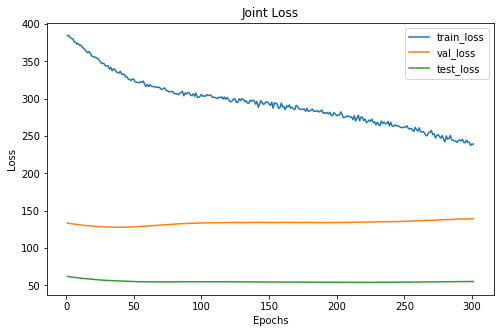

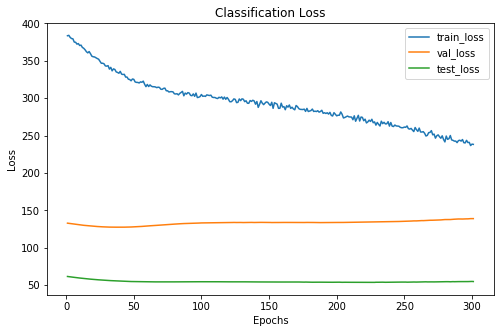

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      154     44      21
 1      144     48      27
 2       58     28       8
xxxxxxxxxxxxxx epoch: 1 xxxxxxxxxxxxxx


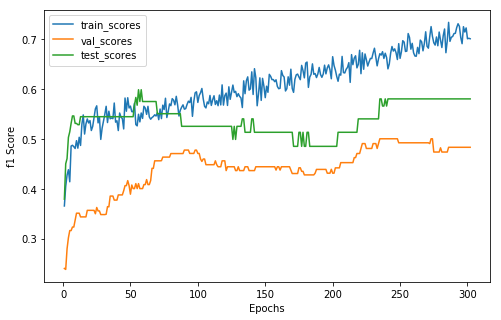

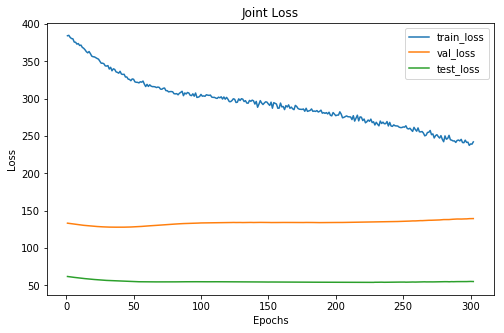

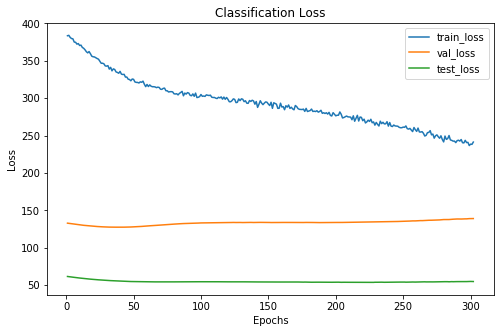

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      144     44      21
 1      152     48      27
 2       60     28       8
xxxxxxxxxxxxxx epoch: 2 xxxxxxxxxxxxxx


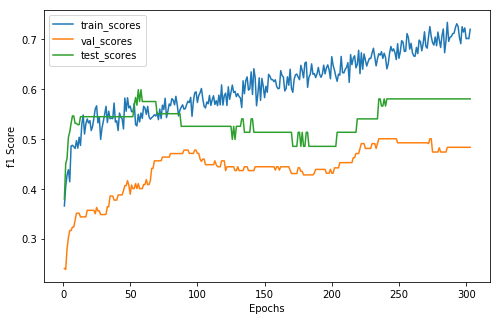

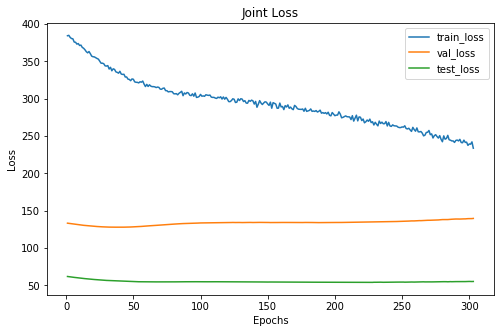

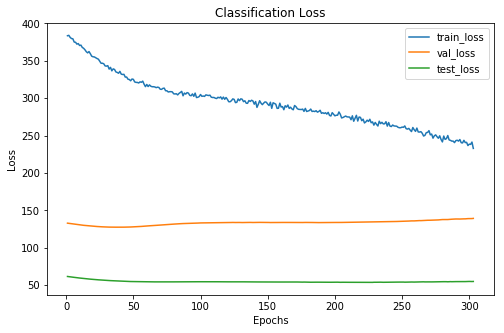

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     44      21
 1      152     48      27
 2       64     28       8
xxxxxxxxxxxxxx epoch: 3 xxxxxxxxxxxxxx


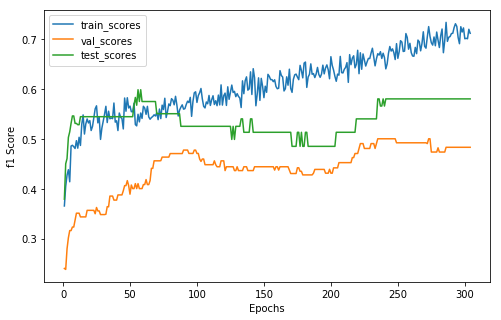

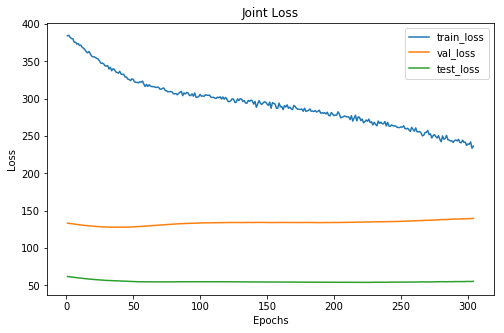

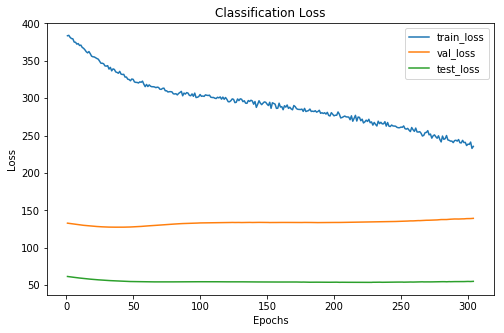

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     44      21
 1      152     48      27
 2       64     28       8
xxxxxxxxxxxxxx epoch: 4 xxxxxxxxxxxxxx


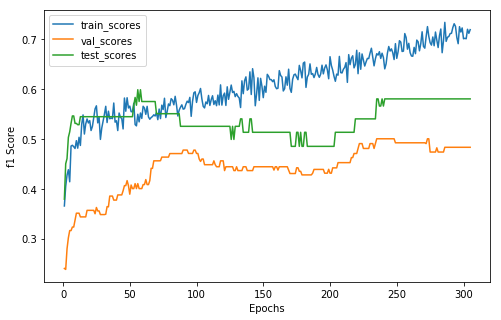

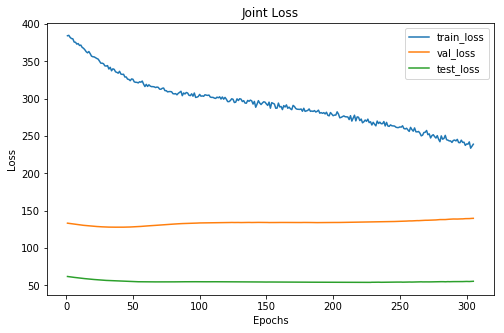

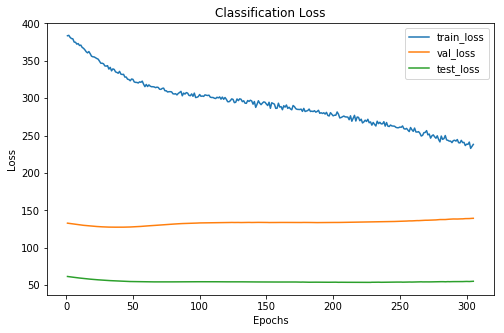

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     44      21
 1      155     48      27
 2       58     28       8
xxxxxxxxxxxxxx epoch: 5 xxxxxxxxxxxxxx


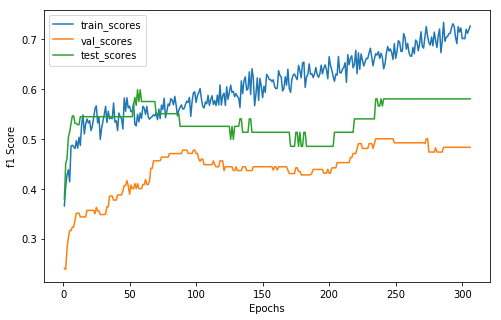

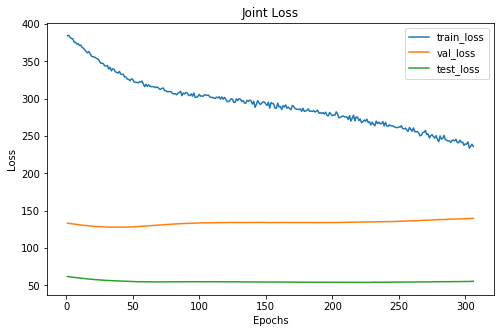

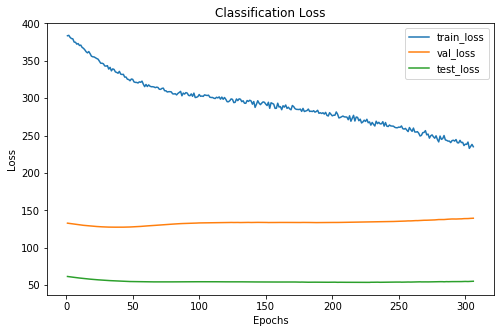

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      139     44      21
 1      149     48      27
 2       68     28       8
xxxxxxxxxxxxxx epoch: 6 xxxxxxxxxxxxxx


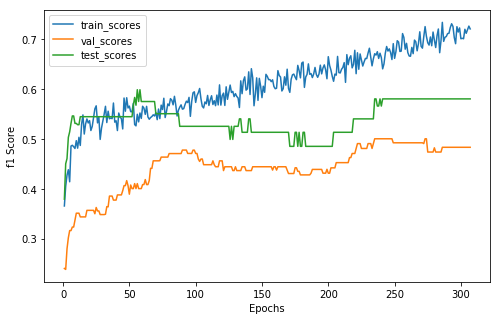

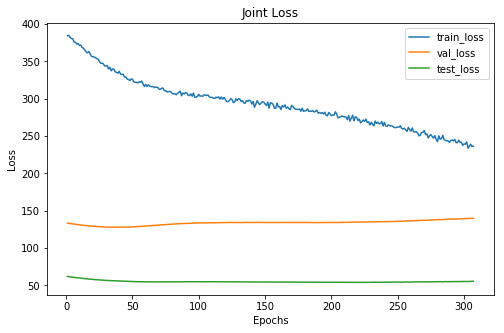

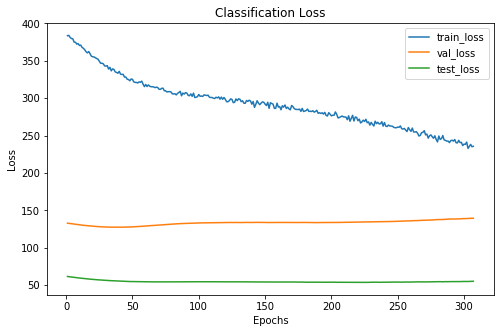

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      145     44      21
 1      145     48      27
 2       66     28       8
xxxxxxxxxxxxxx epoch: 7 xxxxxxxxxxxxxx


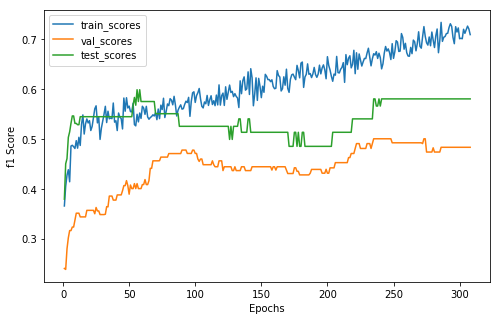

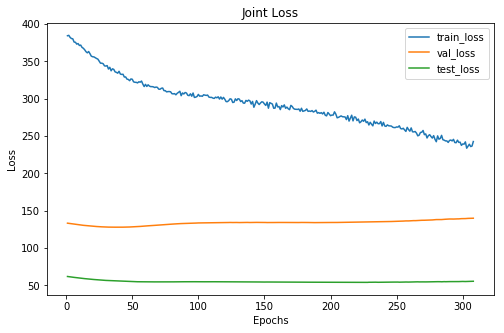

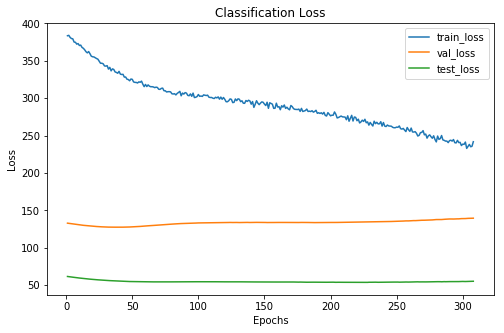

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      138     44      21
 1      153     48      27
 2       65     28       8
xxxxxxxxxxxxxx epoch: 8 xxxxxxxxxxxxxx


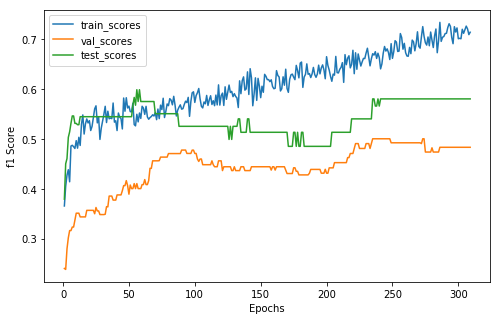

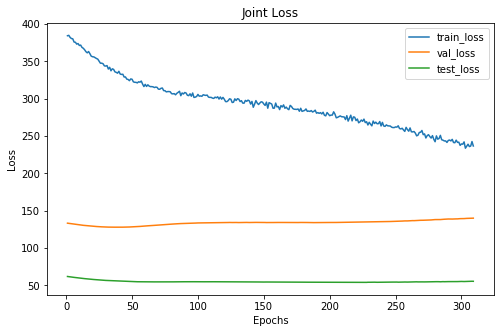

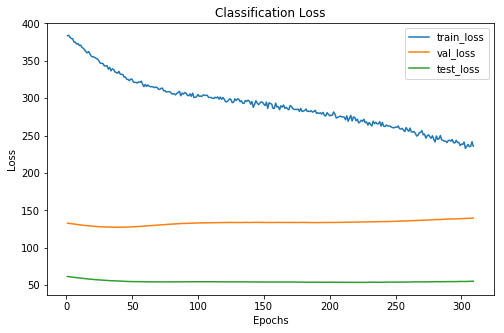

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      145     44      21
 1      148     48      27
 2       63     28       8
xxxxxxxxxxxxxx epoch: 9 xxxxxxxxxxxxxx


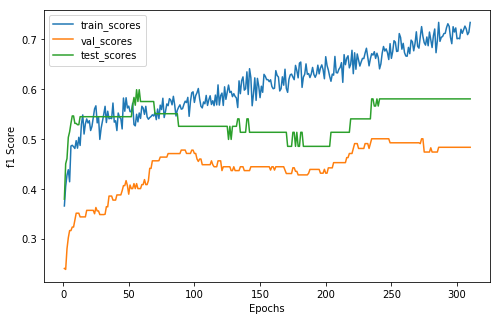

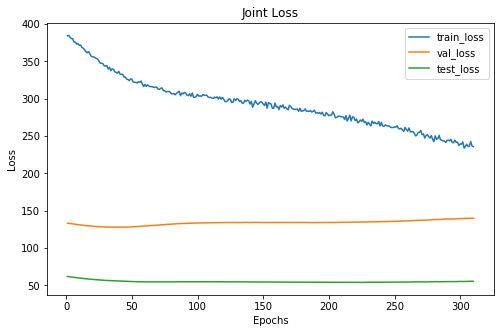

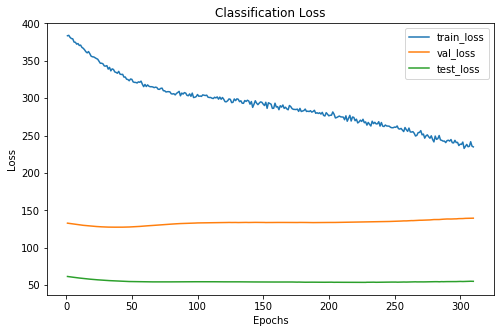

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     44      21
 1      154     48      27
 2       62     28       8
xxxxxxxxxxxxxx epoch: 10 xxxxxxxxxxxxxx


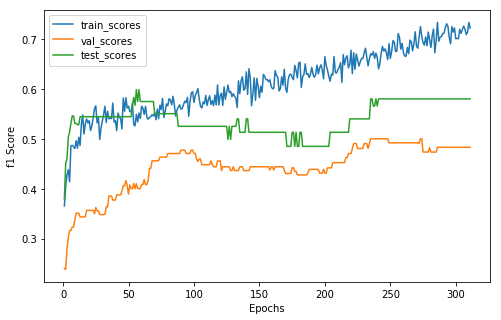

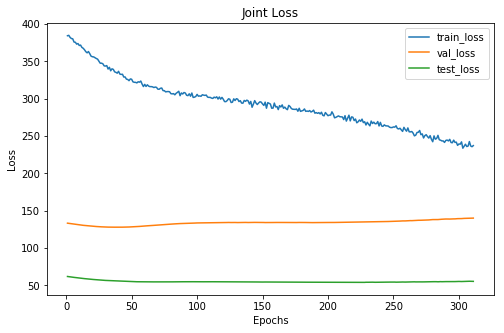

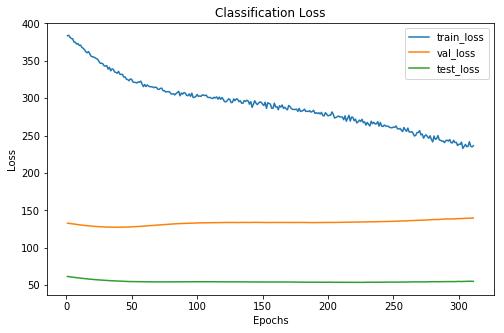

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      139     44      21
 1      155     48      27
 2       62     28       8
xxxxxxxxxxxxxx epoch: 11 xxxxxxxxxxxxxx


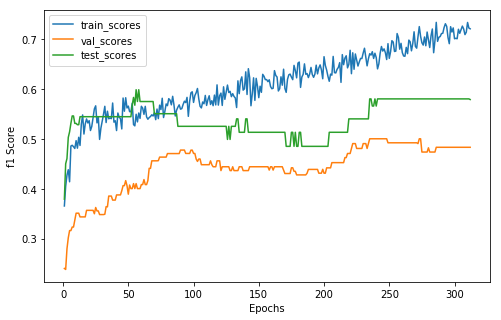

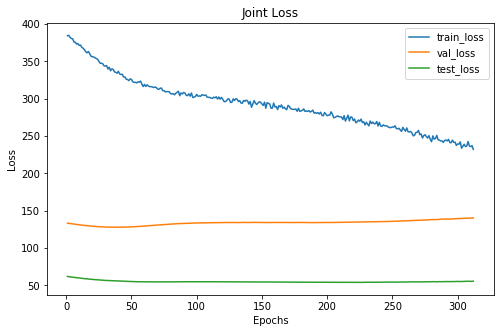

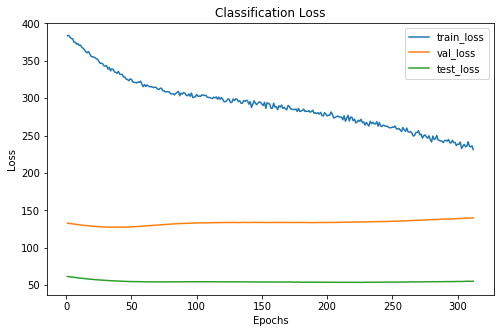

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      137     44      23
 1      153     48      25
 2       66     28       8
xxxxxxxxxxxxxx epoch: 12 xxxxxxxxxxxxxx


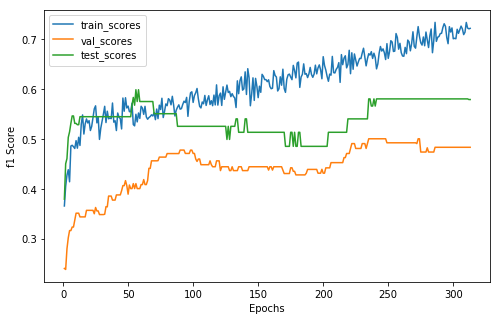

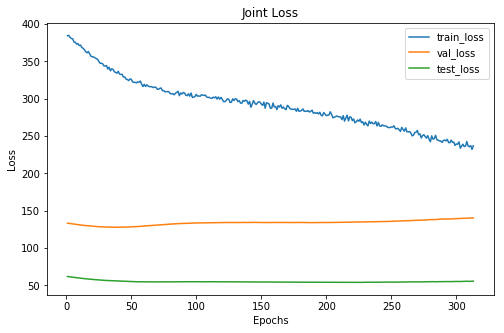

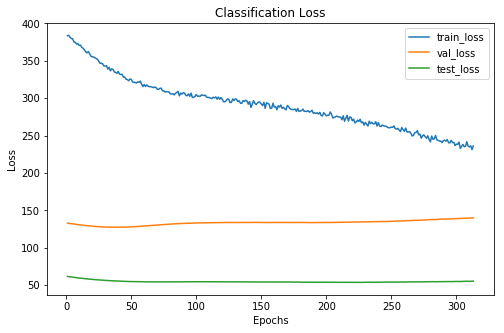

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      144     44      23
 1      154     48      25
 2       58     28       8
xxxxxxxxxxxxxx epoch: 13 xxxxxxxxxxxxxx


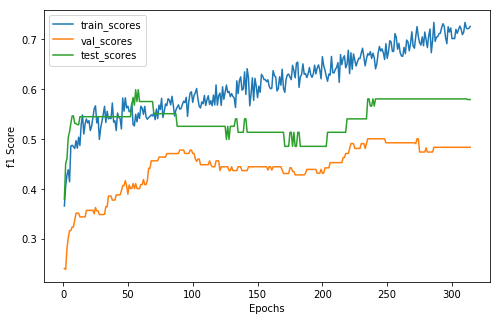

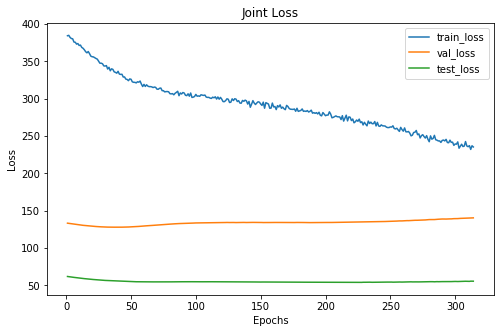

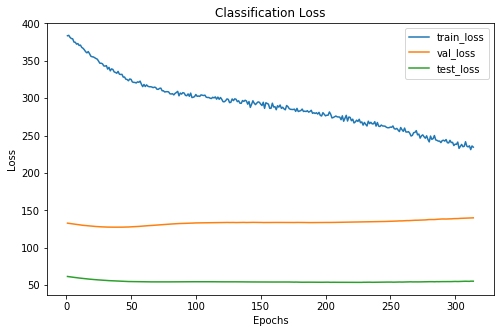

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      144     44      23
 1      150     48      25
 2       62     28       8
xxxxxxxxxxxxxx epoch: 14 xxxxxxxxxxxxxx


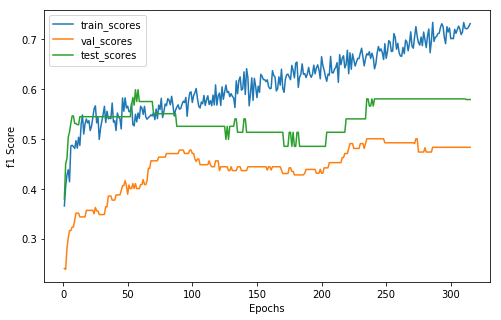

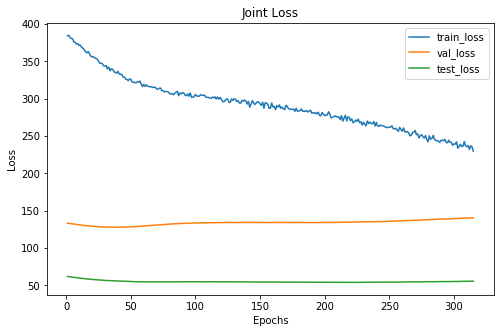

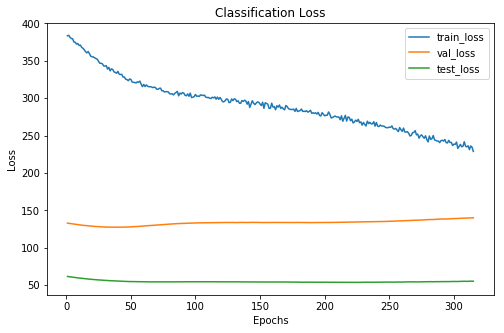

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      149     44      23
 1      153     48      25
 2       54     28       8
xxxxxxxxxxxxxx epoch: 15 xxxxxxxxxxxxxx


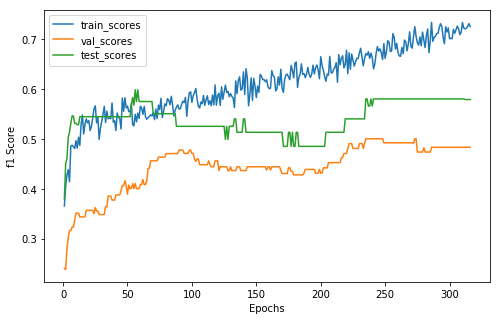

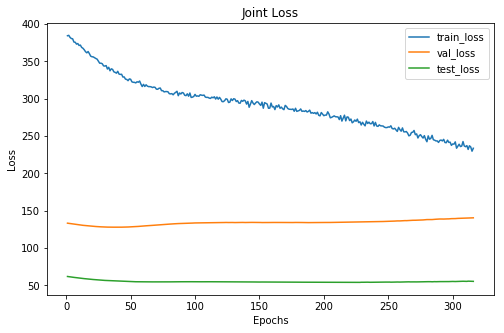

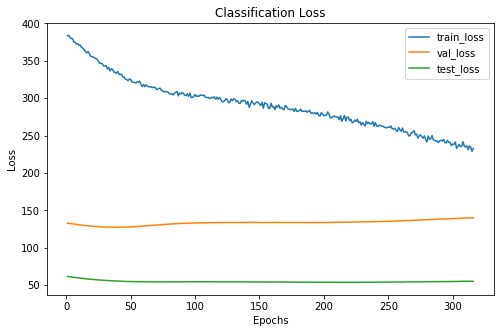

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      146     44      23
 1      152     48      25
 2       58     28       8
xxxxxxxxxxxxxx epoch: 16 xxxxxxxxxxxxxx


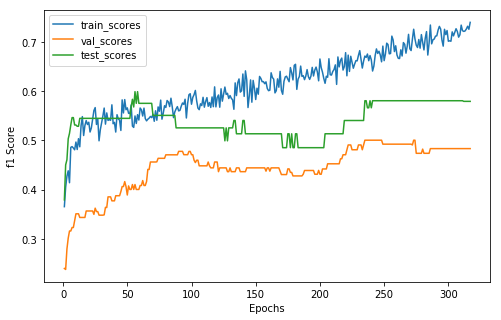

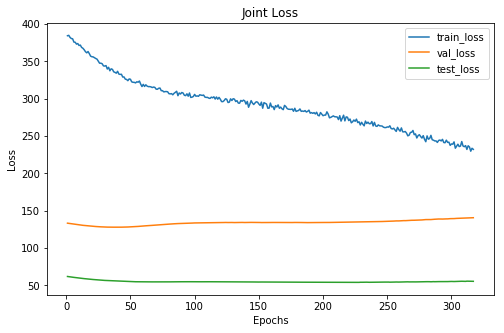

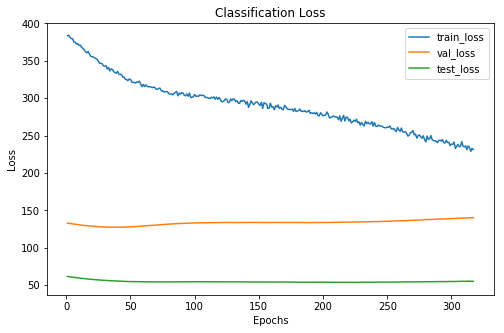

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      147     44      23
 1      151     48      25
 2       58     28       8
xxxxxxxxxxxxxx epoch: 17 xxxxxxxxxxxxxx


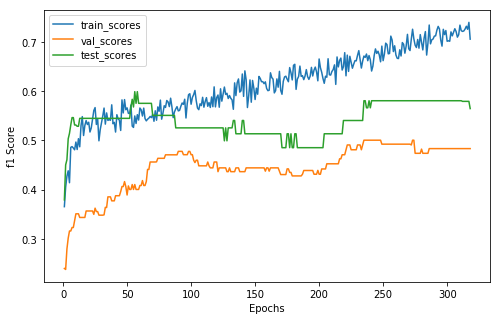

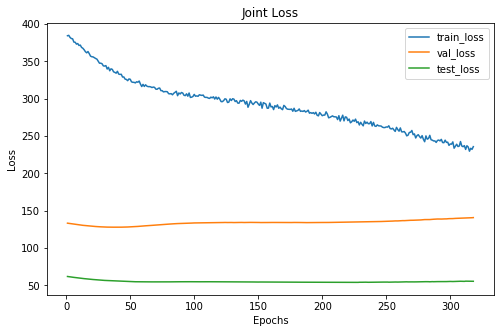

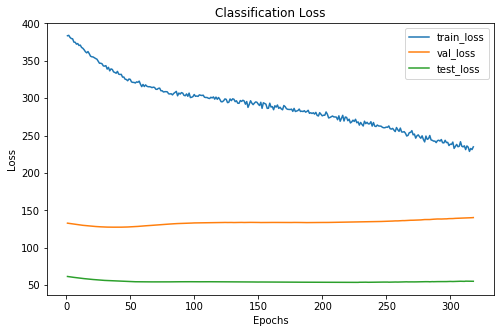

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      147     44      22
 1      150     48      25
 2       59     28       9
xxxxxxxxxxxxxx epoch: 18 xxxxxxxxxxxxxx


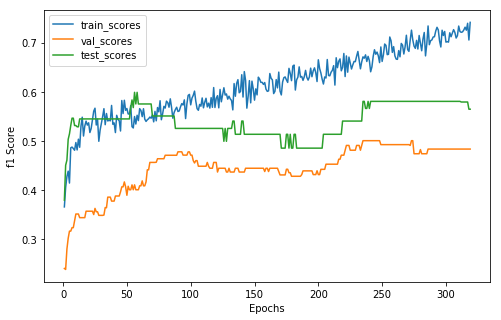

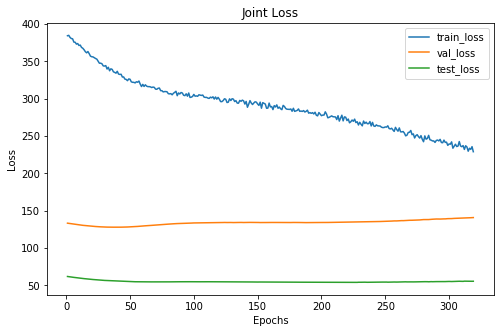

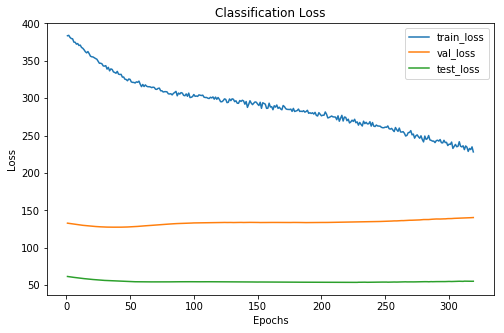

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     44      22
 1      151     48      25
 2       65     28       9
xxxxxxxxxxxxxx epoch: 19 xxxxxxxxxxxxxx


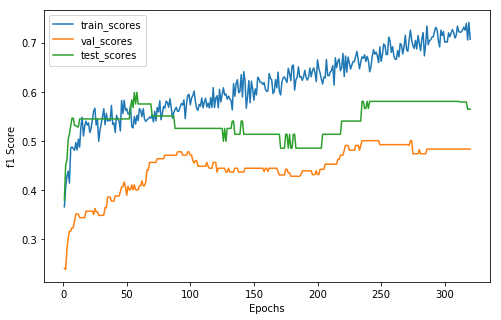

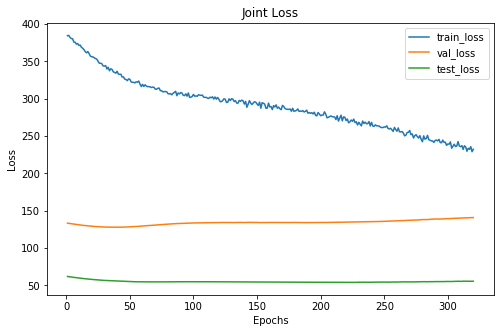

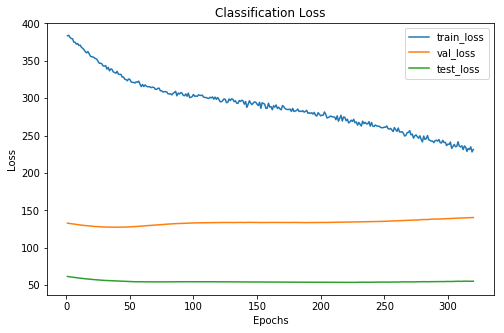

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      139     44      22
 1      150     48      25
 2       67     28       9
xxxxxxxxxxxxxx epoch: 20 xxxxxxxxxxxxxx


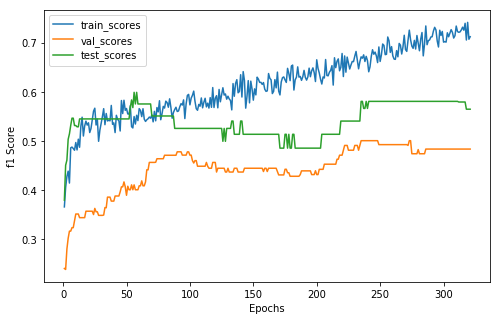

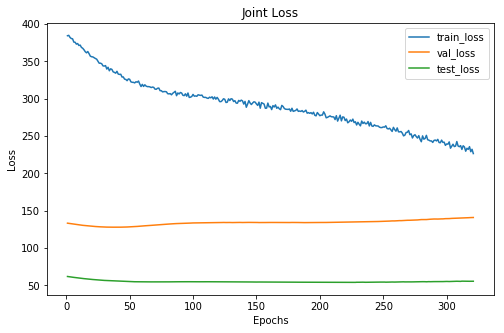

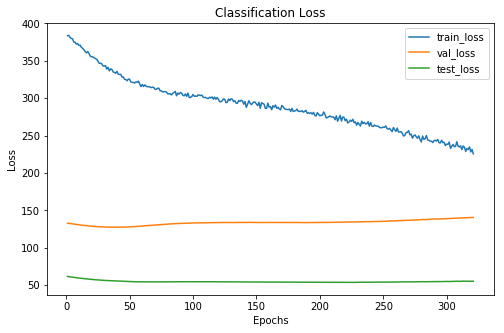

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     44      22
 1      150     48      25
 2       63     28       9
xxxxxxxxxxxxxx epoch: 21 xxxxxxxxxxxxxx


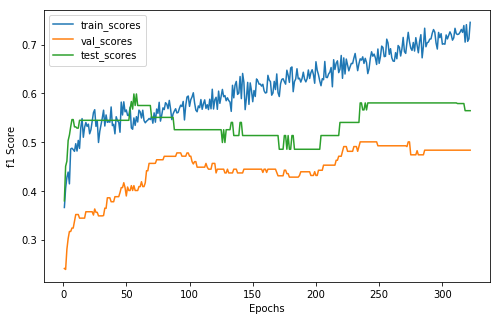

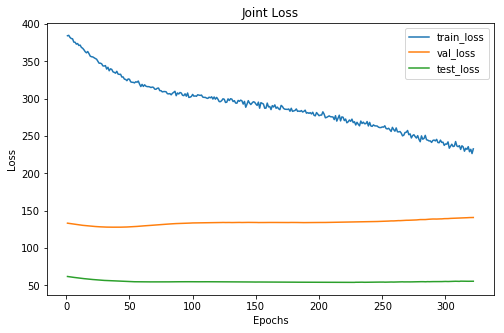

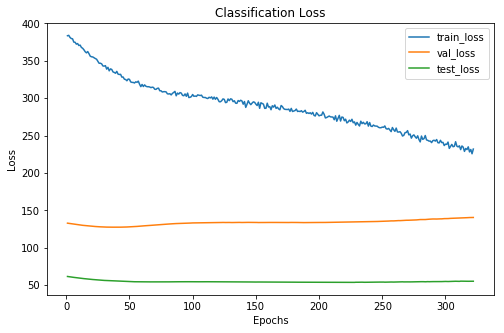

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     44      22
 1      148     48      25
 2       65     28       9
xxxxxxxxxxxxxx epoch: 22 xxxxxxxxxxxxxx


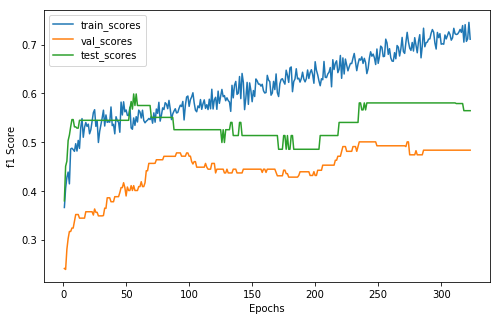

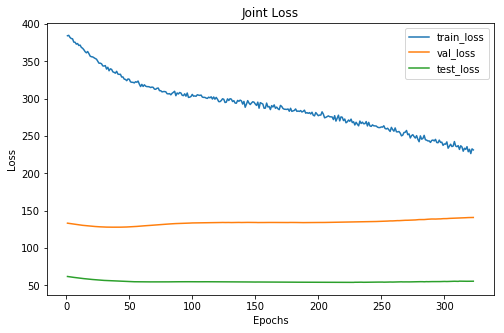

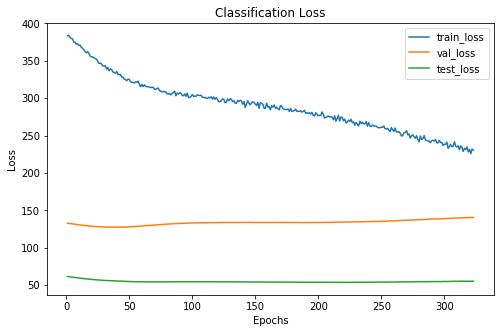

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      145     44      22
 1      150     48      25
 2       61     28       9
xxxxxxxxxxxxxx epoch: 23 xxxxxxxxxxxxxx


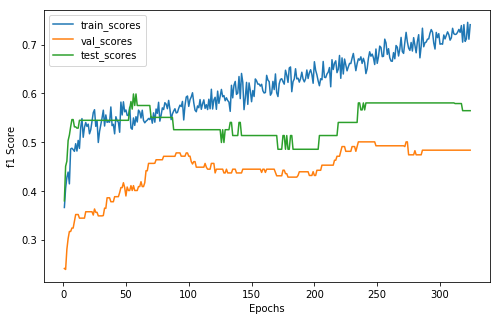

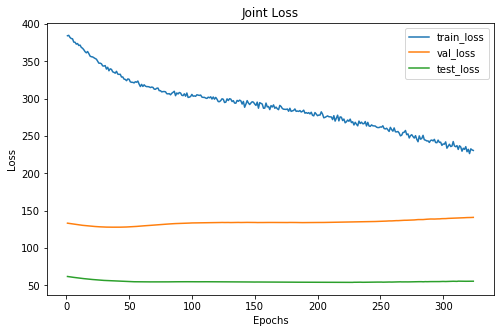

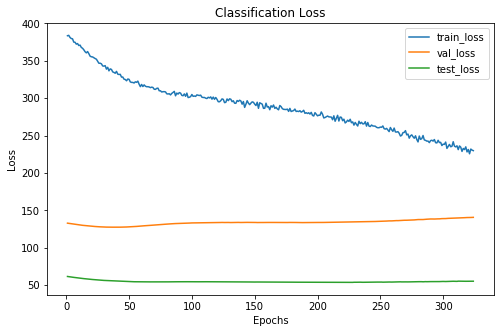

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      132     44      22
 1      155     48      25
 2       69     28       9
xxxxxxxxxxxxxx epoch: 24 xxxxxxxxxxxxxx


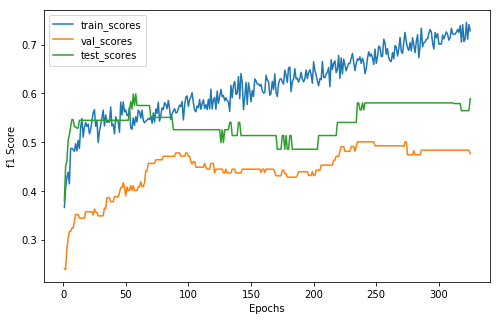

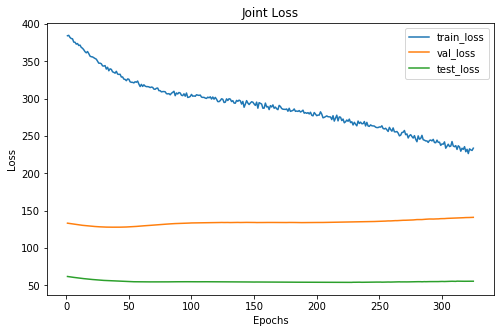

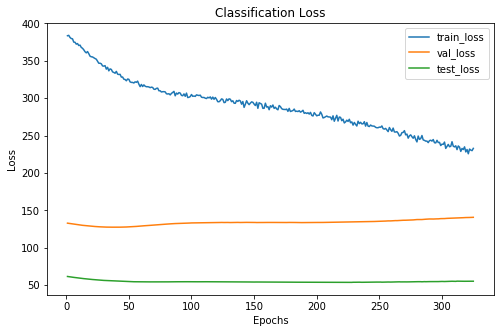

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     43      22
 1      149     49      24
 2       64     28      10
xxxxxxxxxxxxxx epoch: 25 xxxxxxxxxxxxxx


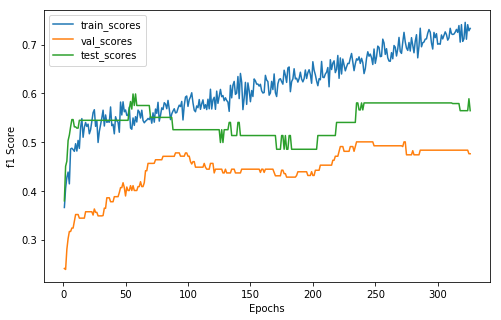

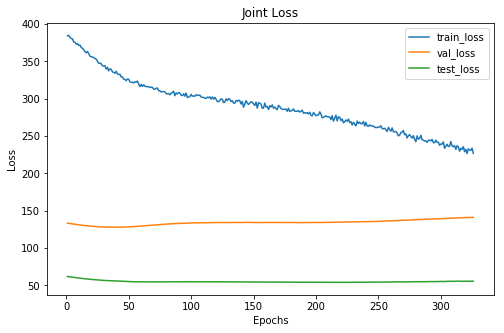

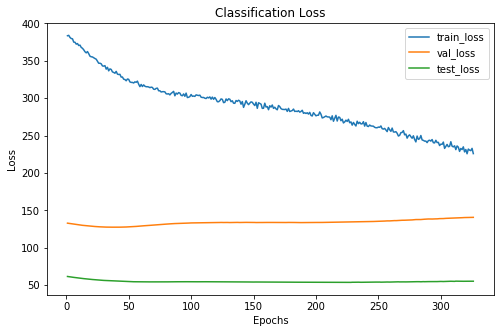

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
17  22   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      144     43      22
 1      153     49      25
 2       59     28       9
xxxxxxxxxxxxxx epoch: 26 xxxxxxxxxxxxxx


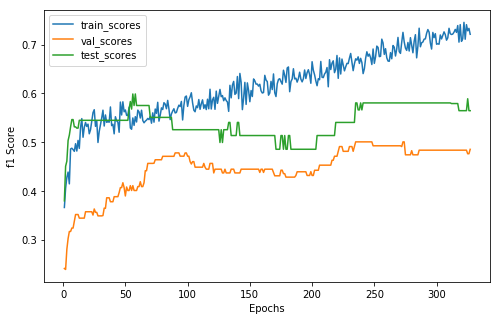

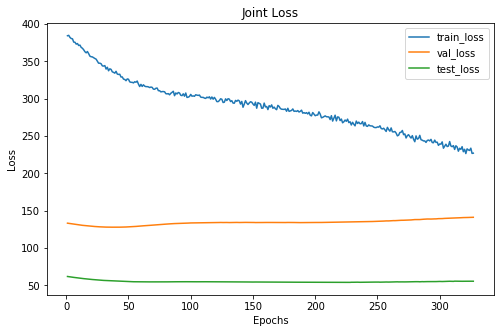

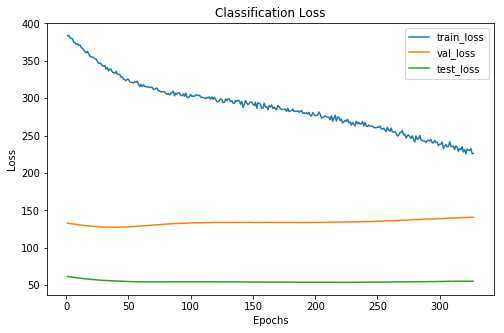

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
17  22   7
 7  16  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      141     42      22
 1      159     49      25
 2       56     29       9
xxxxxxxxxxxxxx epoch: 27 xxxxxxxxxxxxxx


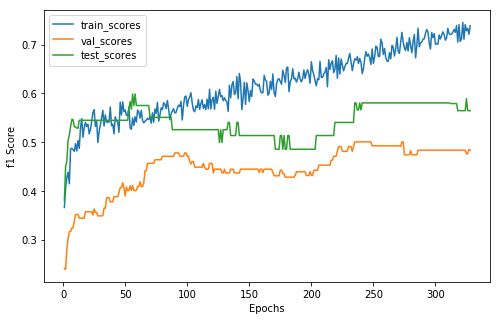

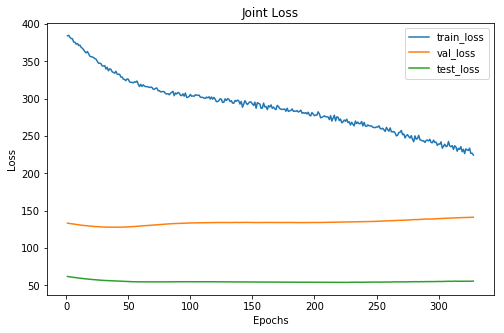

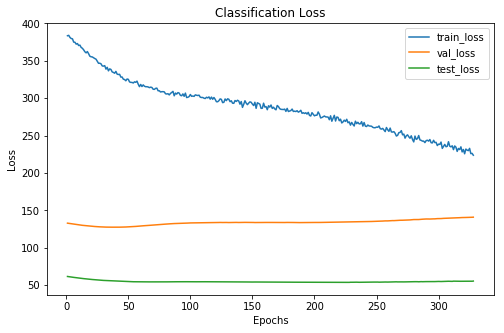

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
17  22   7
 7  17  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      141     43      22
 1      154     49      25
 2       61     28       9
xxxxxxxxxxxxxx epoch: 28 xxxxxxxxxxxxxx


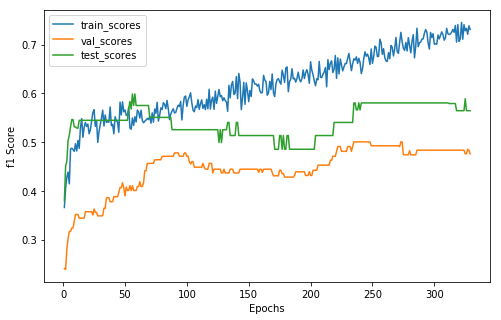

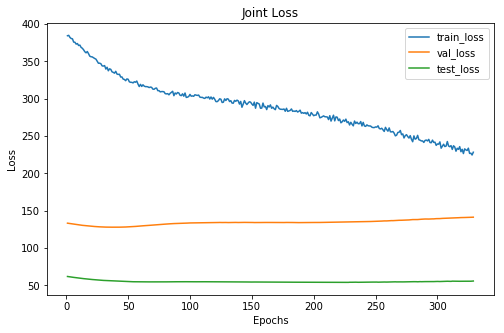

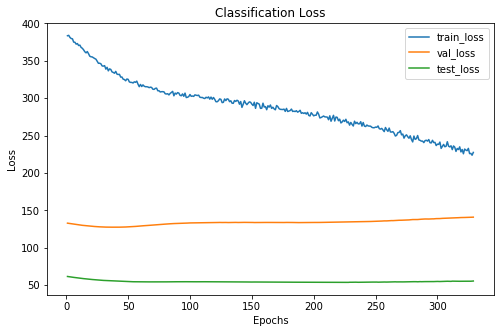

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
17  22   7
 7  17  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      147     42      22
 1      147     50      25
 2       62     28       9
xxxxxxxxxxxxxx epoch: 29 xxxxxxxxxxxxxx


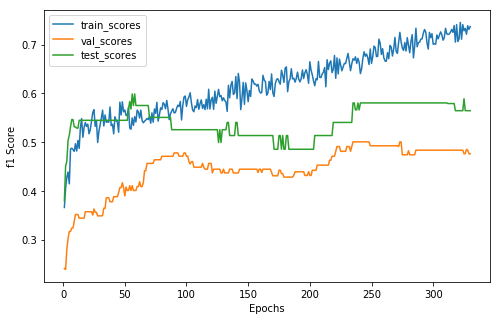

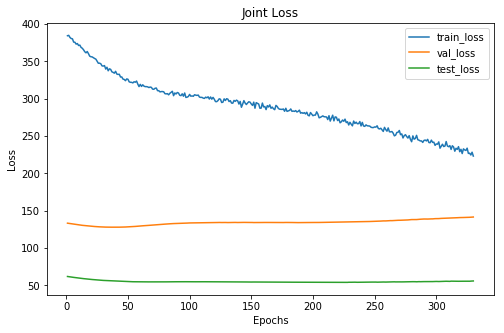

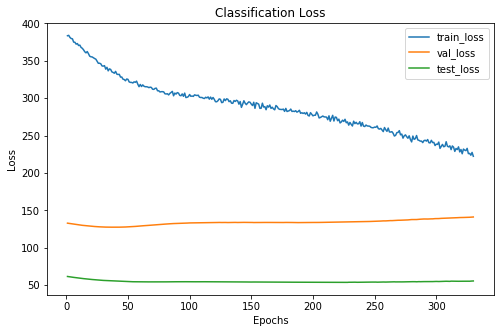

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
17  22   7
 7  17  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      139     42      22
 1      155     50      25
 2       62     28       9
xxxxxxxxxxxxxx epoch: 30 xxxxxxxxxxxxxx


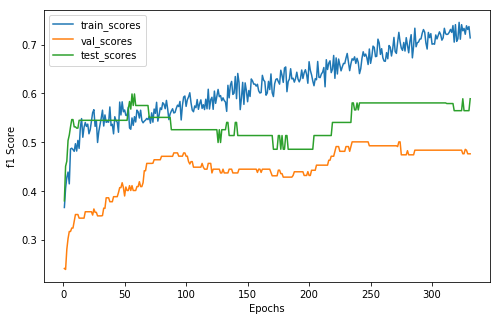

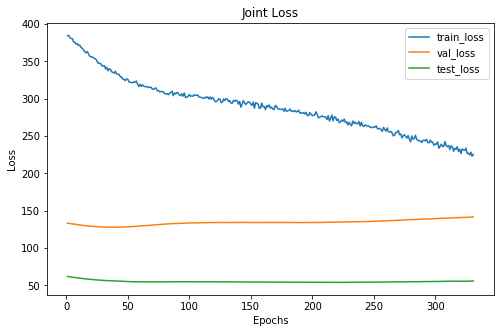

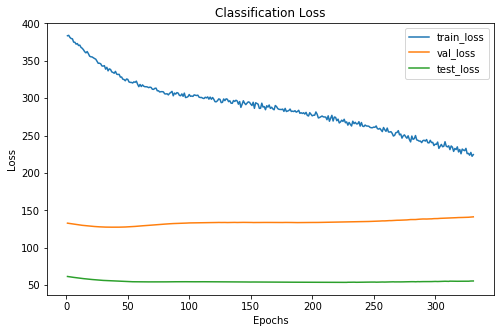

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
17  22   7
 7  17  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      141     42      22
 1      152     50      24
 2       63     28      10
xxxxxxxxxxxxxx epoch: 31 xxxxxxxxxxxxxx


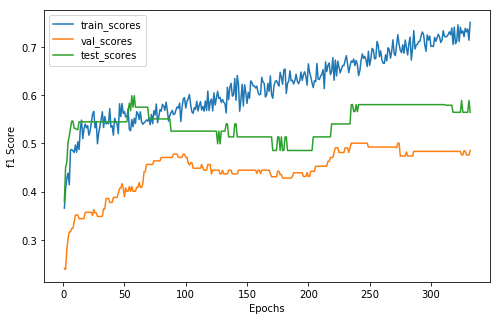

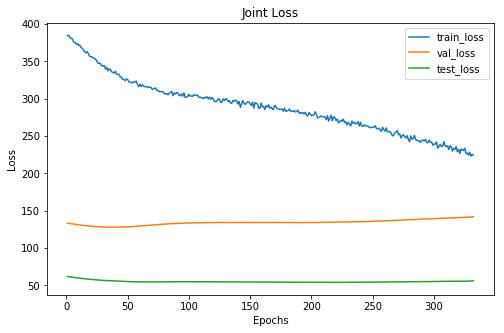

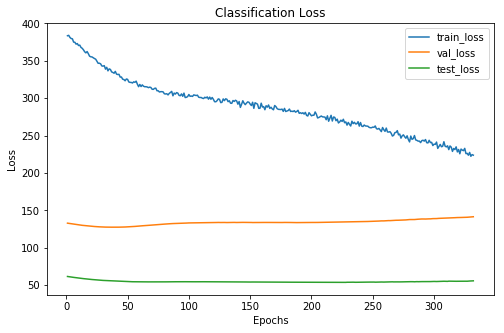

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
17  22   7
 7  16  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     42      22
 1      152     49      25
 2       61     29       9
xxxxxxxxxxxxxx epoch: 32 xxxxxxxxxxxxxx


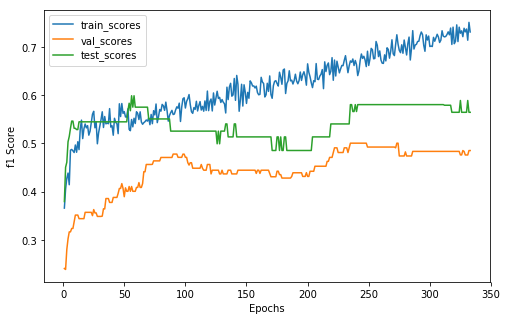

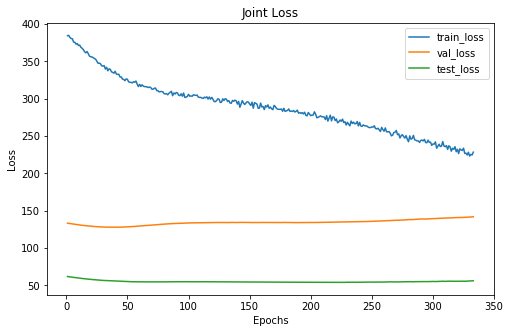

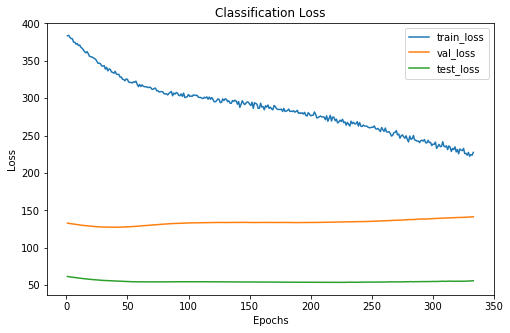

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
17  22   7
 7  16  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      146     42      22
 1      147     49      25
 2       63     29       9
xxxxxxxxxxxxxx epoch: 33 xxxxxxxxxxxxxx


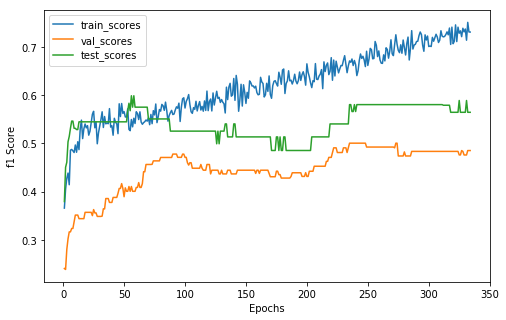

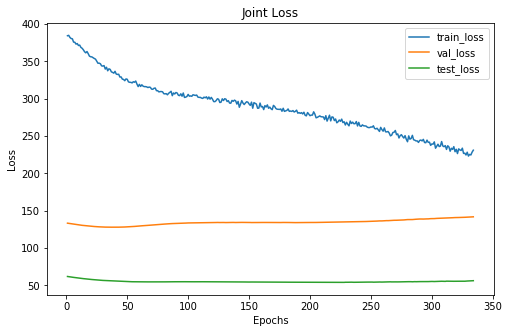

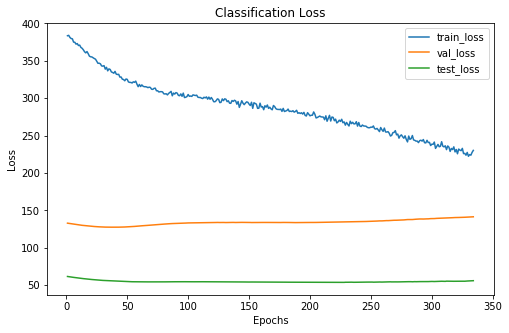

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
17  22   7
 7  16  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      149     42      22
 1      149     49      25
 2       58     29       9
xxxxxxxxxxxxxx epoch: 34 xxxxxxxxxxxxxx


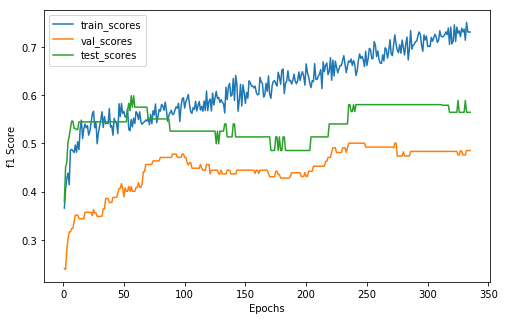

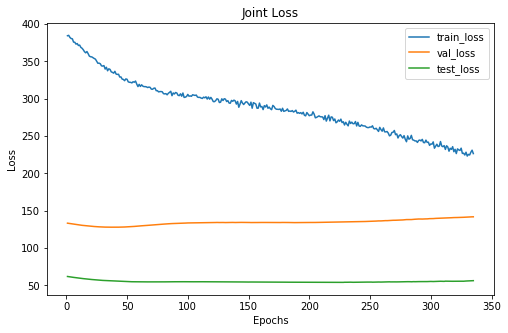

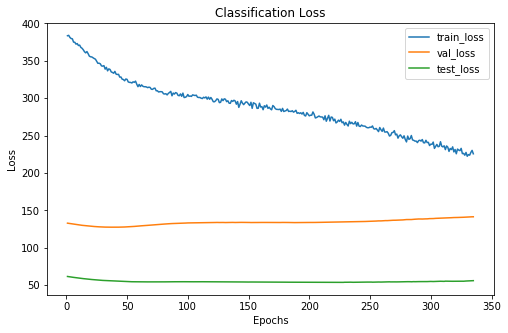

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
17  22   7
 7  16  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      149     42      22
 1      145     49      25
 2       62     29       9
xxxxxxxxxxxxxx epoch: 35 xxxxxxxxxxxxxx


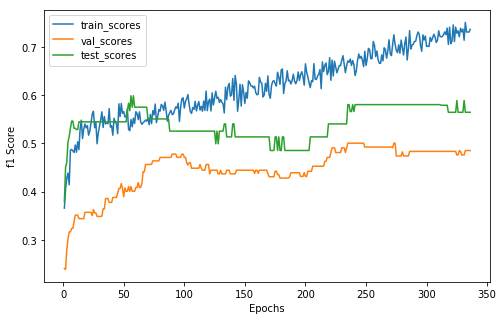

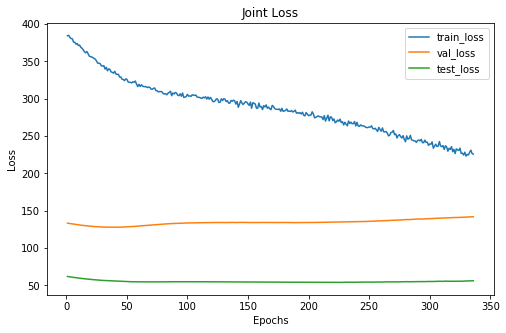

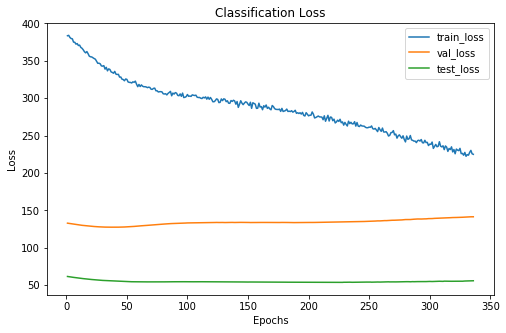

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
17  22   7
 7  16  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      139     42      22
 1      157     49      25
 2       60     29       9
xxxxxxxxxxxxxx epoch: 36 xxxxxxxxxxxxxx


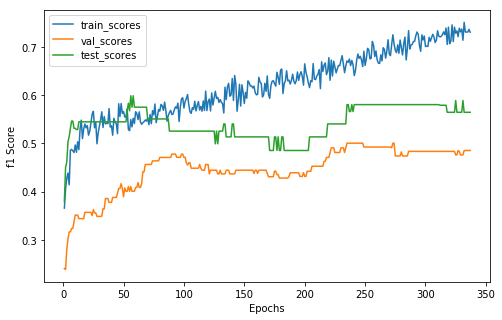

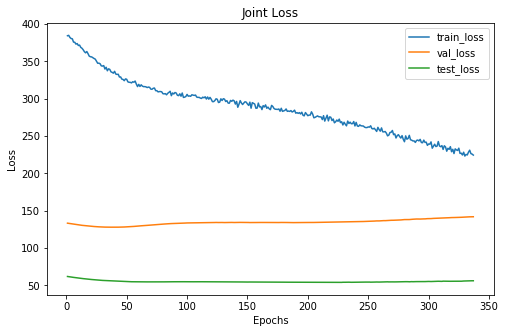

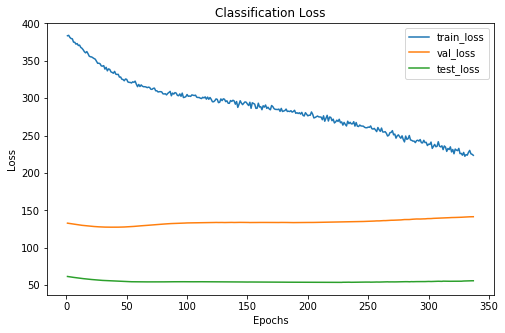

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
17  22   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      147     43      22
 1      149     48      25
 2       60     29       9
xxxxxxxxxxxxxx epoch: 37 xxxxxxxxxxxxxx


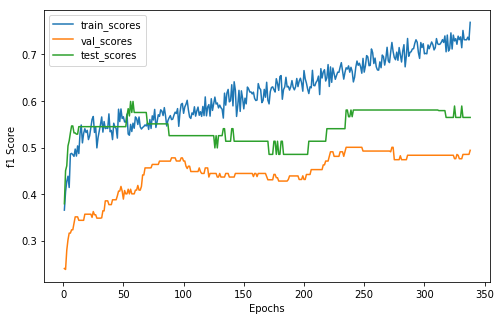

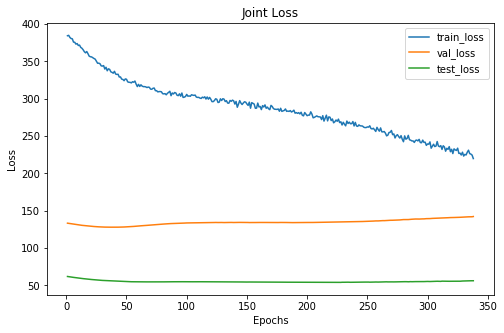

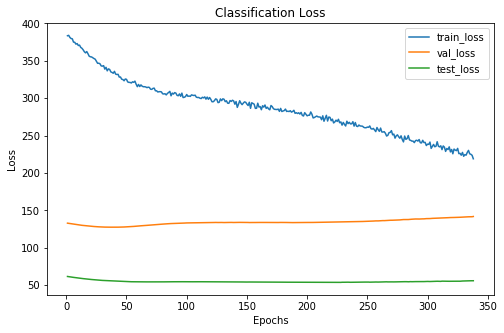

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
17  23   6
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     43      22
 1      150     49      25
 2       63     28       9
xxxxxxxxxxxxxx epoch: 38 xxxxxxxxxxxxxx


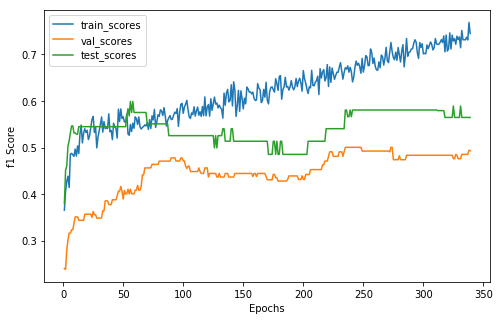

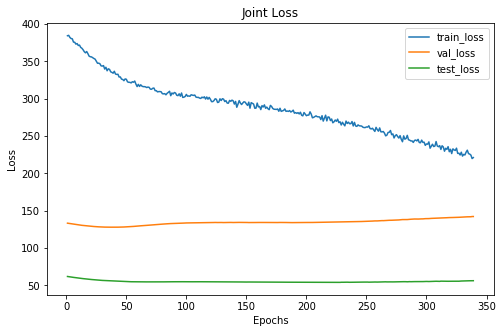

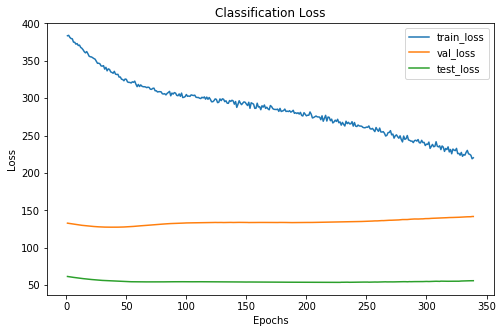

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  23   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      145     42      22
 1      153     49      25
 2       58     29       9
xxxxxxxxxxxxxx epoch: 39 xxxxxxxxxxxxxx


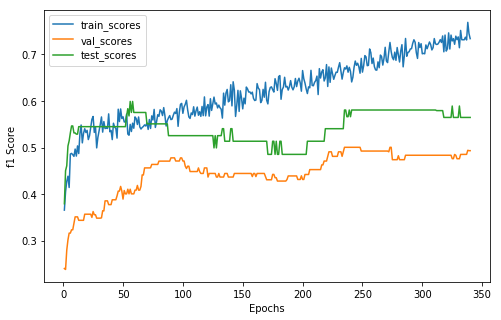

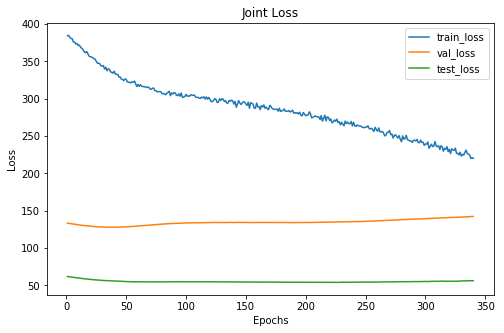

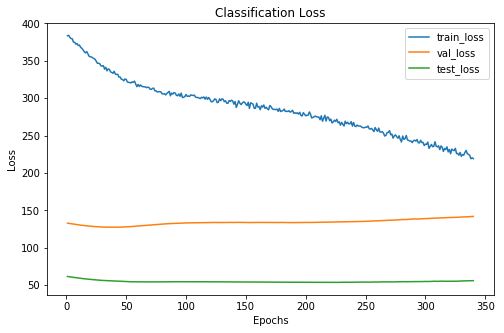

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  23   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      145     42      22
 1      151     49      25
 2       60     29       9
xxxxxxxxxxxxxx epoch: 40 xxxxxxxxxxxxxx


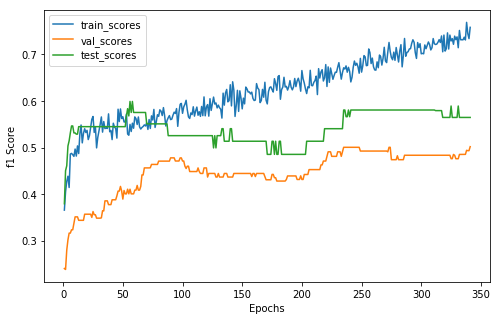

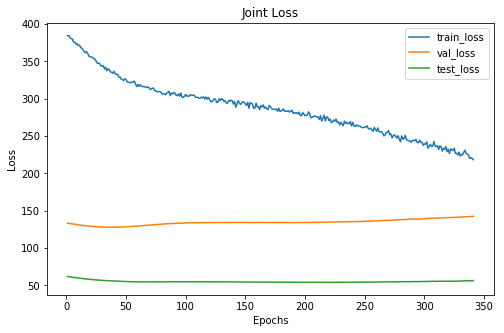

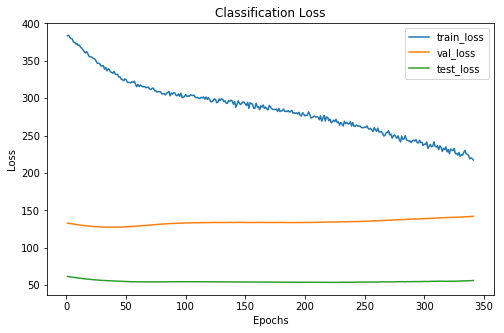

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  24   6
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     42      22
 1      148     50      25
 2       68     28       9
xxxxxxxxxxxxxx epoch: 41 xxxxxxxxxxxxxx


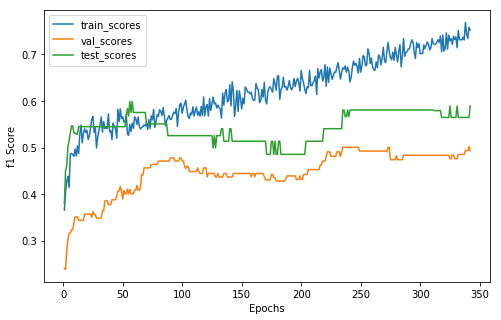

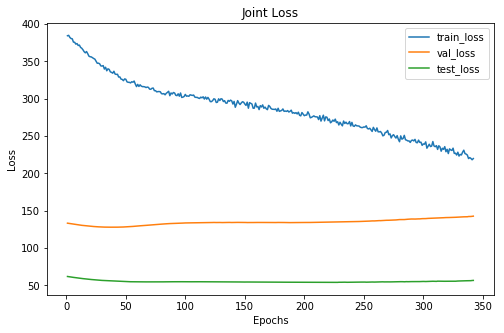

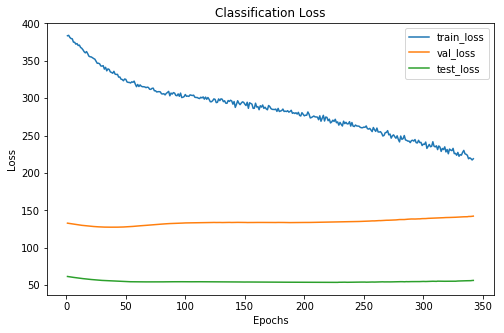

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  23   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      136     42      22
 1      151     49      24
 2       69     29      10
xxxxxxxxxxxxxx epoch: 42 xxxxxxxxxxxxxx


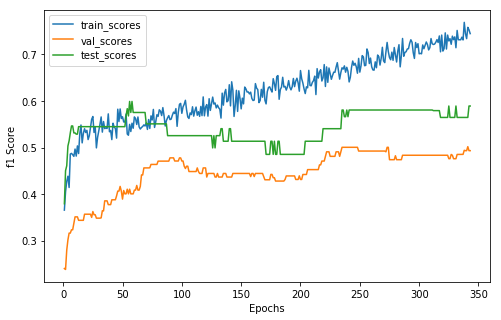

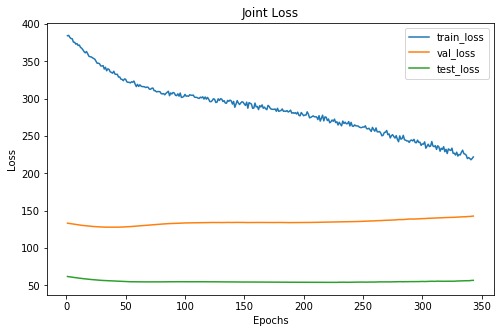

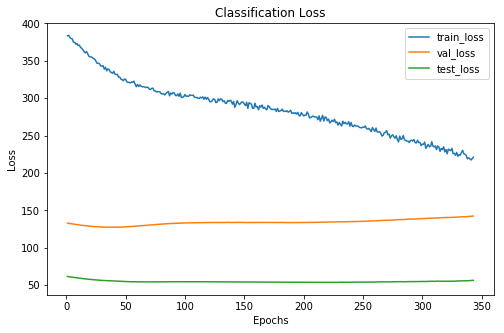

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  23   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      149     42      22
 1      150     49      24
 2       57     29      10
xxxxxxxxxxxxxx epoch: 43 xxxxxxxxxxxxxx


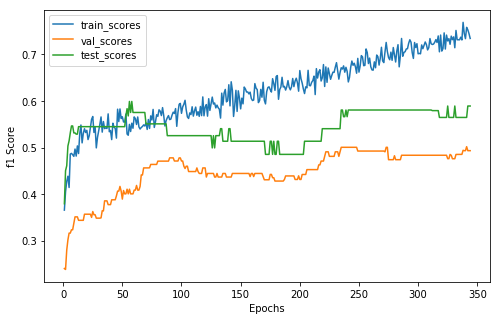

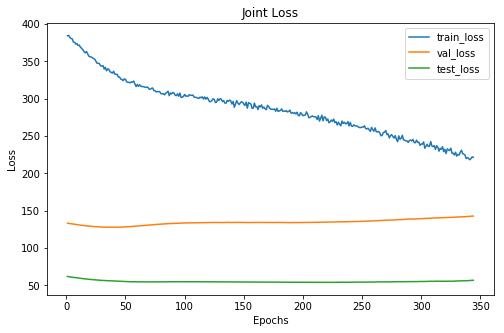

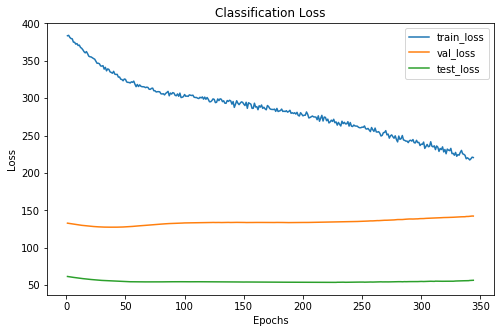

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  23   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      148     42      22
 1      145     49      24
 2       63     29      10
xxxxxxxxxxxxxx epoch: 44 xxxxxxxxxxxxxx


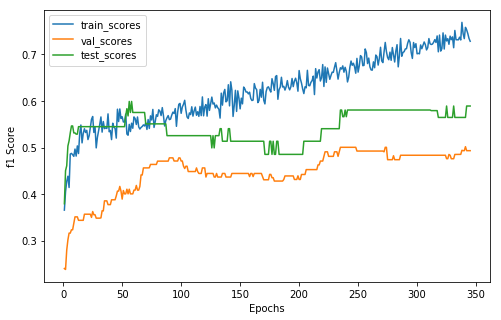

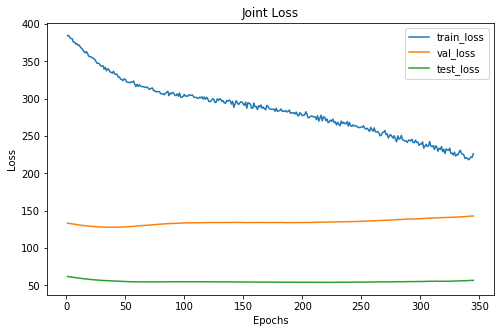

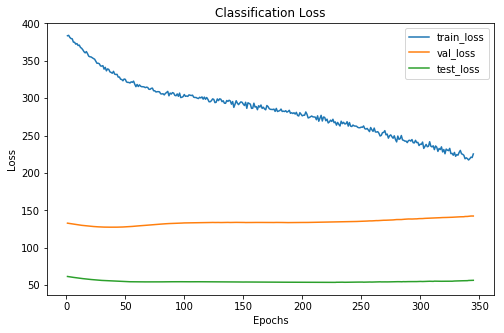

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  23   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      149     42      22
 1      144     49      24
 2       63     29      10
xxxxxxxxxxxxxx epoch: 45 xxxxxxxxxxxxxx


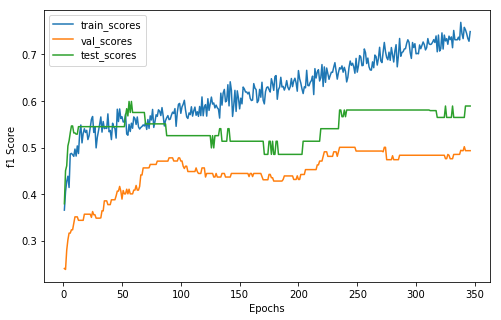

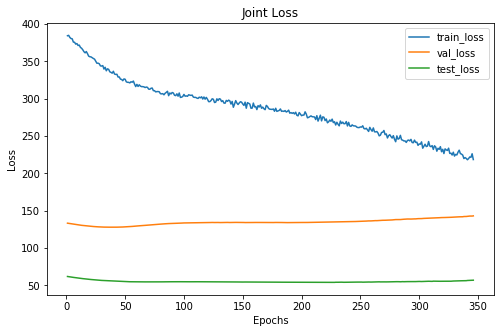

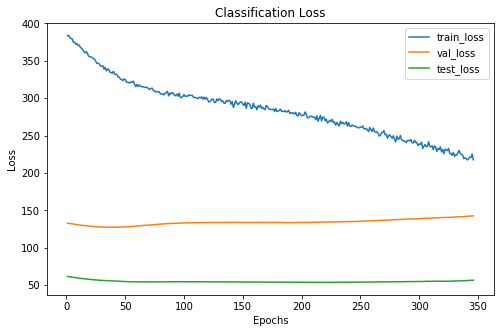

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  23   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      142     42      22
 1      150     49      24
 2       64     29      10
xxxxxxxxxxxxxx epoch: 46 xxxxxxxxxxxxxx


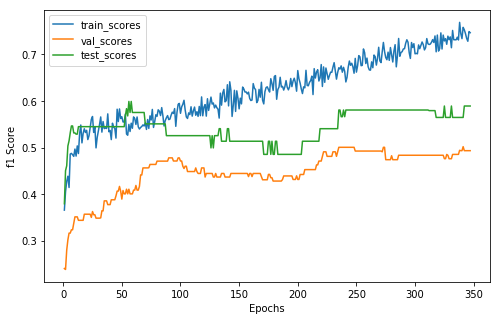

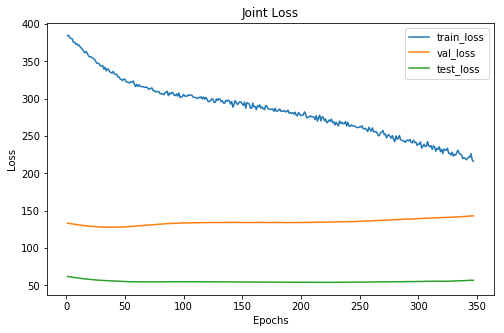

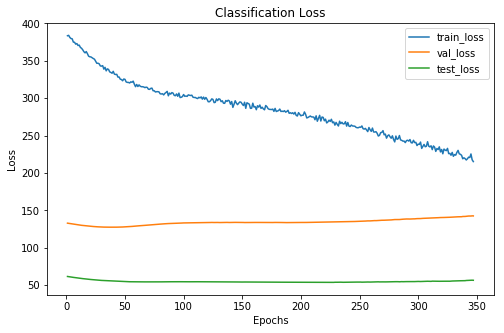

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  23   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      136     42      22
 1      154     49      24
 2       66     29      10
xxxxxxxxxxxxxx epoch: 47 xxxxxxxxxxxxxx


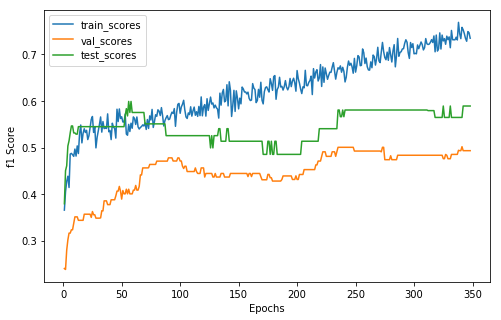

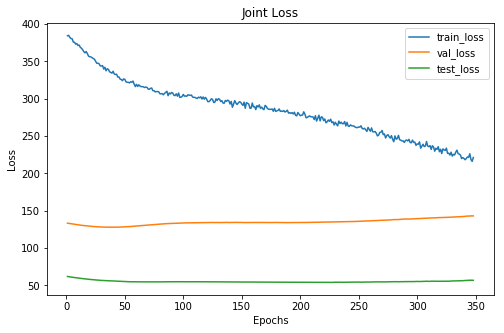

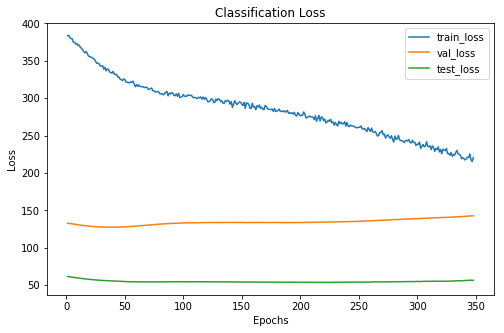

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  23   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      147     42      22
 1      148     49      24
 2       61     29      10
xxxxxxxxxxxxxx epoch: 48 xxxxxxxxxxxxxx


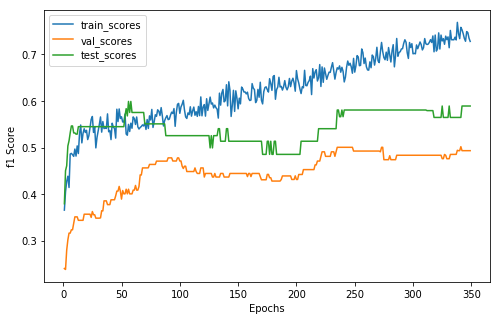

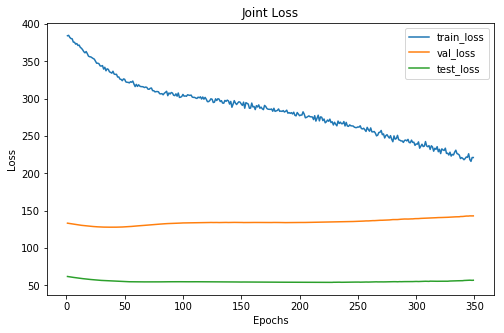

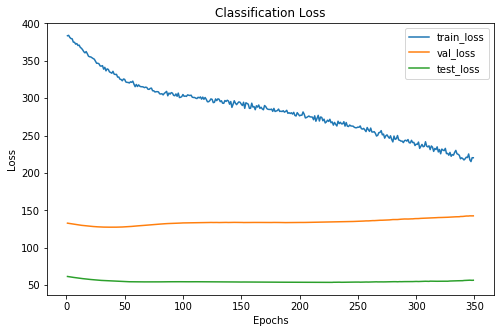

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  23   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      146     42      22
 1      153     49      24
 2       57     29      10
xxxxxxxxxxxxxx epoch: 49 xxxxxxxxxxxxxx


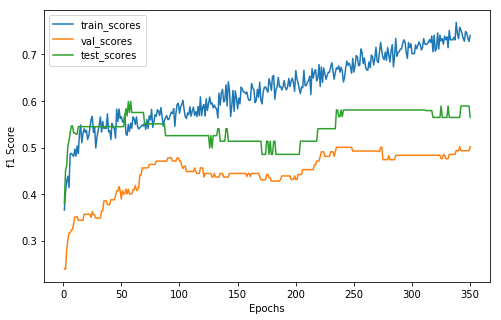

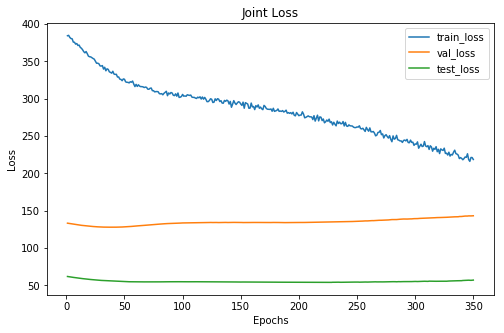

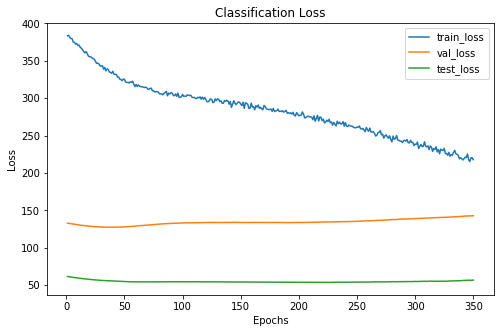

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  24   6
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      136     42      22
 1      153     50      25
 2       67     28       9
xxxxxxxxxxxxxx epoch: 50 xxxxxxxxxxxxxx


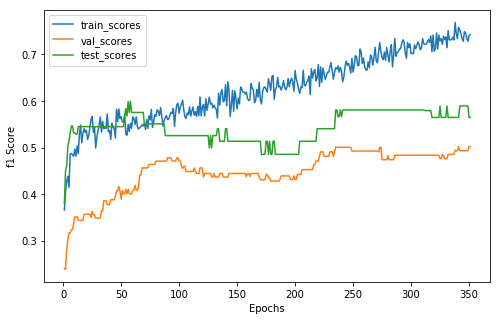

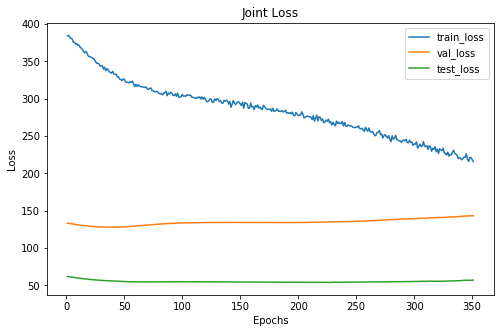

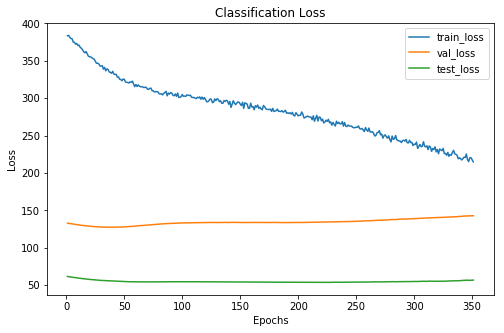

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  24   6
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      141     42      22
 1      152     50      25
 2       63     28       9
xxxxxxxxxxxxxx epoch: 51 xxxxxxxxxxxxxx


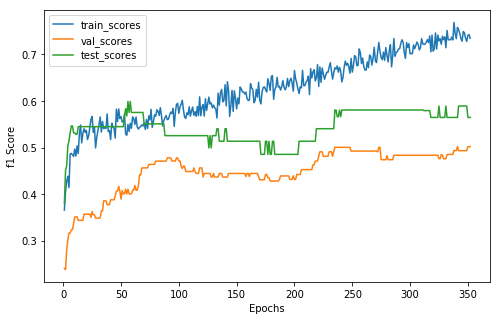

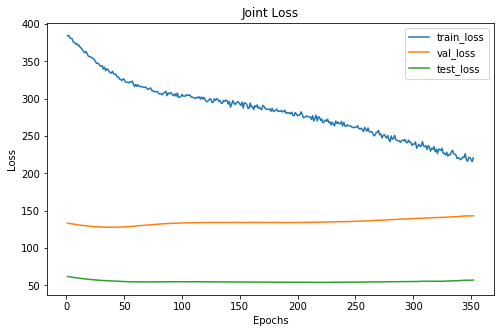

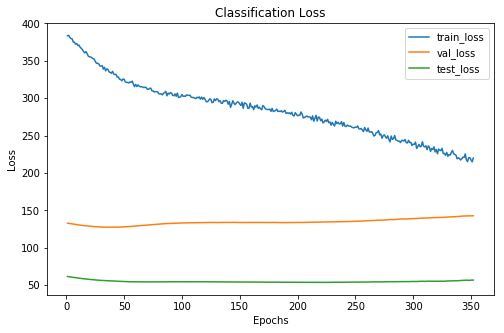

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  24   6
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      145     42      22
 1      151     50      25
 2       60     28       9
xxxxxxxxxxxxxx epoch: 52 xxxxxxxxxxxxxx


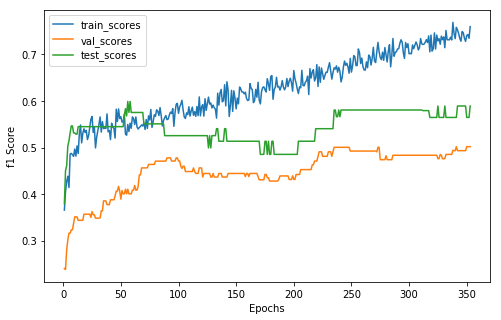

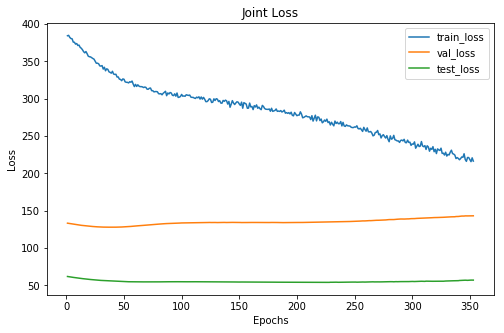

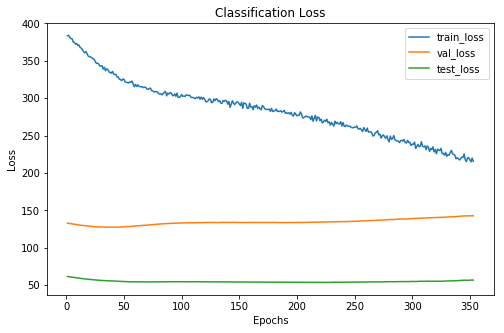

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  24   6
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      145     42      22
 1      152     50      24
 2       59     28      10
xxxxxxxxxxxxxx epoch: 53 xxxxxxxxxxxxxx


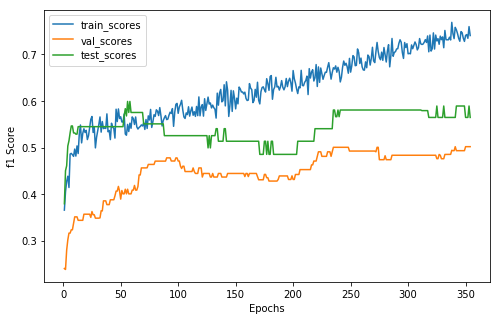

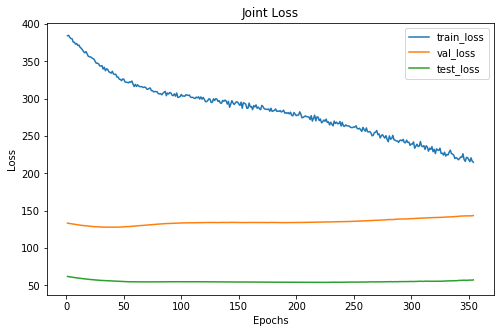

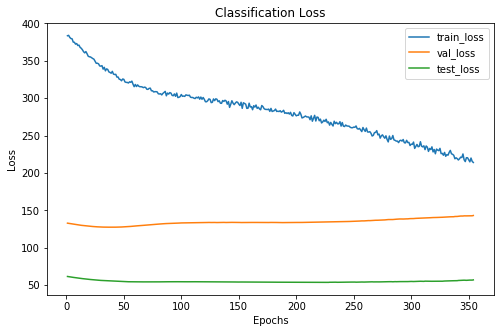

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  24   6
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     42      22
 1      152     50      25
 2       61     28       9
xxxxxxxxxxxxxx epoch: 54 xxxxxxxxxxxxxx


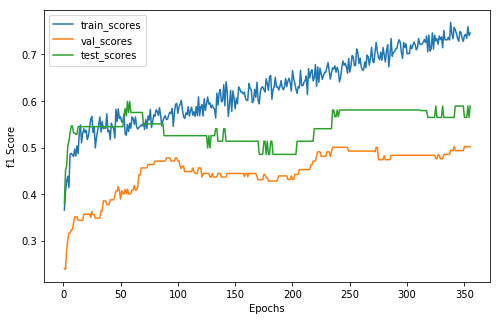

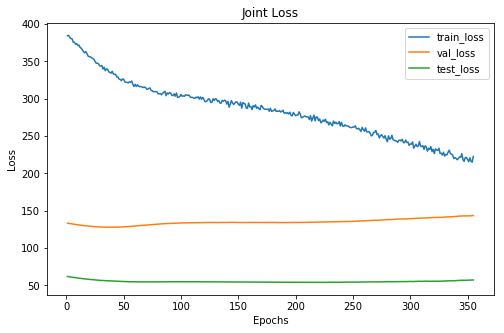

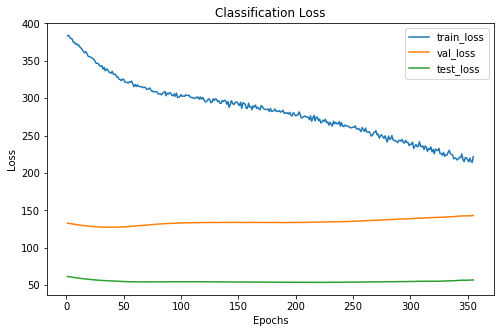

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  24   6
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      147     42      22
 1      144     50      24
 2       65     28      10
xxxxxxxxxxxxxx epoch: 55 xxxxxxxxxxxxxx


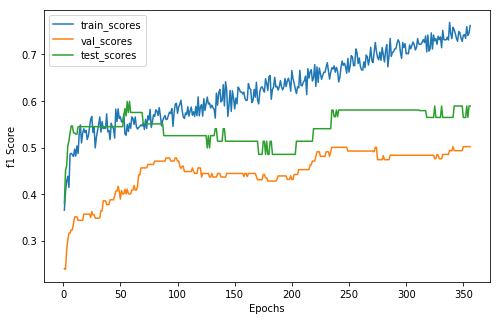

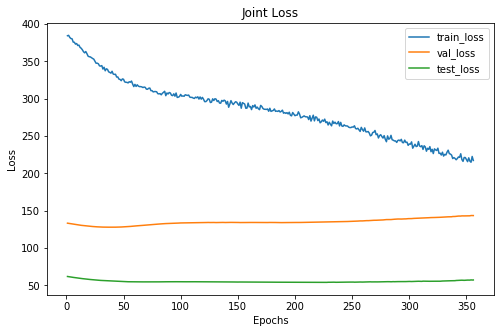

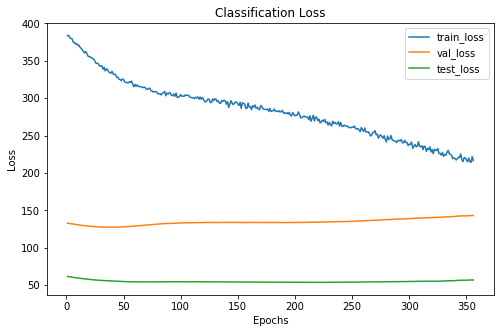

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  24   6
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      145     42      22
 1      152     50      24
 2       59     28      10
xxxxxxxxxxxxxx epoch: 56 xxxxxxxxxxxxxx


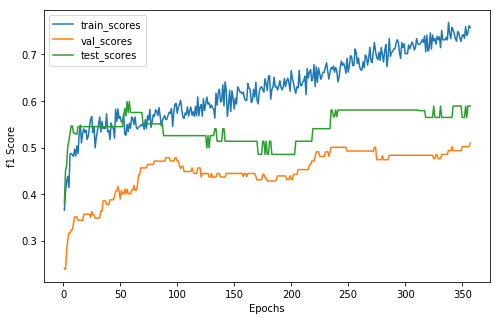

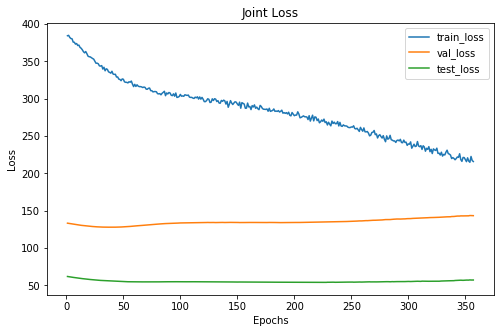

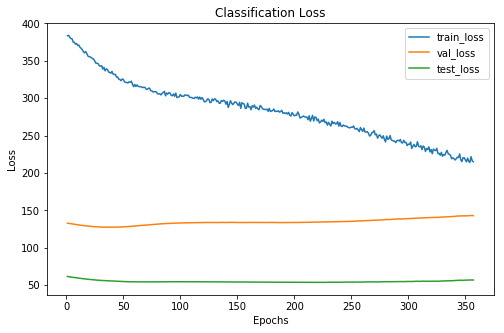

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  25   6
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      142     41      22
 1      146     51      24
 2       68     28      10
xxxxxxxxxxxxxx epoch: 57 xxxxxxxxxxxxxx


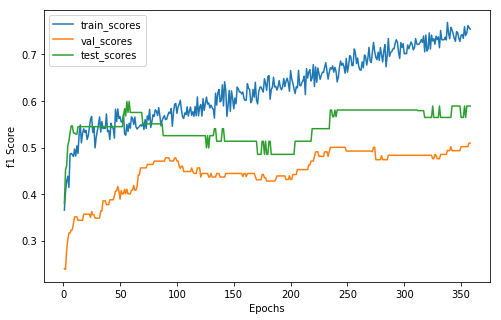

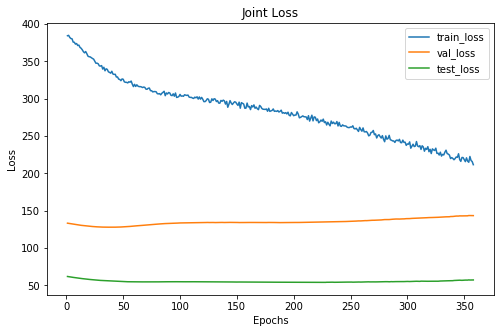

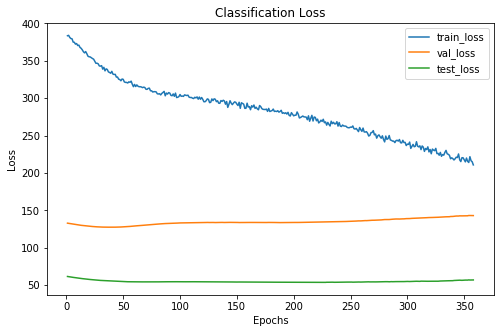

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  25   6
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      141     41      22
 1      150     51      24
 2       65     28      10
xxxxxxxxxxxxxx epoch: 58 xxxxxxxxxxxxxx


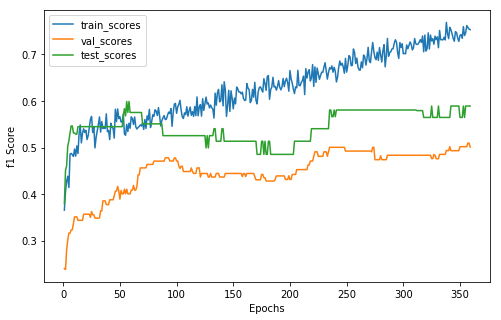

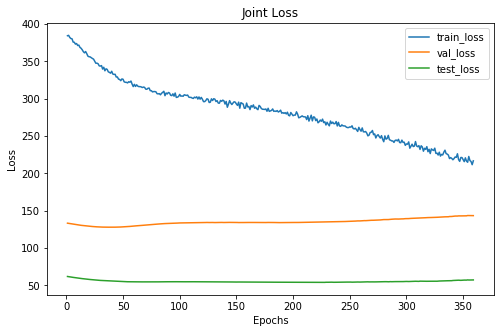

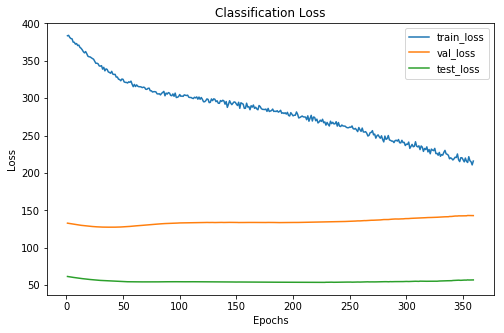

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  24   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      141     41      22
 1      155     50      24
 2       60     29      10
xxxxxxxxxxxxxx epoch: 59 xxxxxxxxxxxxxx


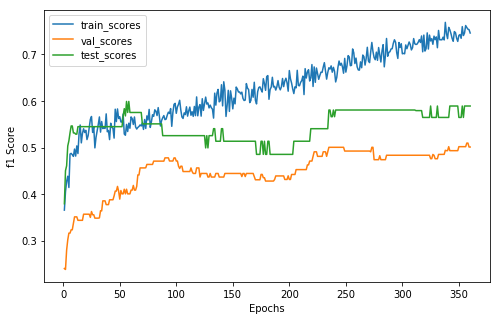

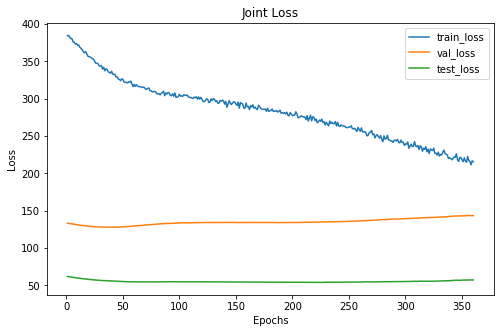

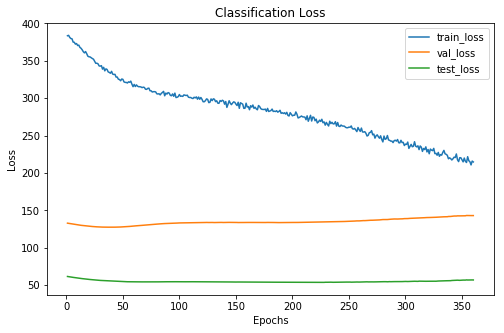

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  24   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      145     41      22
 1      151     50      24
 2       60     29      10
xxxxxxxxxxxxxx epoch: 60 xxxxxxxxxxxxxx


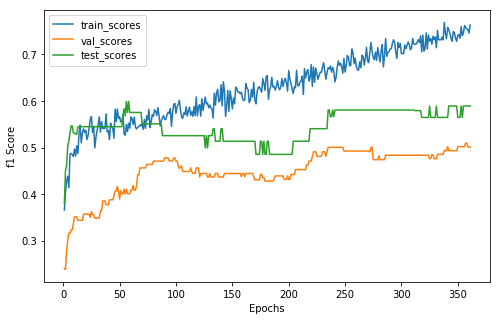

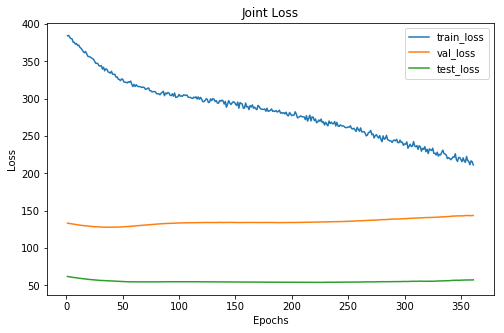

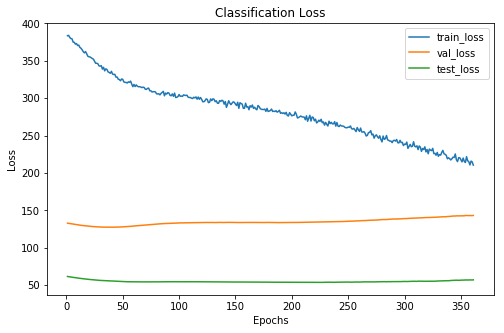

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  24   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      144     41      22
 1      149     50      24
 2       63     29      10
xxxxxxxxxxxxxx epoch: 61 xxxxxxxxxxxxxx


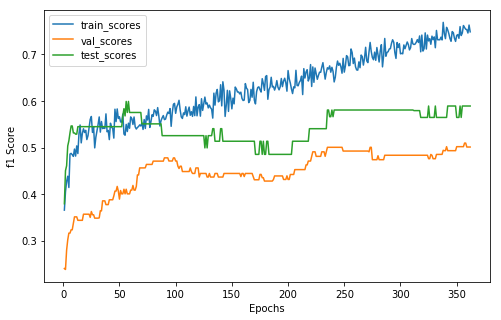

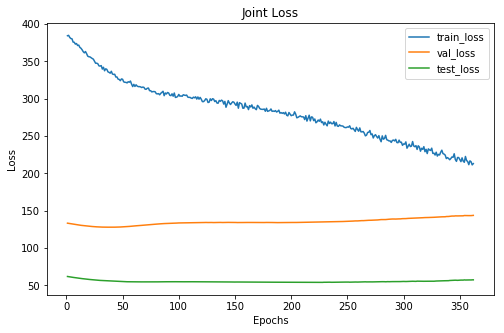

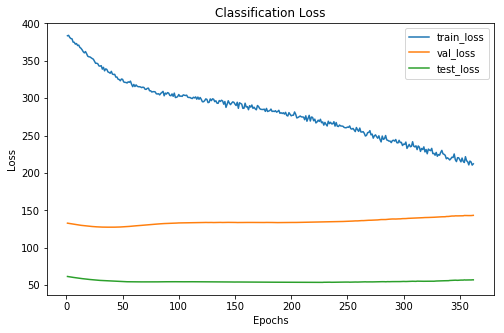

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  24   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      150     41      22
 1      141     50      24
 2       65     29      10
xxxxxxxxxxxxxx epoch: 62 xxxxxxxxxxxxxx


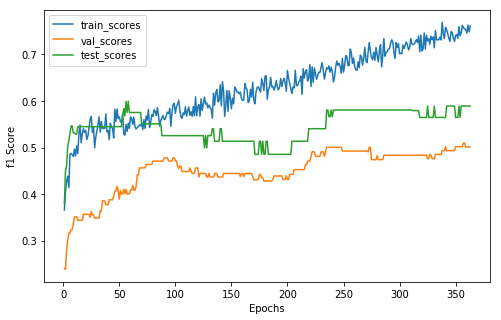

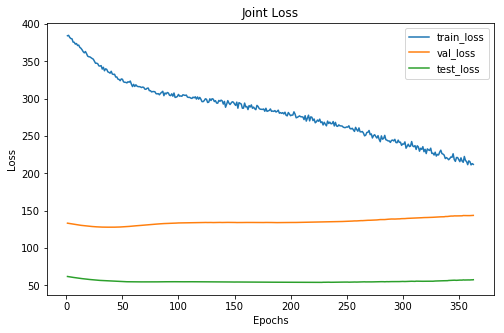

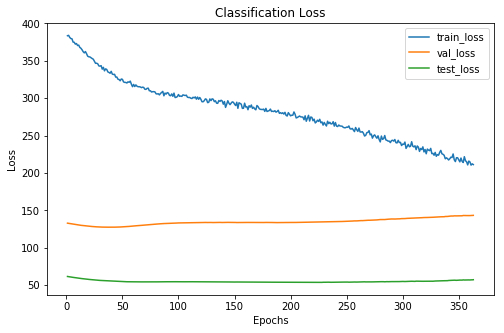

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  24   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     41      22
 1      144     50      24
 2       69     29      10
xxxxxxxxxxxxxx epoch: 63 xxxxxxxxxxxxxx


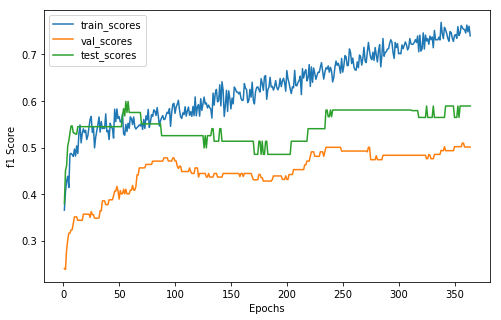

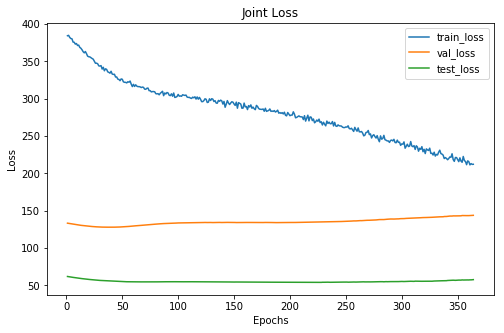

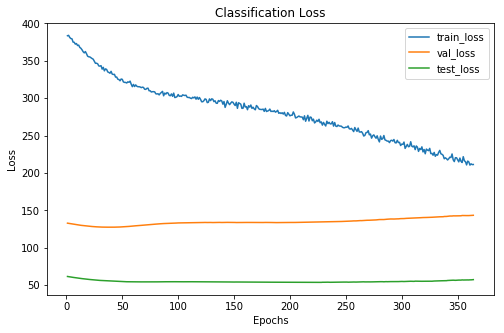

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  24   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      142     41      22
 1      153     50      24
 2       61     29      10
xxxxxxxxxxxxxx epoch: 64 xxxxxxxxxxxxxx


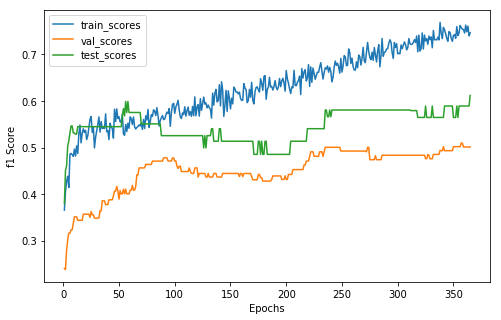

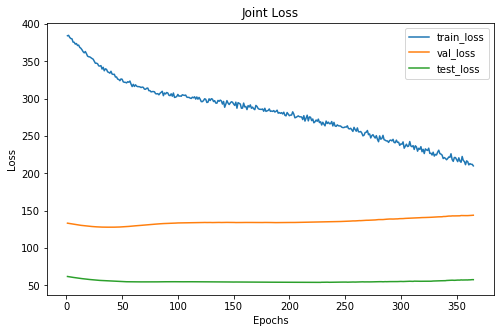

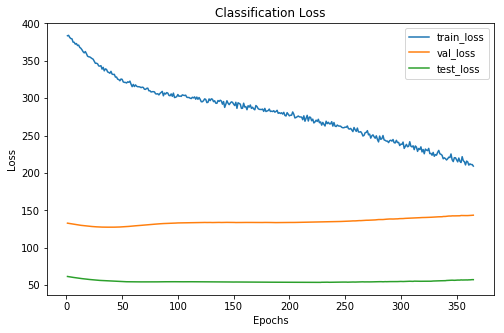

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  24   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      142     41      21
 1      151     50      24
 2       63     29      11
xxxxxxxxxxxxxx epoch: 65 xxxxxxxxxxxxxx


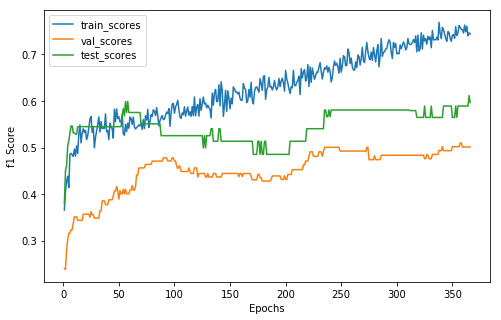

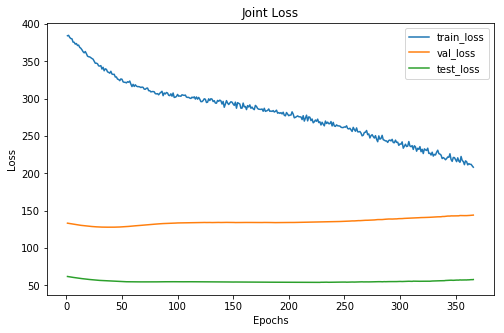

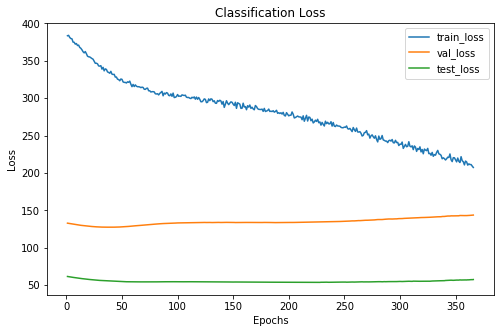

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  24   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     41      22
 1      148     50      23
 2       68     29      11
xxxxxxxxxxxxxx epoch: 66 xxxxxxxxxxxxxx


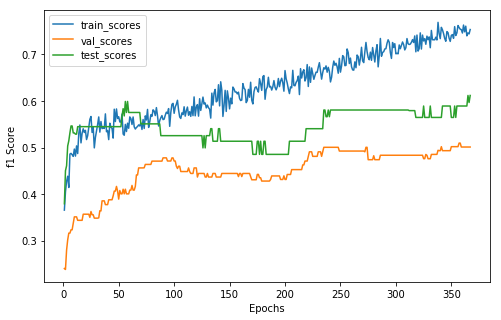

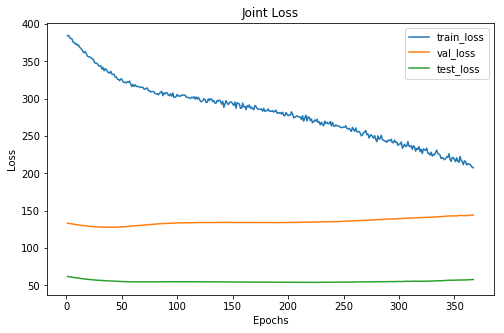

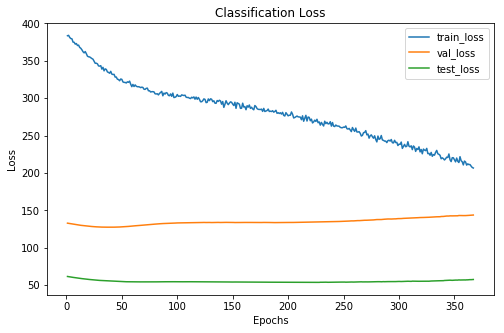

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  24   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      144     41      21
 1      152     50      24
 2       60     29      11
xxxxxxxxxxxxxx epoch: 67 xxxxxxxxxxxxxx


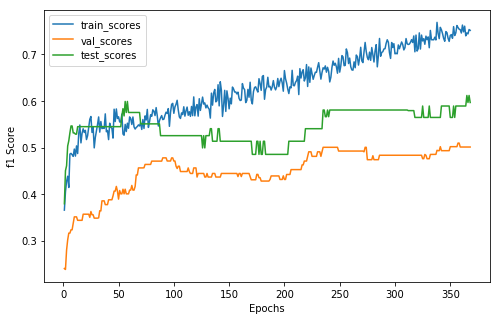

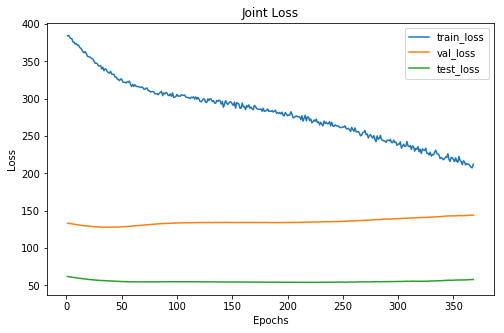

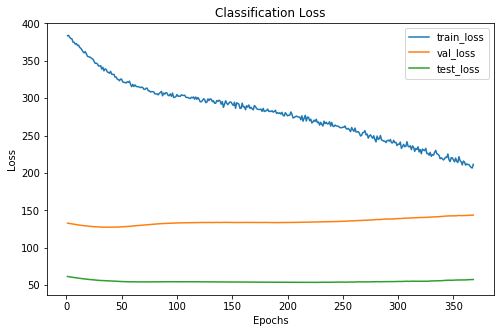

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  24   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      144     41      22
 1      149     50      23
 2       63     29      11
xxxxxxxxxxxxxx epoch: 68 xxxxxxxxxxxxxx


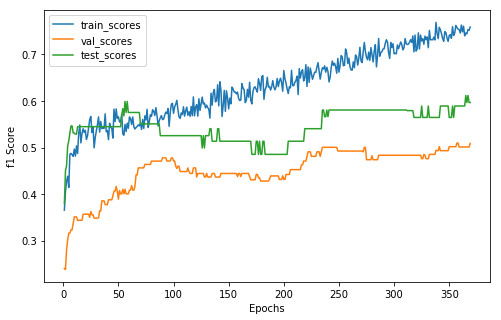

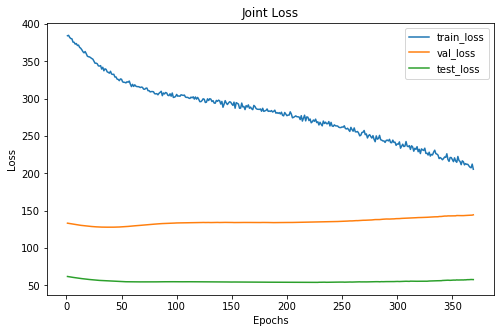

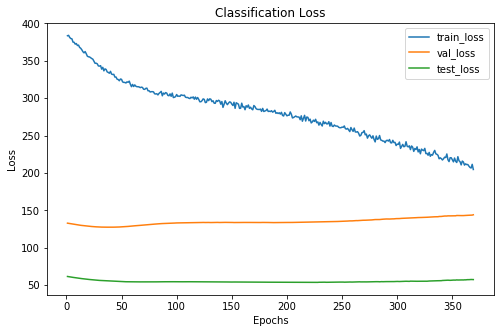

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      148     40      22
 1      149     51      23
 2       59     29      11
xxxxxxxxxxxxxx epoch: 69 xxxxxxxxxxxxxx


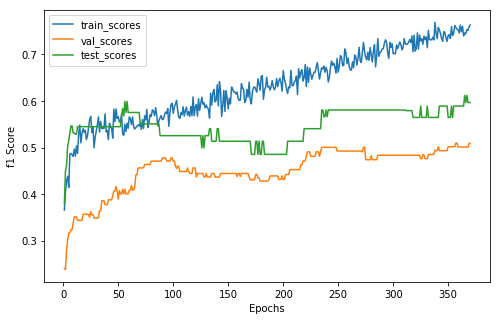

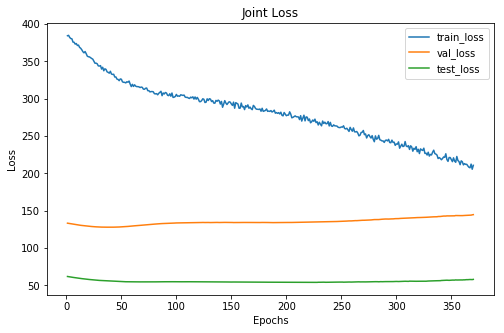

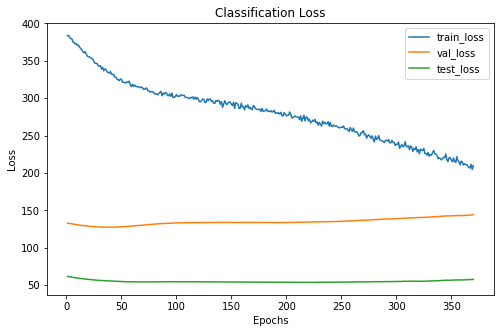

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      147     40      22
 1      142     51      23
 2       67     29      11
xxxxxxxxxxxxxx epoch: 70 xxxxxxxxxxxxxx


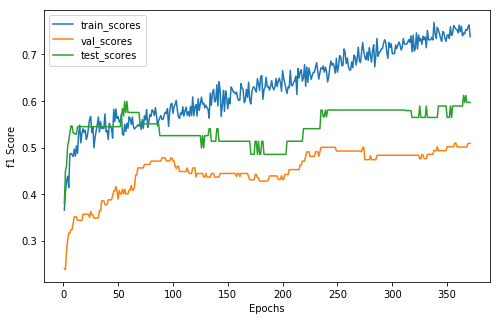

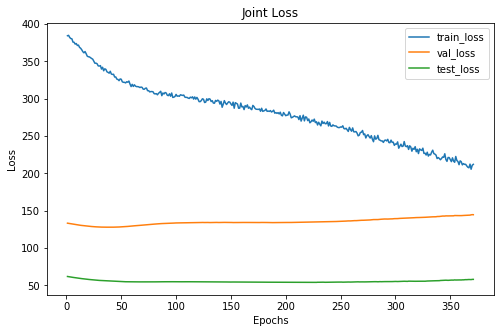

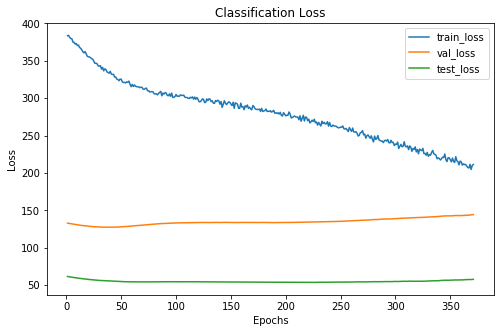

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      150     40      22
 1      147     51      23
 2       59     29      11
xxxxxxxxxxxxxx epoch: 71 xxxxxxxxxxxxxx


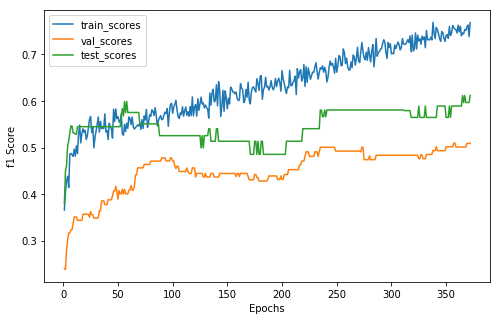

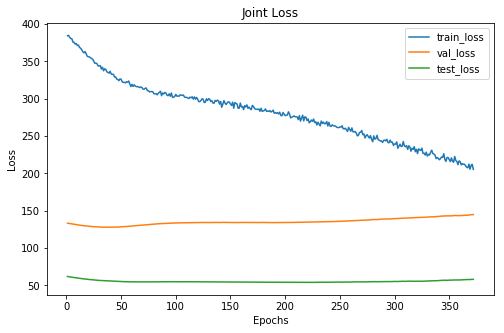

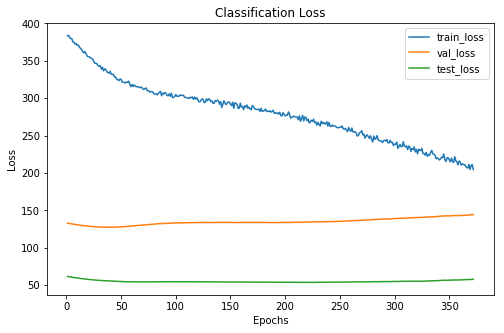

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      148     40      21
 1      143     51      24
 2       65     29      11
xxxxxxxxxxxxxx epoch: 72 xxxxxxxxxxxxxx


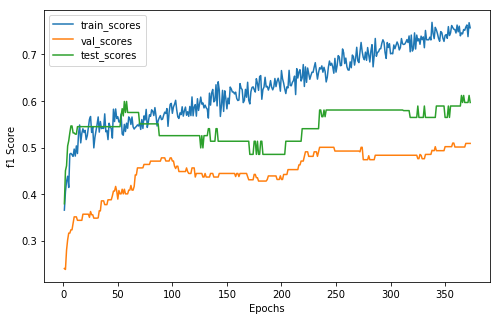

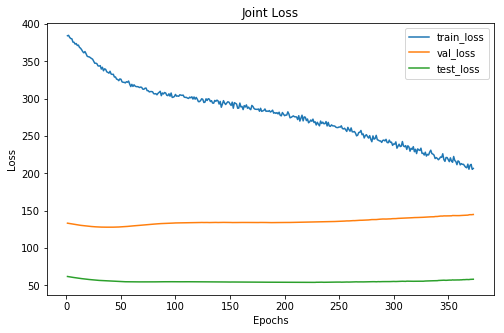

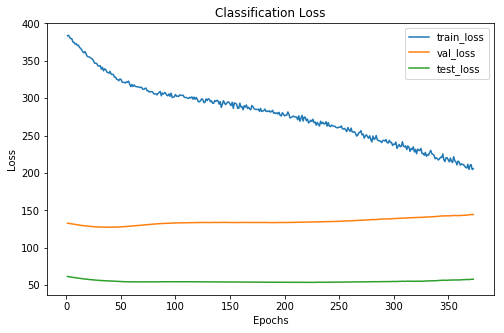

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      151     40      22
 1      141     51      23
 2       64     29      11
xxxxxxxxxxxxxx epoch: 73 xxxxxxxxxxxxxx


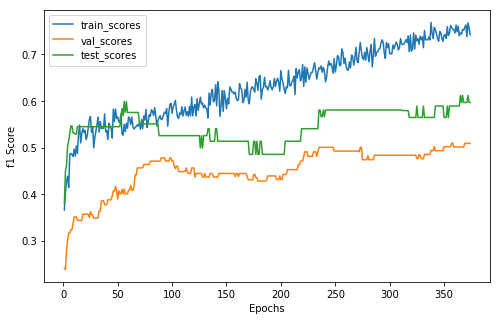

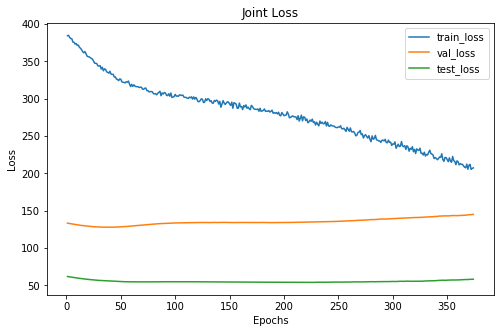

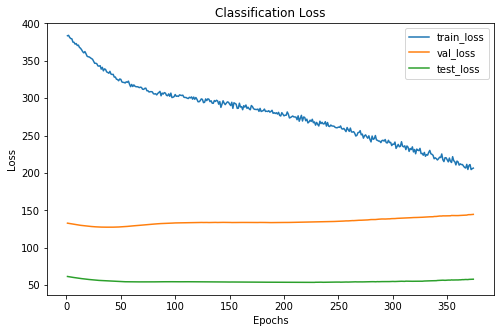

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     40      22
 1      153     51      23
 2       60     29      11
xxxxxxxxxxxxxx epoch: 74 xxxxxxxxxxxxxx


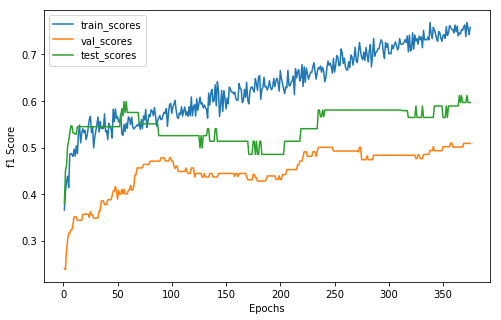

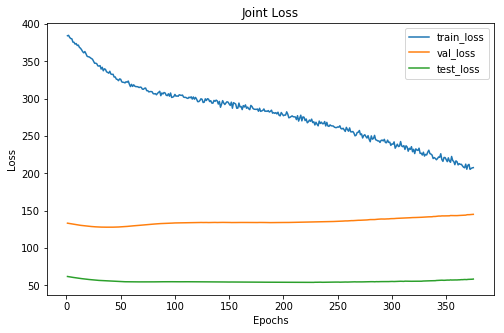

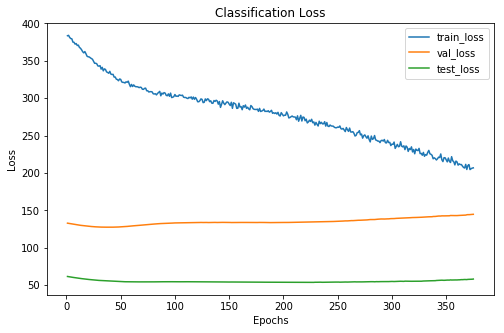

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     40      22
 1      147     51      23
 2       69     29      11
xxxxxxxxxxxxxx epoch: 75 xxxxxxxxxxxxxx


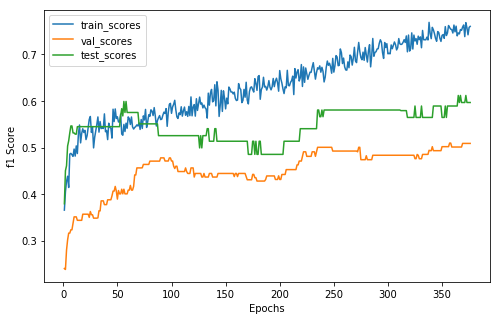

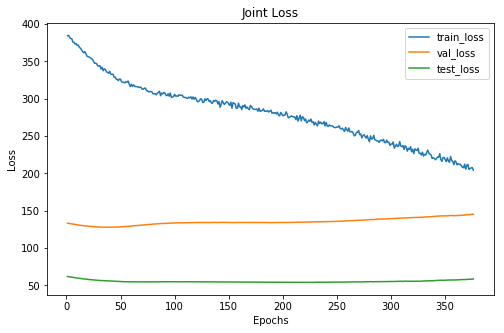

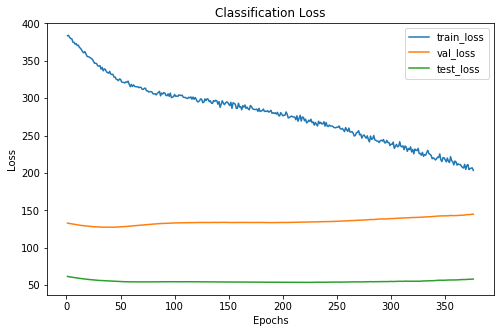

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      145     40      22
 1      148     51      23
 2       63     29      11
xxxxxxxxxxxxxx epoch: 76 xxxxxxxxxxxxxx


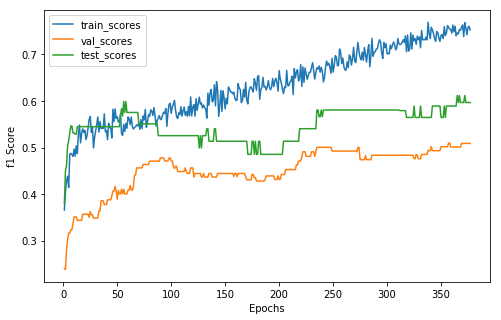

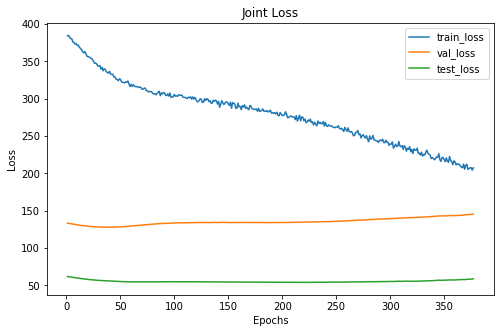

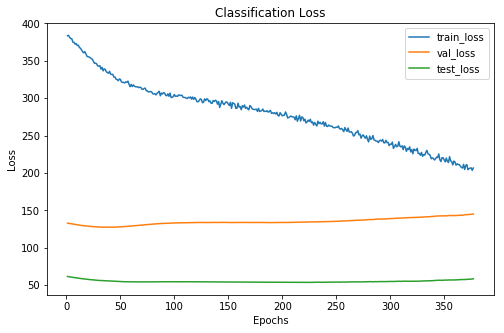

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      136     40      22
 1      151     51      23
 2       69     29      11
xxxxxxxxxxxxxx epoch: 77 xxxxxxxxxxxxxx


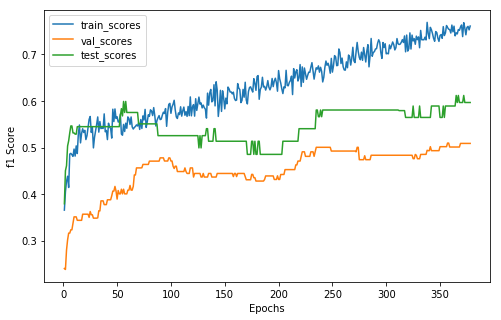

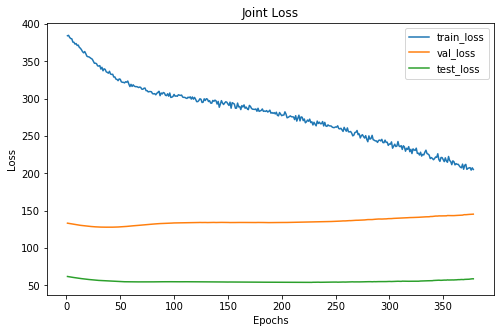

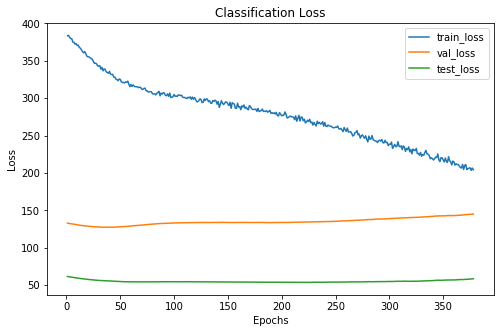

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      139     40      22
 1      150     51      23
 2       67     29      11
xxxxxxxxxxxxxx epoch: 78 xxxxxxxxxxxxxx


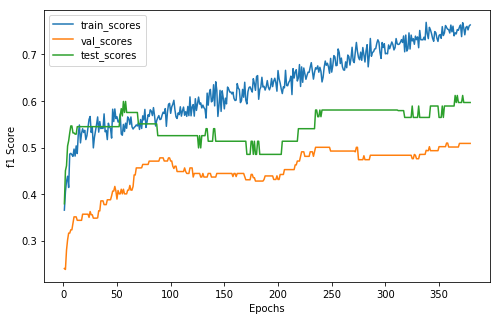

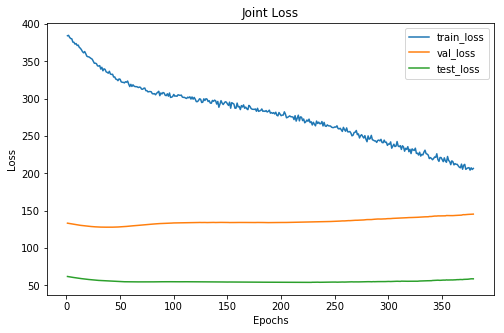

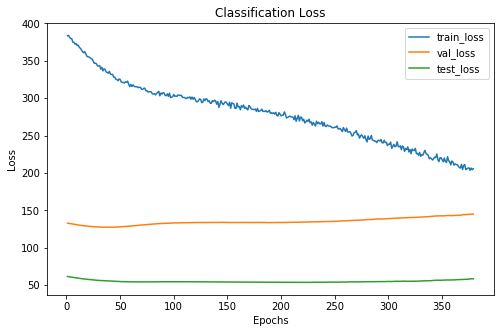

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      144     40      22
 1      145     51      23
 2       67     29      11
xxxxxxxxxxxxxx epoch: 79 xxxxxxxxxxxxxx


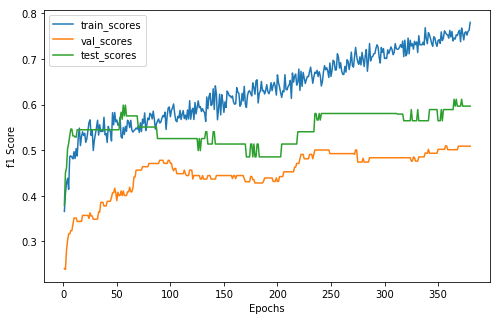

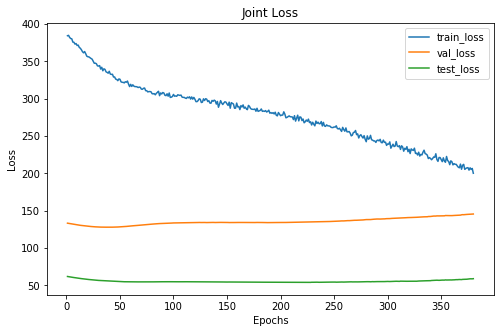

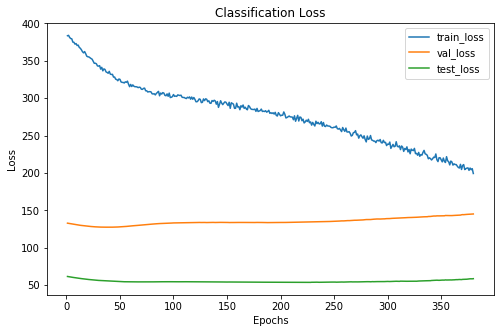

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      144     40      22
 1      144     51      23
 2       68     29      11
xxxxxxxxxxxxxx epoch: 80 xxxxxxxxxxxxxx


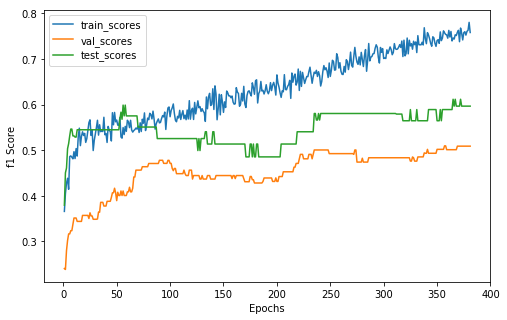

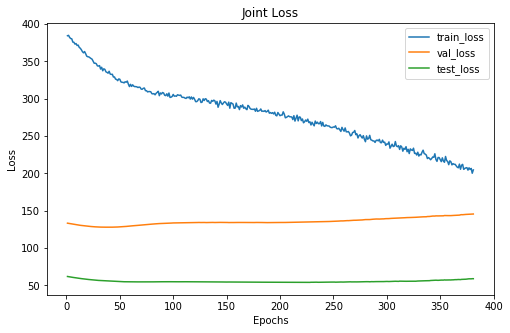

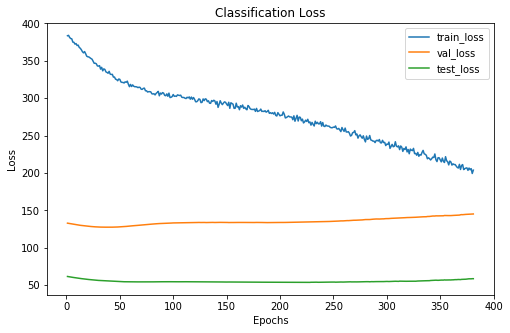

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      135     40      22
 1      150     51      23
 2       71     29      11
xxxxxxxxxxxxxx epoch: 81 xxxxxxxxxxxxxx


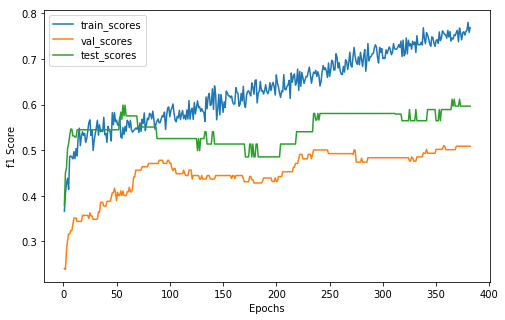

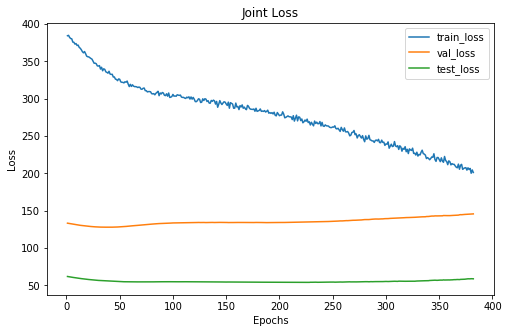

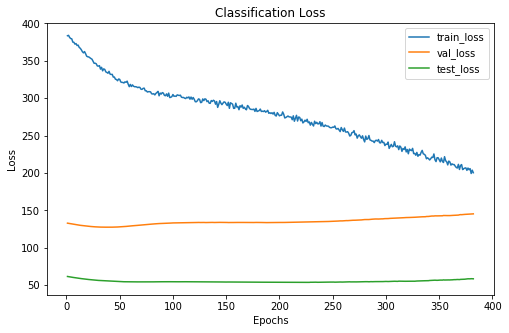

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     40      22
 1      145     51      23
 2       68     29      11
xxxxxxxxxxxxxx epoch: 82 xxxxxxxxxxxxxx


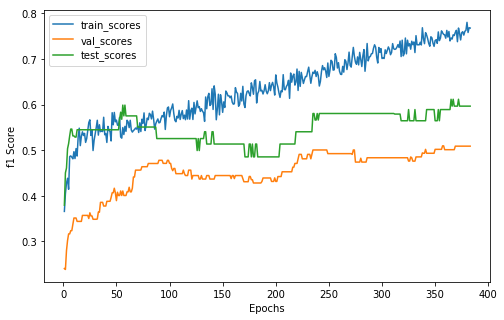

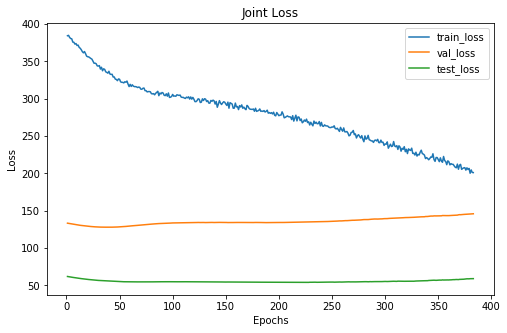

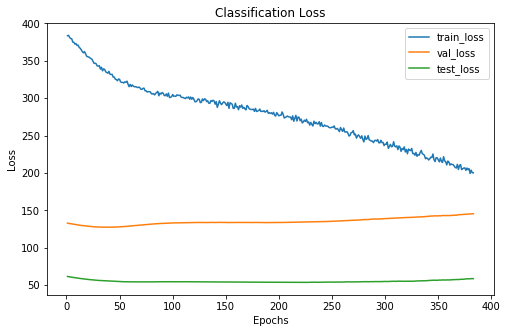

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      146     40      22
 1      147     51      23
 2       63     29      11
xxxxxxxxxxxxxx epoch: 83 xxxxxxxxxxxxxx


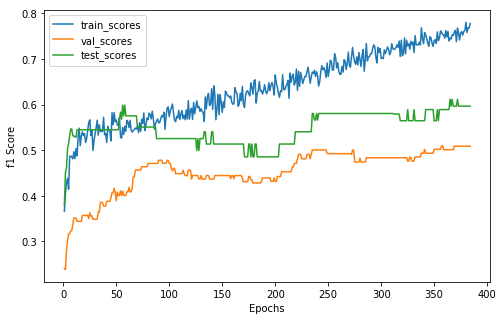

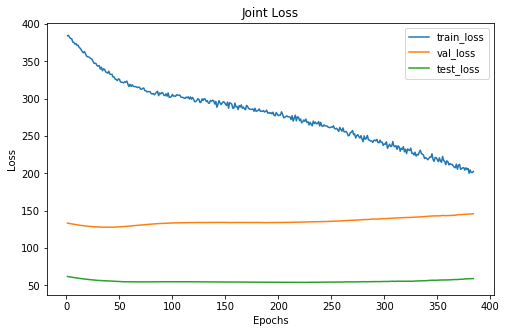

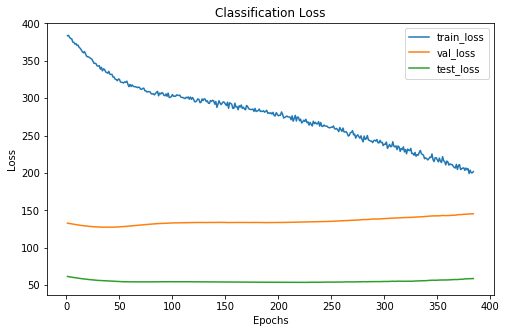

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      136     40      22
 1      151     51      23
 2       69     29      11
xxxxxxxxxxxxxx epoch: 84 xxxxxxxxxxxxxx


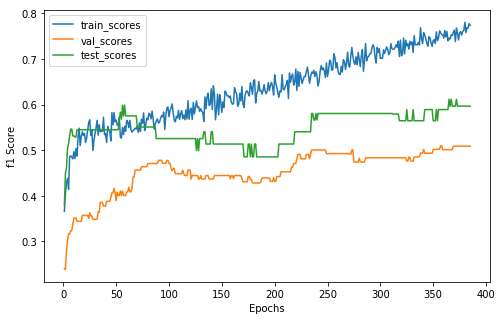

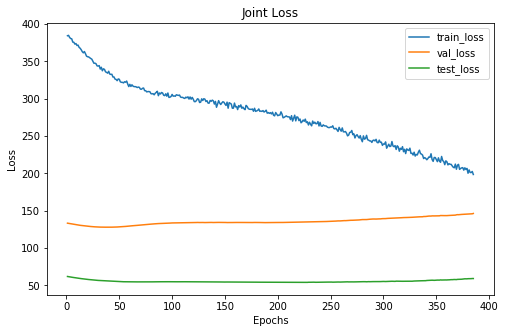

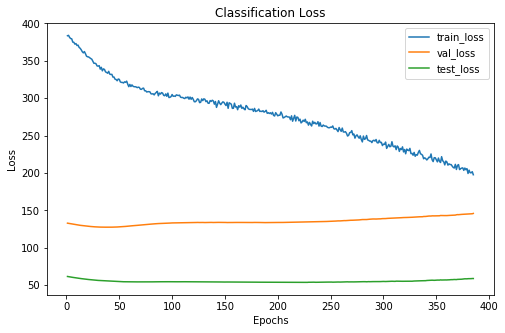

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      141     40      22
 1      152     51      23
 2       63     29      11
xxxxxxxxxxxxxx epoch: 85 xxxxxxxxxxxxxx


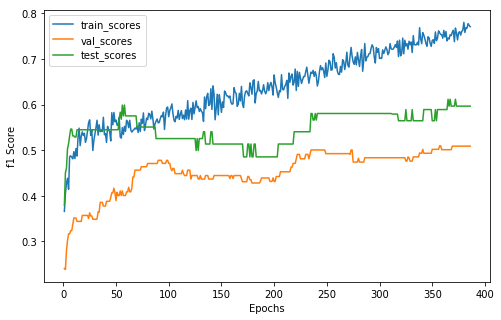

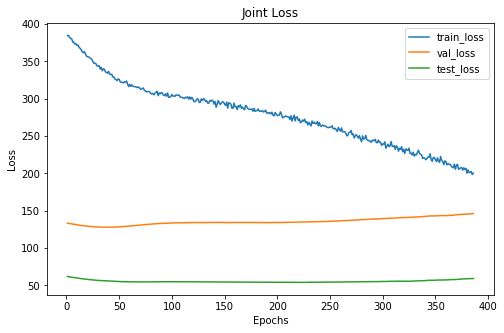

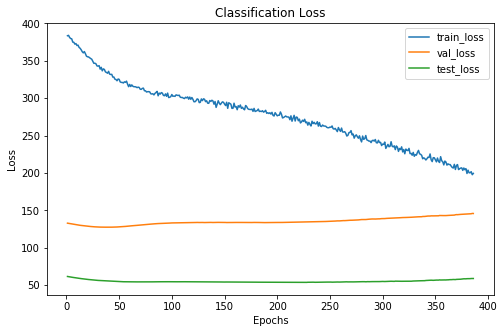

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      150     40      22
 1      146     51      23
 2       60     29      11
xxxxxxxxxxxxxx epoch: 86 xxxxxxxxxxxxxx


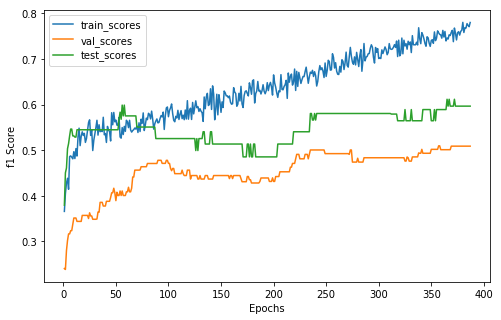

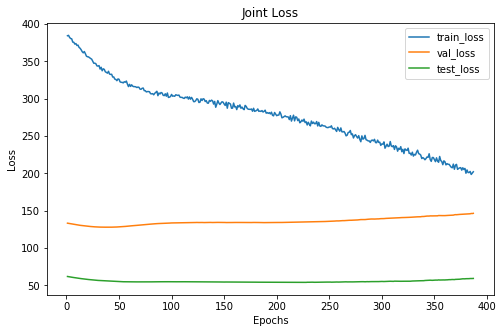

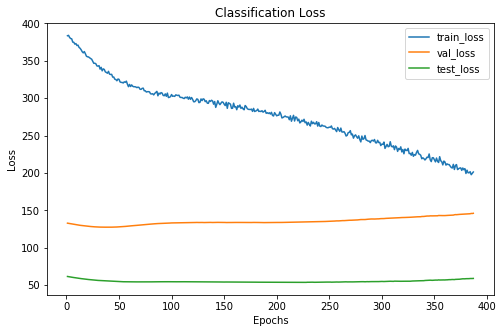

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     40      22
 1      148     51      23
 2       65     29      11
xxxxxxxxxxxxxx epoch: 87 xxxxxxxxxxxxxx


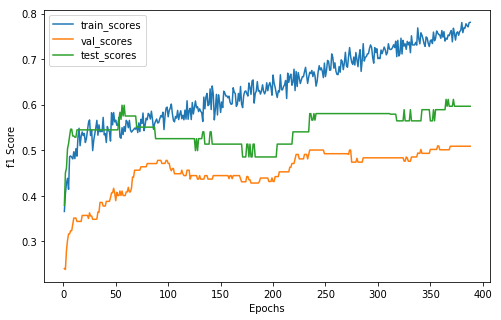

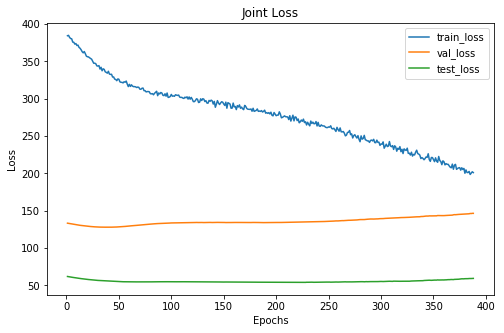

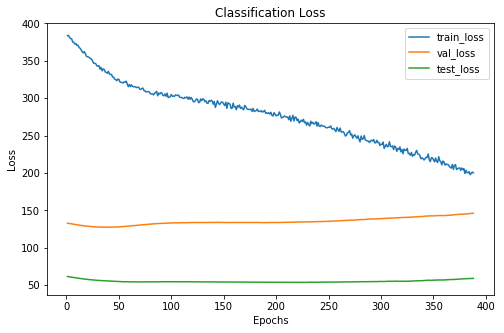

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      138     40      22
 1      146     51      23
 2       72     29      11
xxxxxxxxxxxxxx epoch: 88 xxxxxxxxxxxxxx


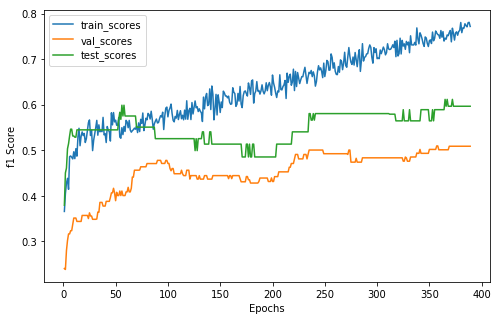

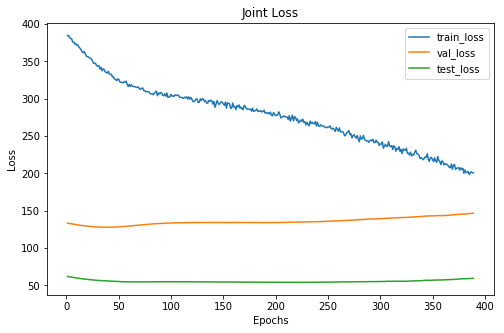

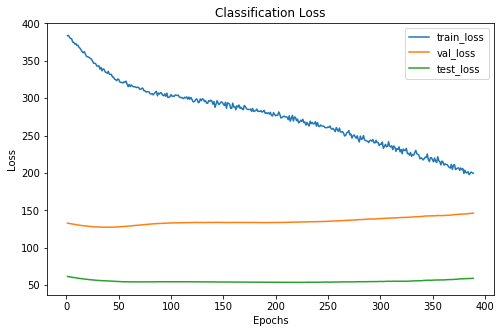

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     40      22
 1      142     51      23
 2       71     29      11
xxxxxxxxxxxxxx epoch: 89 xxxxxxxxxxxxxx


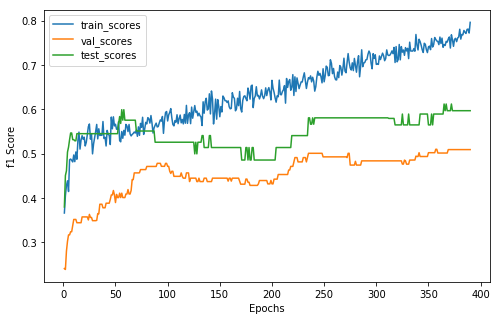

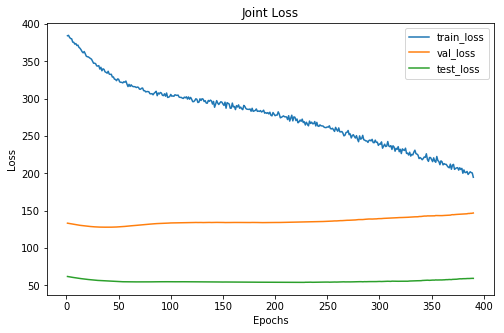

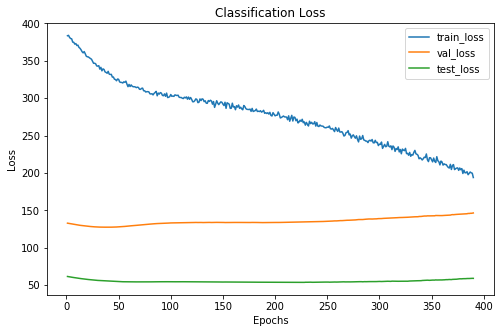

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      142     40      22
 1      157     51      23
 2       57     29      11
xxxxxxxxxxxxxx epoch: 90 xxxxxxxxxxxxxx


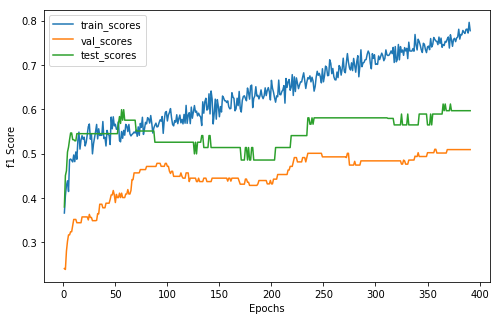

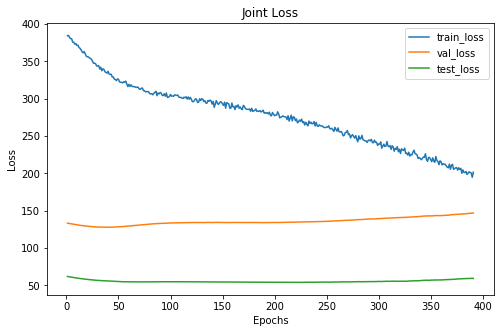

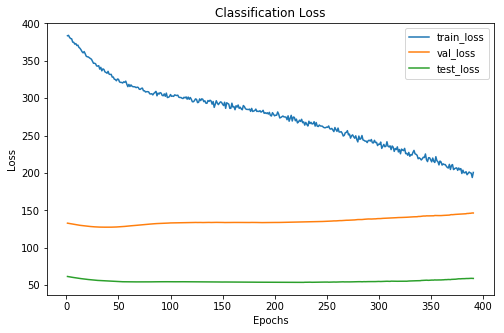

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      144     40      22
 1      144     51      23
 2       68     29      11
xxxxxxxxxxxxxx epoch: 91 xxxxxxxxxxxxxx


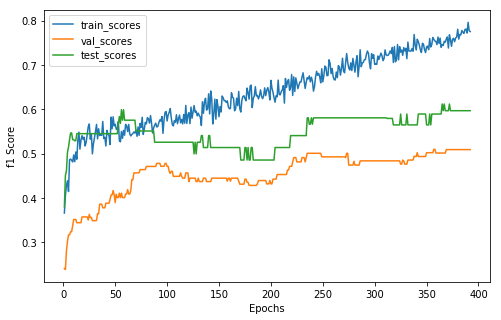

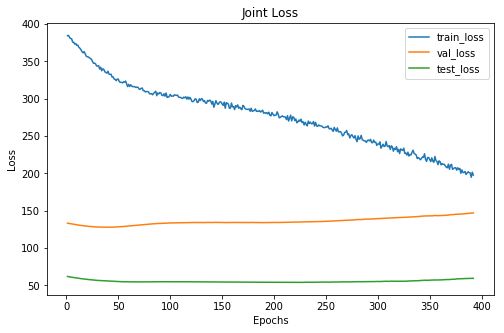

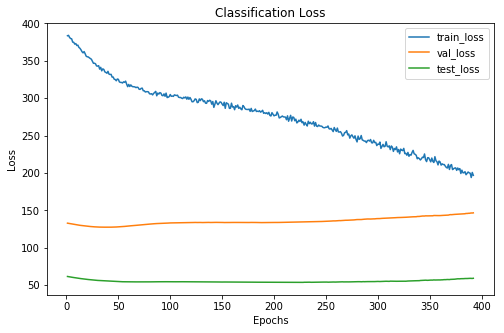

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      139     40      22
 1      145     51      23
 2       72     29      11
xxxxxxxxxxxxxx epoch: 92 xxxxxxxxxxxxxx


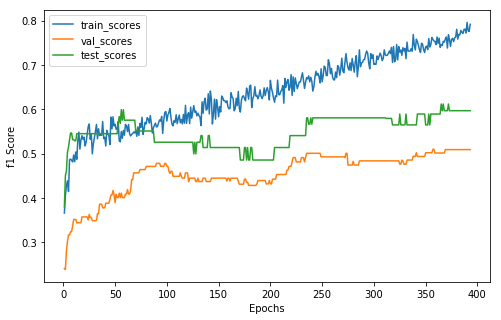

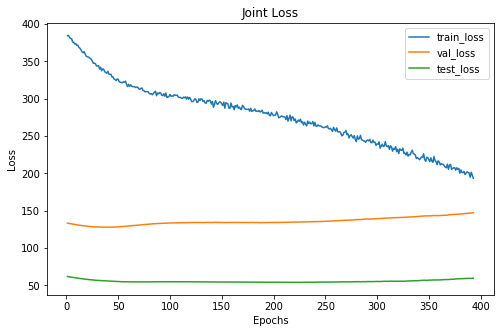

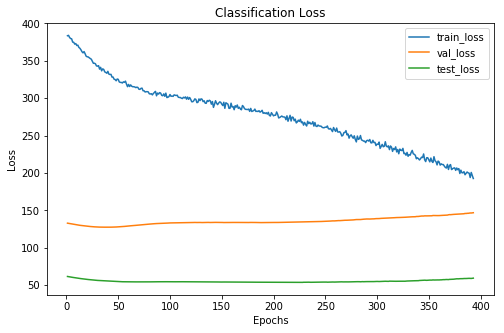

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      141     40      22
 1      146     51      23
 2       69     29      11
xxxxxxxxxxxxxx epoch: 93 xxxxxxxxxxxxxx


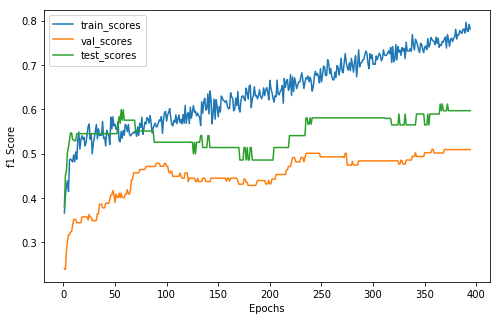

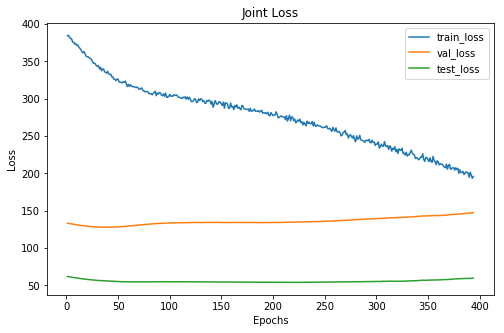

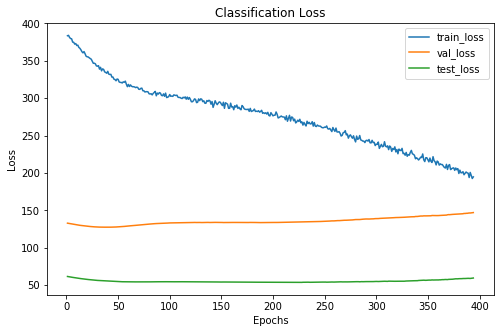

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      146     40      22
 1      154     51      23
 2       56     29      11
xxxxxxxxxxxxxx epoch: 94 xxxxxxxxxxxxxx


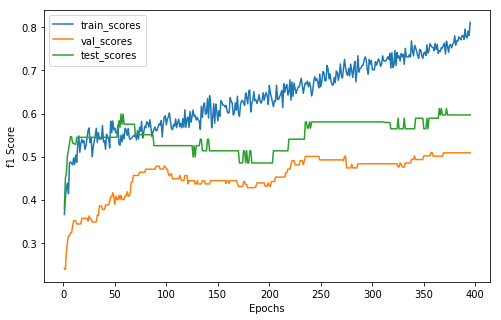

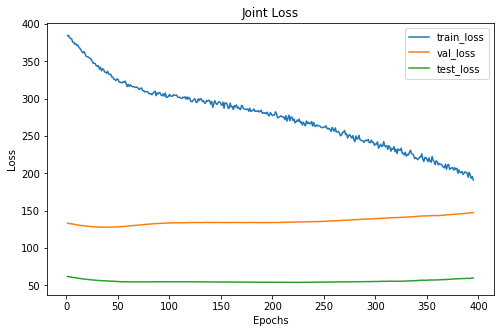

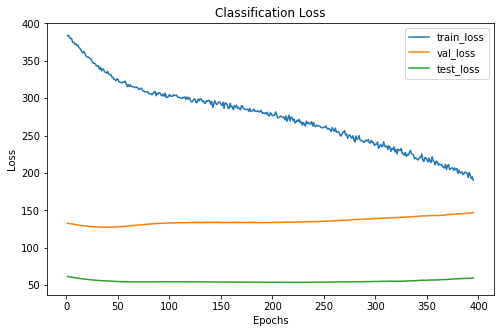

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      138     40      22
 1      150     51      23
 2       68     29      11
xxxxxxxxxxxxxx epoch: 95 xxxxxxxxxxxxxx


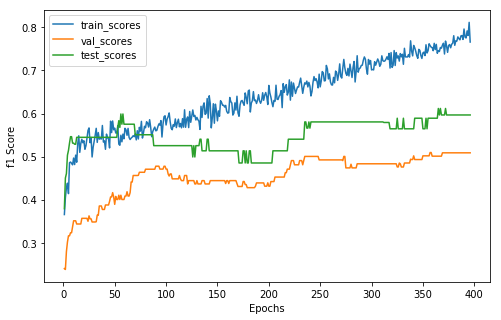

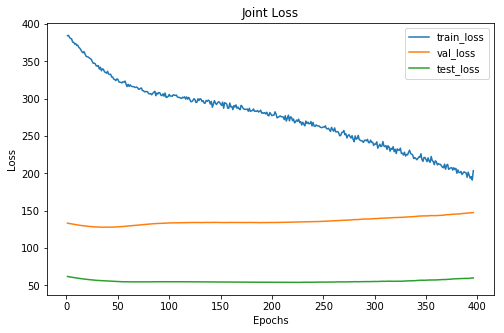

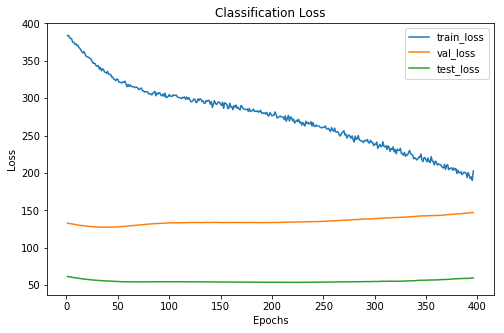

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      141     40      22
 1      149     51      23
 2       66     29      11
xxxxxxxxxxxxxx epoch: 96 xxxxxxxxxxxxxx


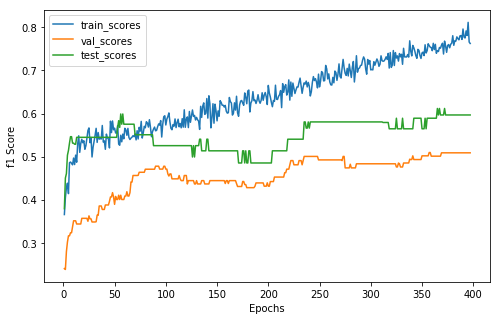

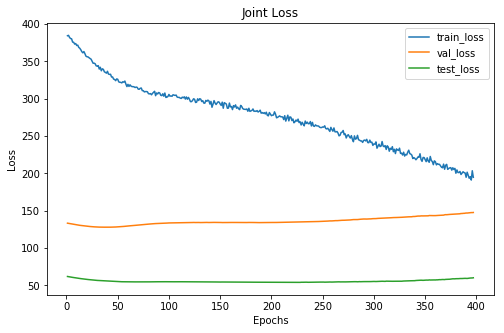

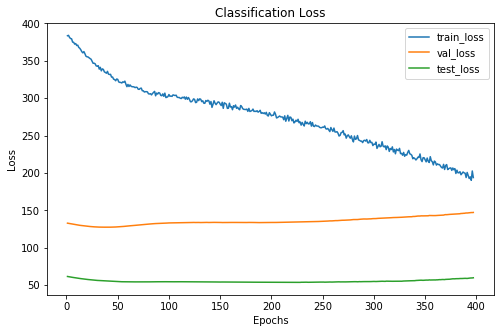

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      137     40      22
 1      155     51      23
 2       64     29      11
xxxxxxxxxxxxxx epoch: 97 xxxxxxxxxxxxxx


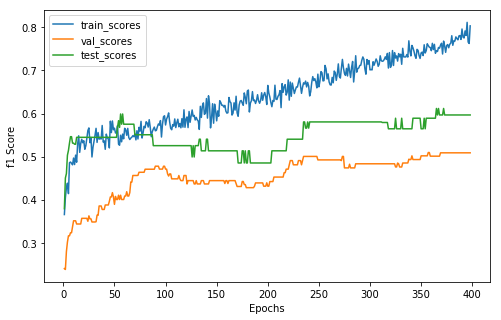

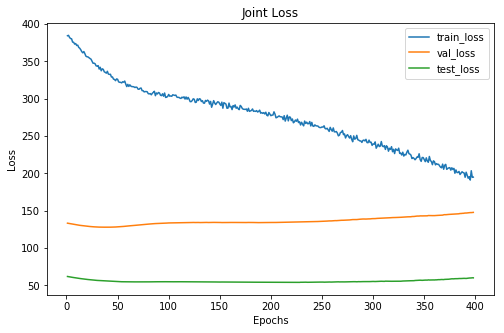

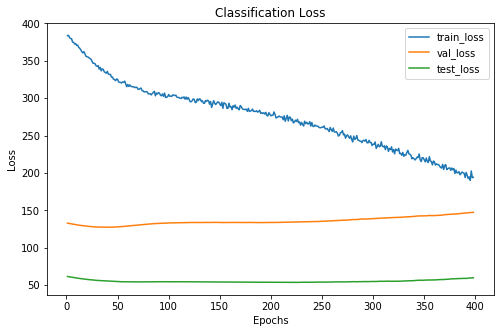

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      142     40      22
 1      148     51      23
 2       66     29      11
xxxxxxxxxxxxxx epoch: 98 xxxxxxxxxxxxxx


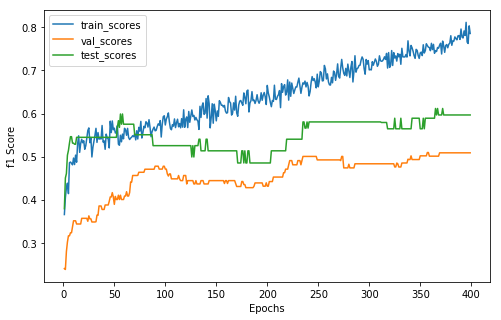

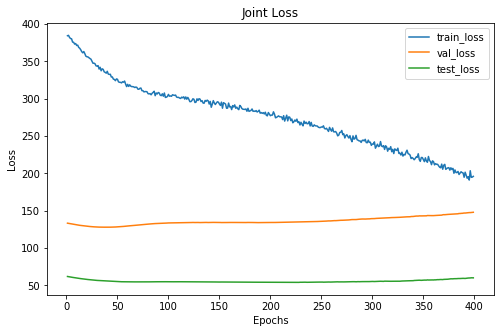

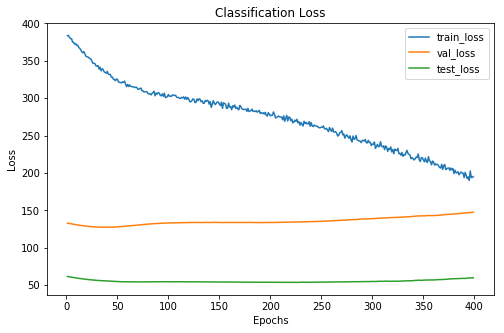

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      144     40      22
 1      146     51      23
 2       66     29      11
xxxxxxxxxxxxxx epoch: 99 xxxxxxxxxxxxxx


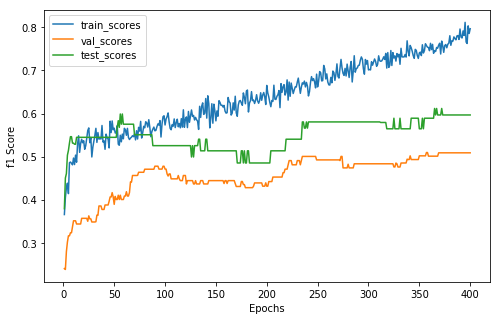

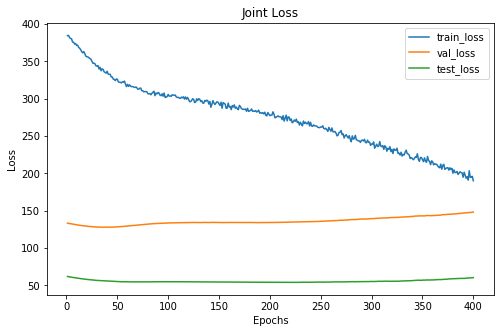

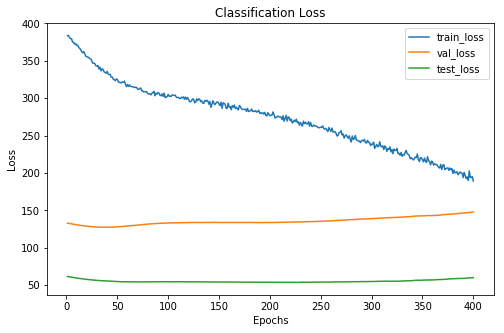

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      145     40      22
 1      148     51      23
 2       63     29      11
xxxxxxxxxxxxxx epoch: 100 xxxxxxxxxxxxxx


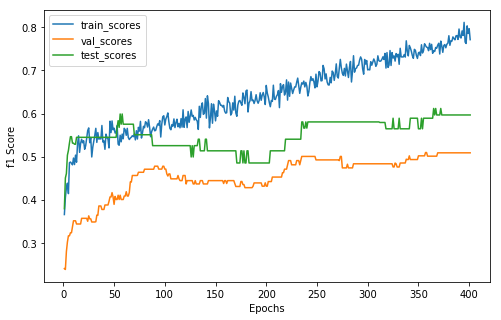

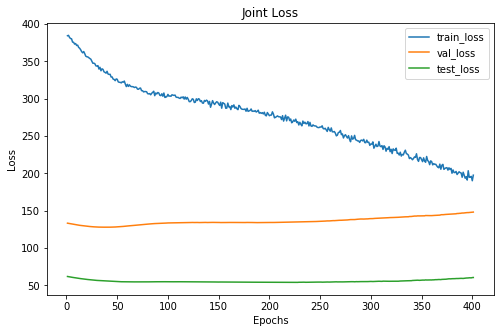

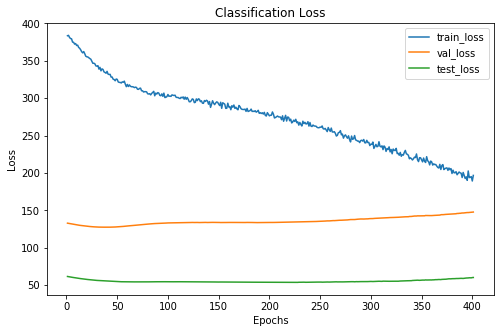

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      145     40      22
 1      145     51      23
 2       66     29      11
xxxxxxxxxxxxxx epoch: 101 xxxxxxxxxxxxxx


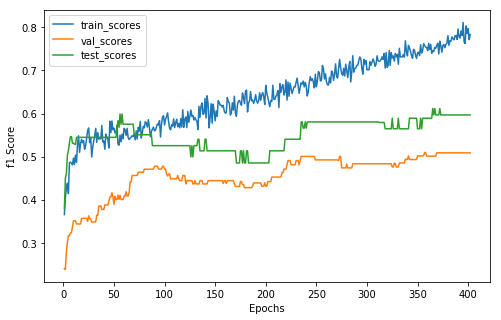

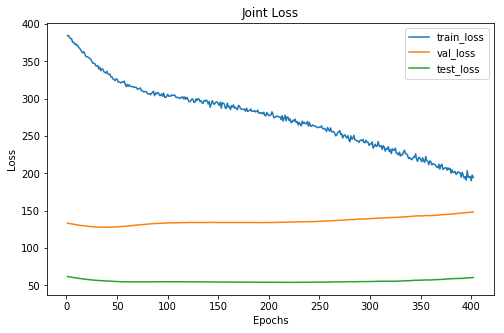

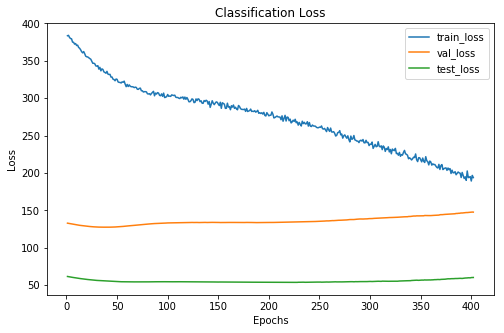

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      139     40      22
 1      148     51      23
 2       69     29      11
xxxxxxxxxxxxxx epoch: 102 xxxxxxxxxxxxxx


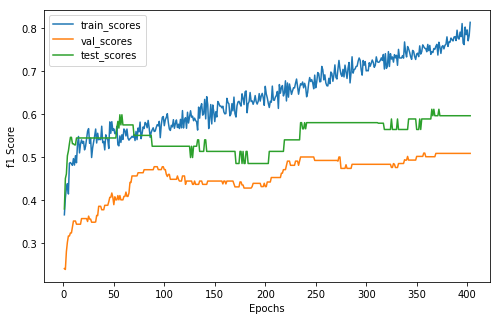

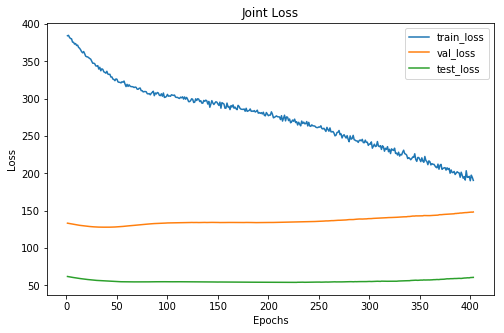

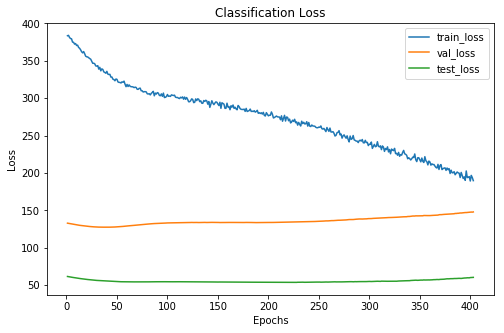

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      144     40      22
 1      143     51      23
 2       69     29      11
xxxxxxxxxxxxxx epoch: 103 xxxxxxxxxxxxxx


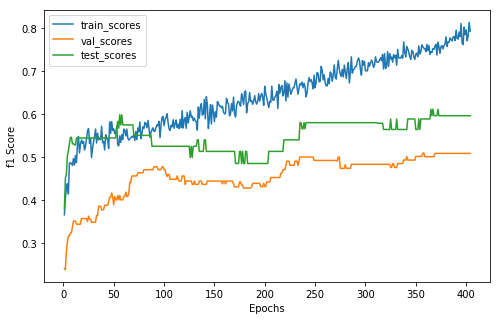

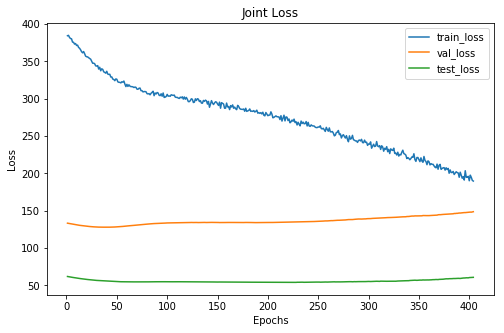

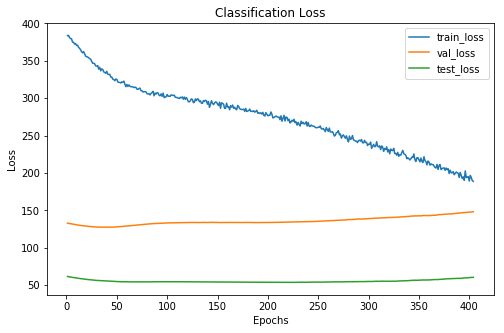

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      145     40      22
 1      148     51      23
 2       63     29      11
xxxxxxxxxxxxxx epoch: 104 xxxxxxxxxxxxxx


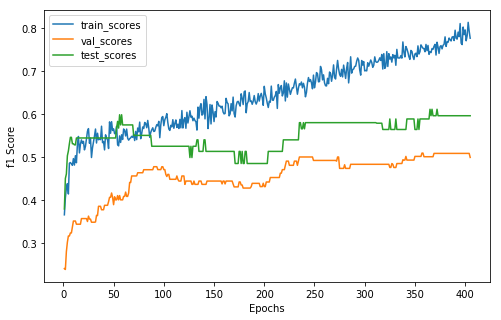

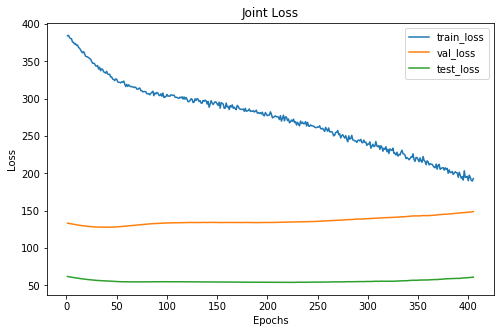

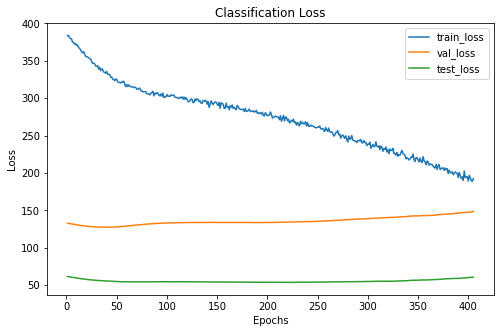

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      144     40      22
 1      145     52      23
 2       67     28      11
xxxxxxxxxxxxxx epoch: 105 xxxxxxxxxxxxxx


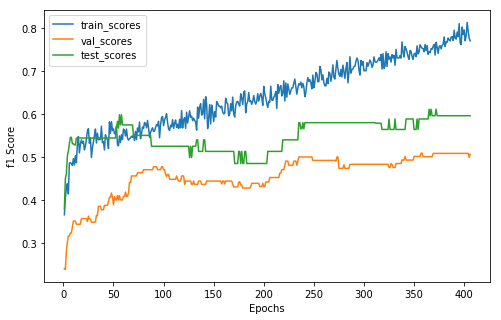

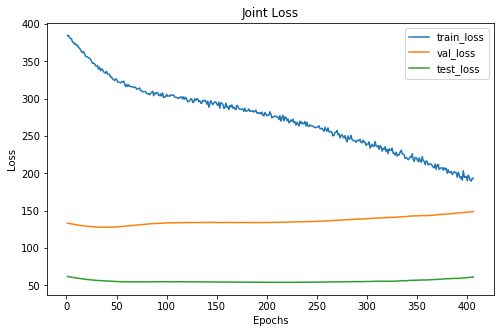

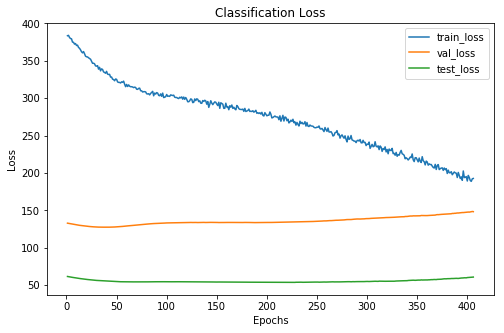

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
14  25   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      146     41      22
 1      147     51      23
 2       63     28      11
xxxxxxxxxxxxxx epoch: 106 xxxxxxxxxxxxxx


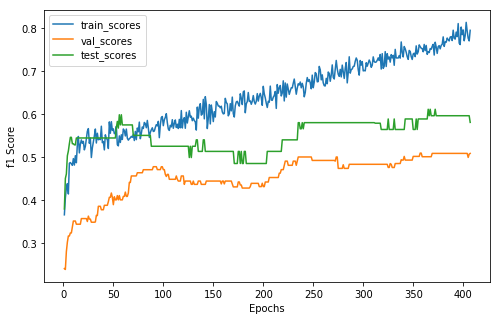

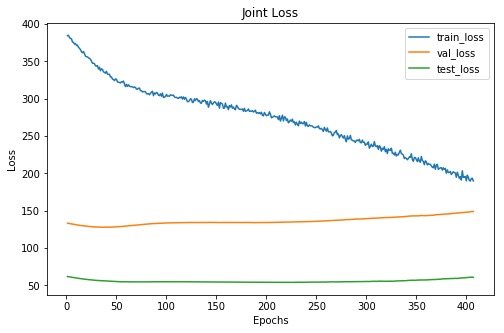

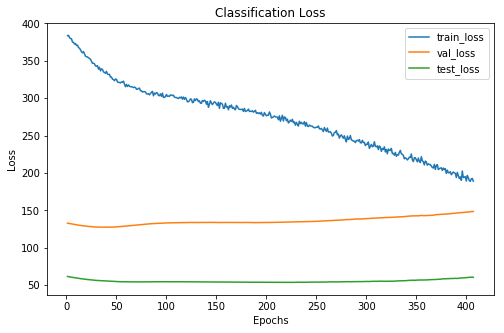

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      150     40      21
 1      149     51      23
 2       57     29      12
xxxxxxxxxxxxxx epoch: 107 xxxxxxxxxxxxxx


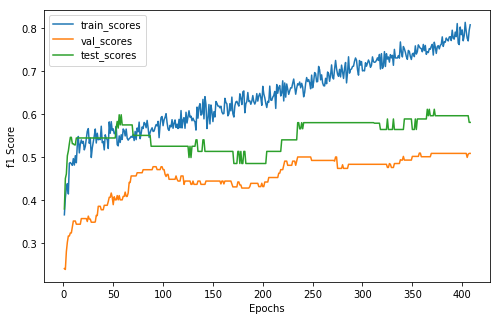

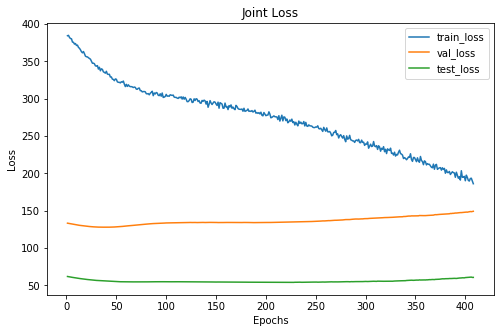

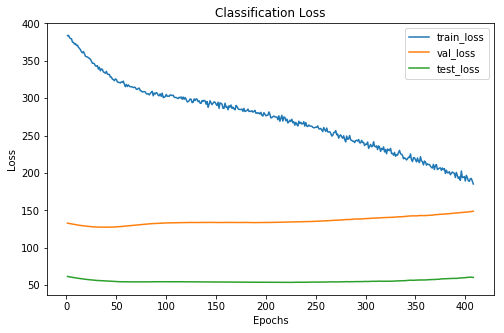

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      138     40      21
 1      149     51      23
 2       69     29      12
xxxxxxxxxxxxxx epoch: 108 xxxxxxxxxxxxxx


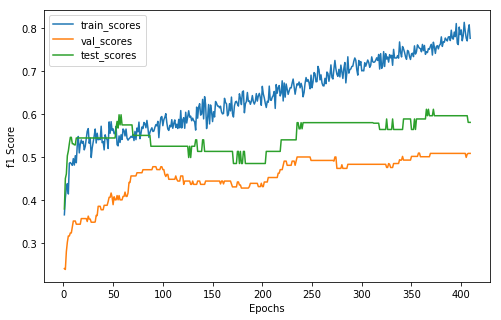

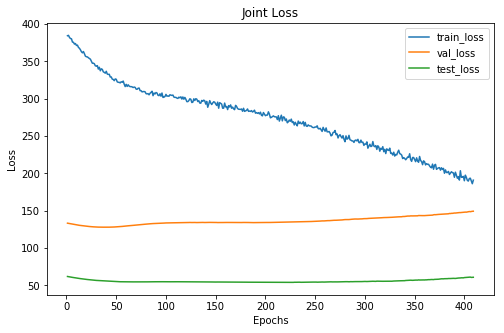

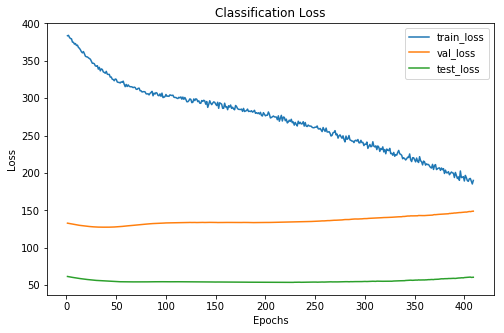

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      148     40      21
 1      138     51      23
 2       70     29      12
xxxxxxxxxxxxxx epoch: 109 xxxxxxxxxxxxxx


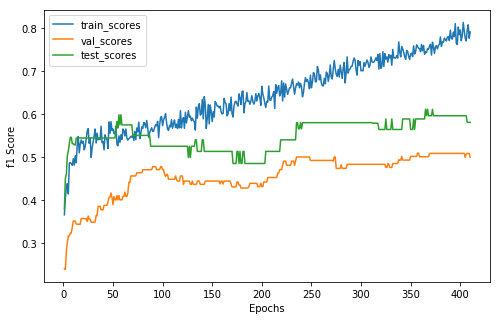

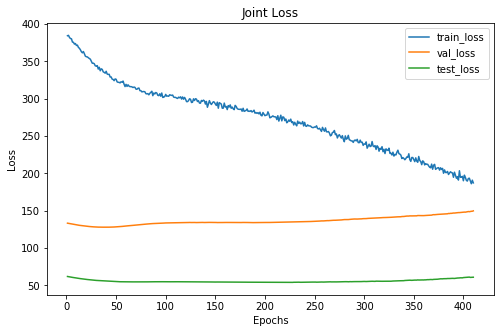

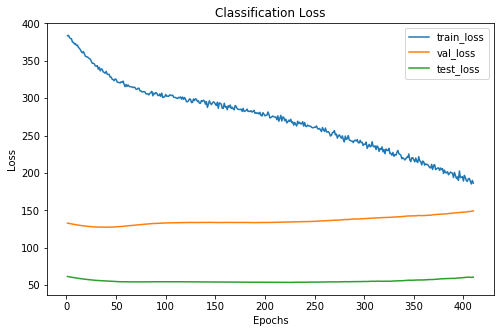

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      135     40      21
 1      152     52      23
 2       69     28      12
xxxxxxxxxxxxxx epoch: 110 xxxxxxxxxxxxxx


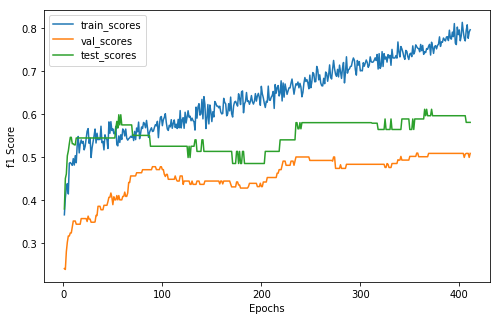

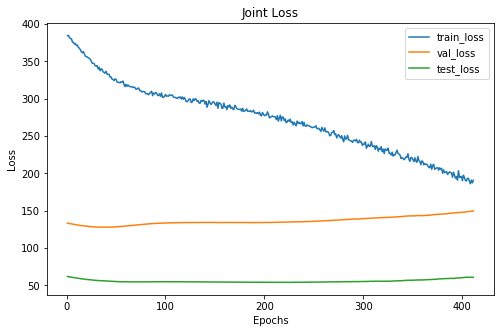

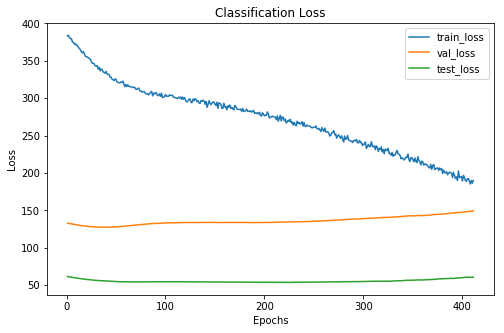

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  15  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      145     40      21
 1      143     51      23
 2       68     29      12
xxxxxxxxxxxxxx epoch: 111 xxxxxxxxxxxxxx


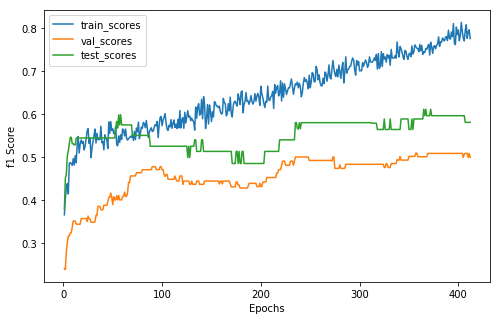

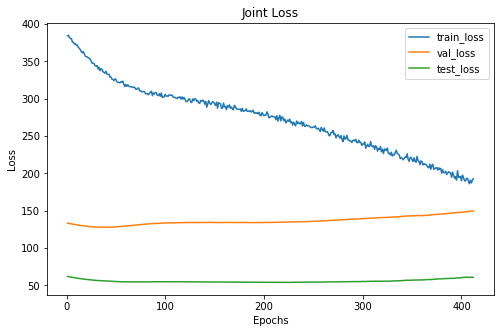

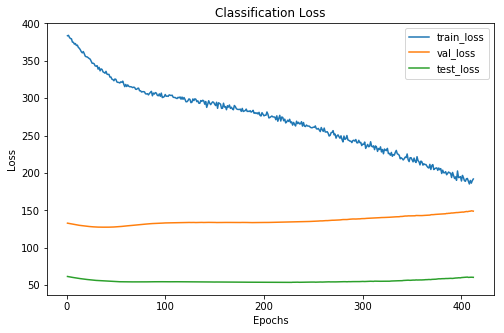

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      142     40      21
 1      152     52      23
 2       62     28      12
xxxxxxxxxxxxxx epoch: 112 xxxxxxxxxxxxxx


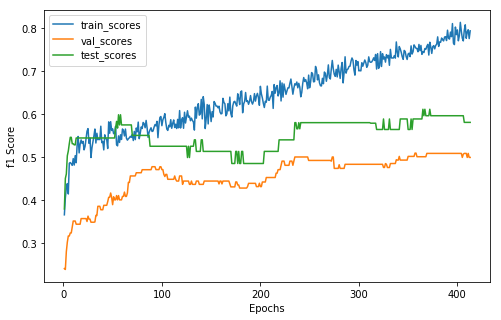

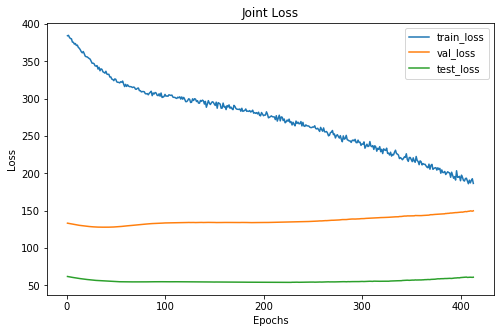

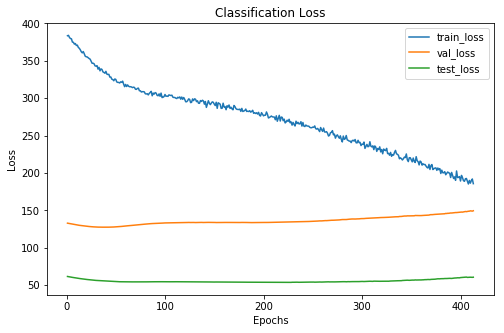

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     40      21
 1      141     52      23
 2       72     28      12
xxxxxxxxxxxxxx epoch: 113 xxxxxxxxxxxxxx


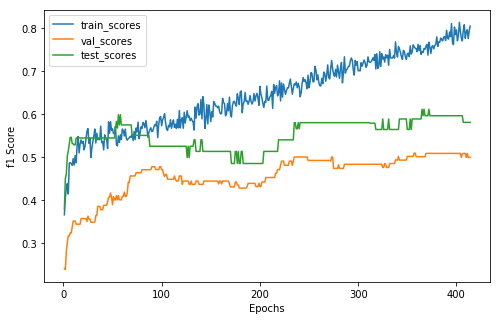

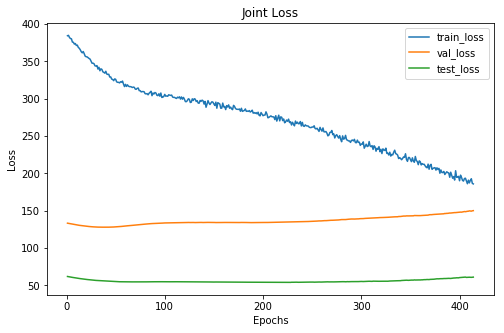

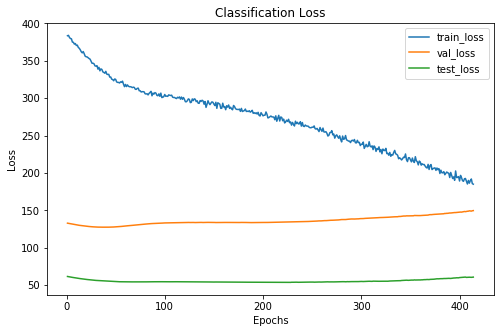

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      147     40      21
 1      137     52      23
 2       72     28      12
xxxxxxxxxxxxxx epoch: 114 xxxxxxxxxxxxxx


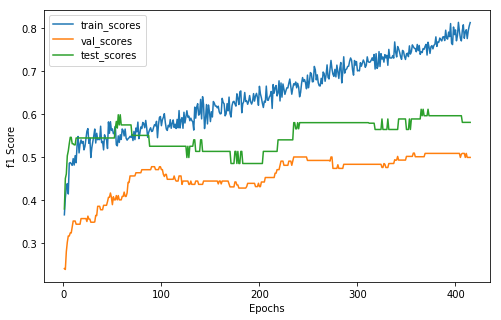

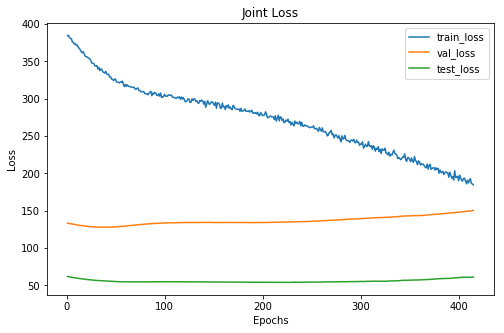

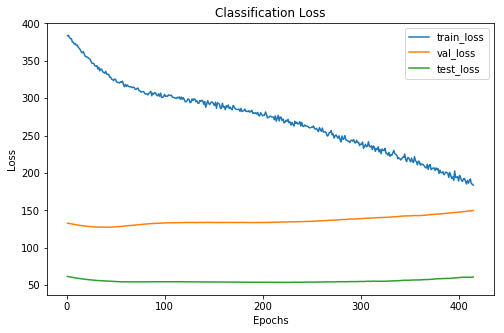

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      145     40      21
 1      143     52      23
 2       68     28      12
xxxxxxxxxxxxxx epoch: 115 xxxxxxxxxxxxxx


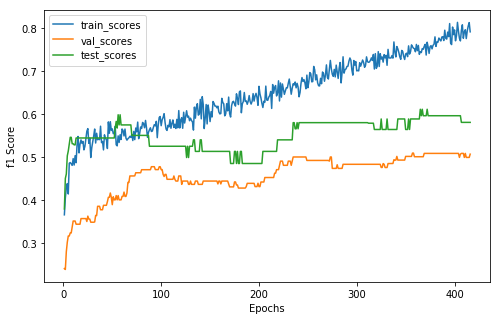

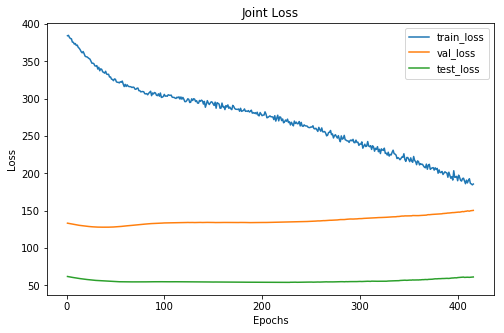

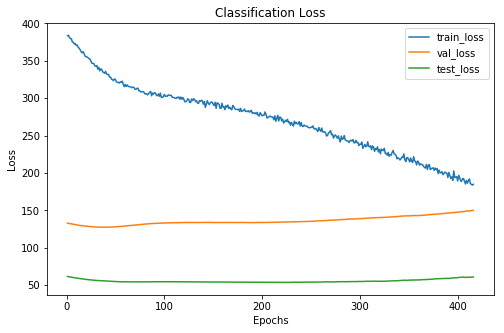

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
14  25   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      135     41      21
 1      150     51      23
 2       71     28      12
xxxxxxxxxxxxxx epoch: 116 xxxxxxxxxxxxxx


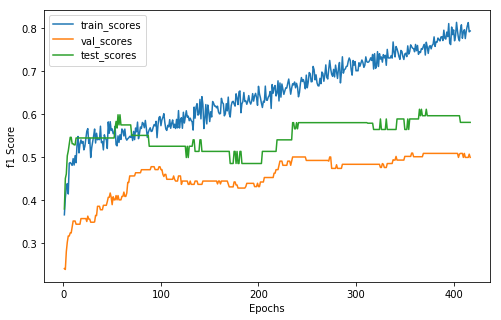

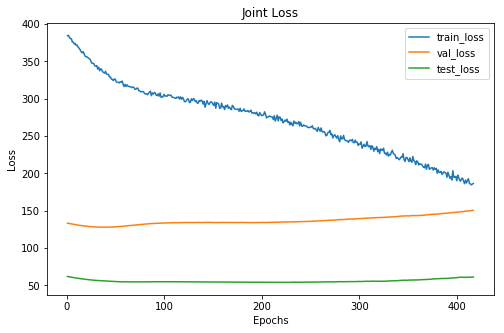

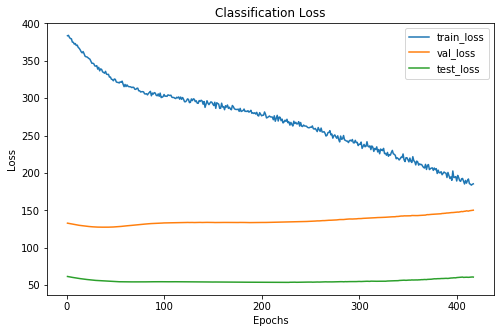

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     40      21
 1      148     52      23
 2       65     28      12
xxxxxxxxxxxxxx epoch: 117 xxxxxxxxxxxxxx


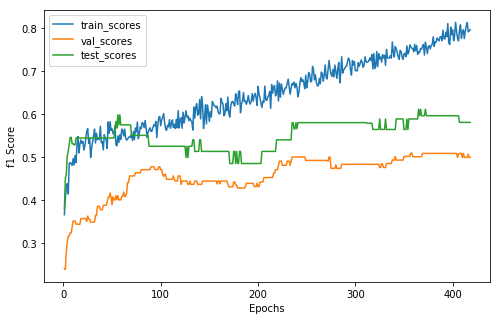

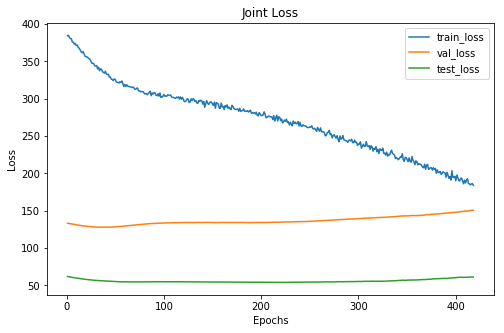

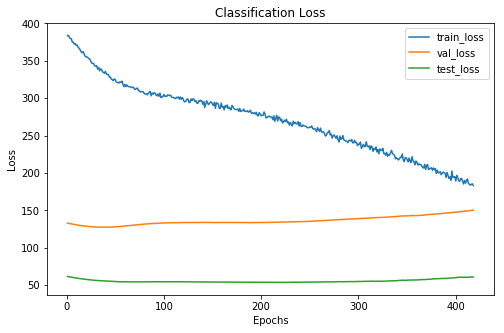

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     40      21
 1      143     52      23
 2       70     28      12
xxxxxxxxxxxxxx epoch: 118 xxxxxxxxxxxxxx


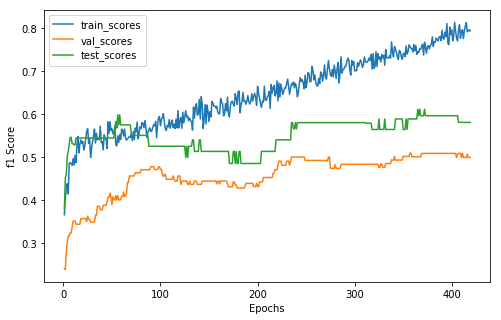

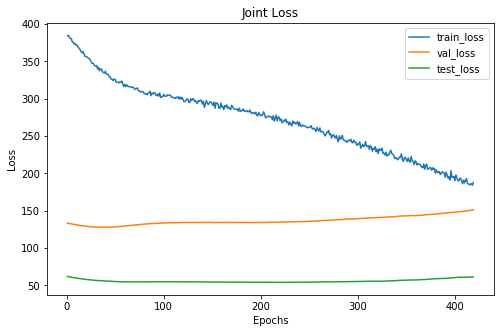

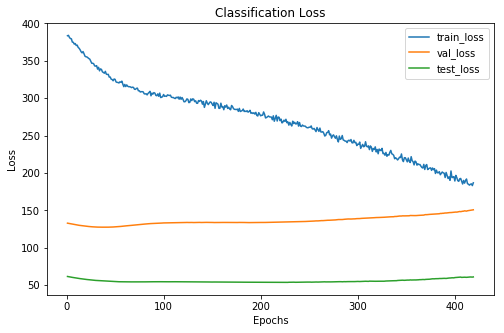

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      137     40      21
 1      150     52      23
 2       69     28      12
xxxxxxxxxxxxxx epoch: 119 xxxxxxxxxxxxxx


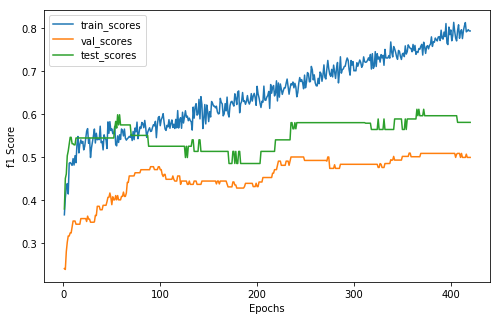

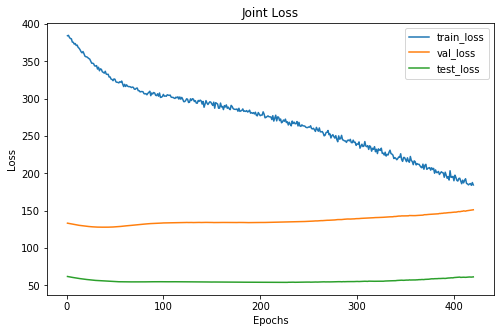

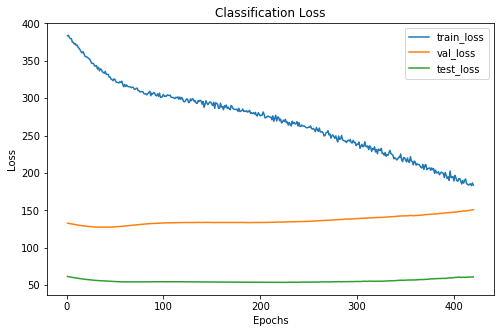

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      142     40      21
 1      147     52      23
 2       67     28      12
xxxxxxxxxxxxxx epoch: 120 xxxxxxxxxxxxxx


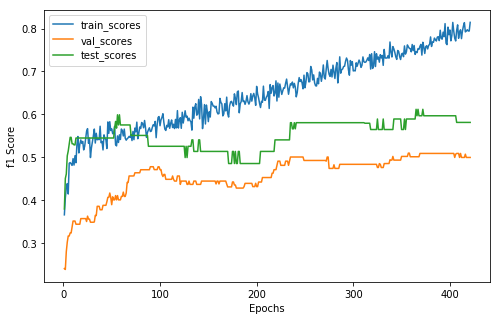

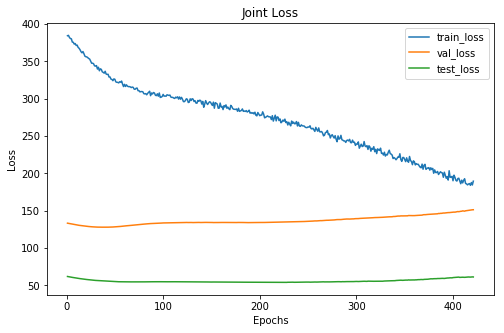

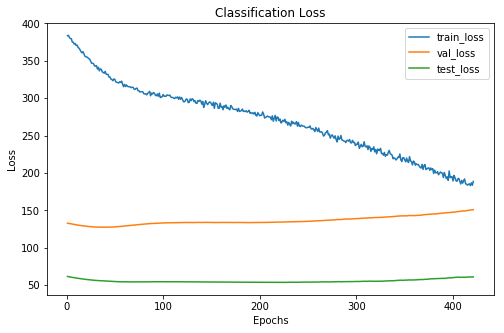

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     40      21
 1      149     52      23
 2       67     28      12
xxxxxxxxxxxxxx epoch: 121 xxxxxxxxxxxxxx


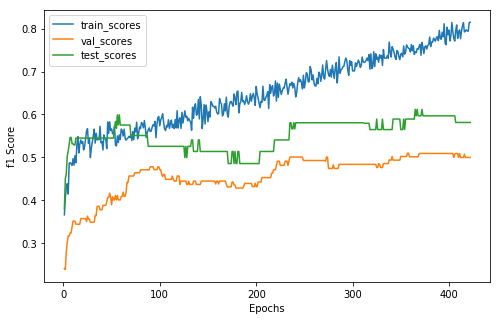

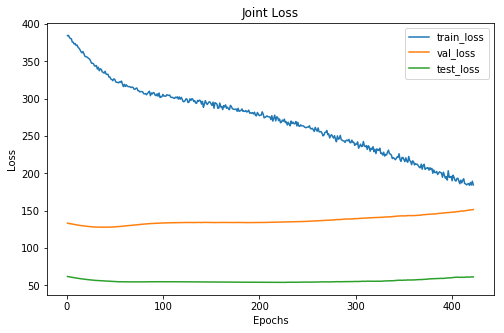

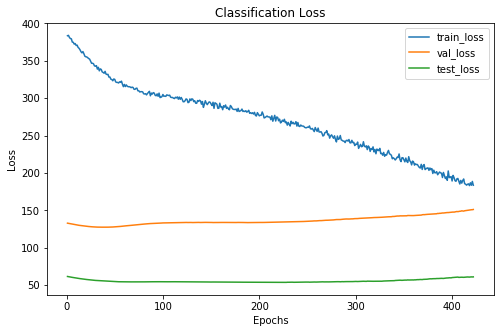

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  25   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      136     40      21
 1      146     52      23
 2       74     28      12
xxxxxxxxxxxxxx epoch: 122 xxxxxxxxxxxxxx


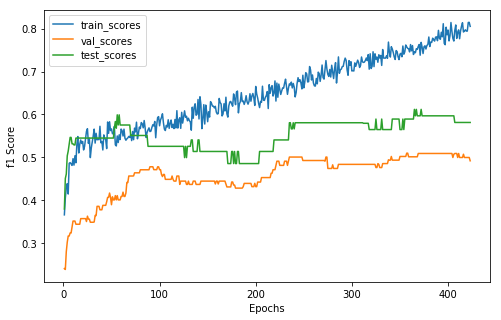

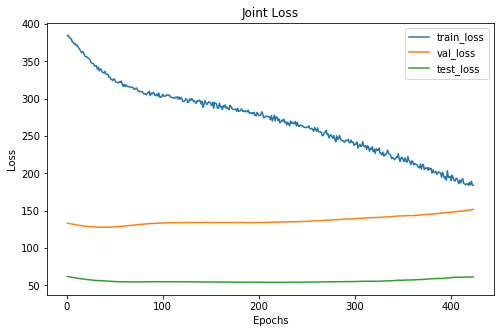

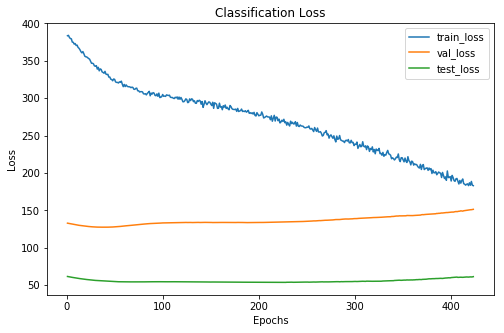

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  24   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      146     41      21
 1      143     51      23
 2       67     28      12
xxxxxxxxxxxxxx epoch: 123 xxxxxxxxxxxxxx


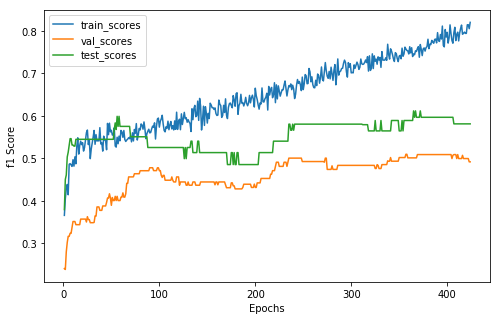

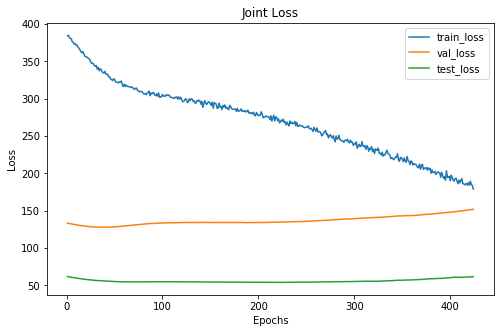

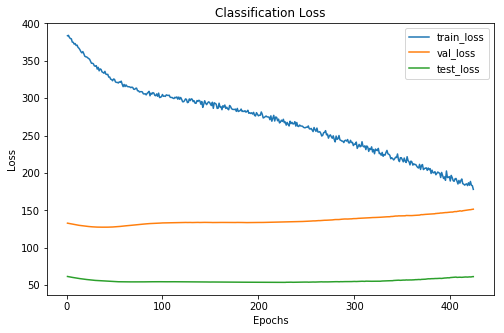

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  24   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      137     41      21
 1      147     51      23
 2       72     28      12
xxxxxxxxxxxxxx epoch: 124 xxxxxxxxxxxxxx


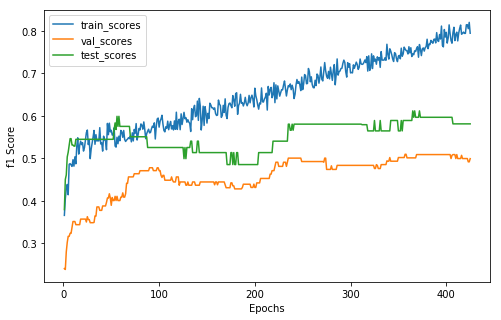

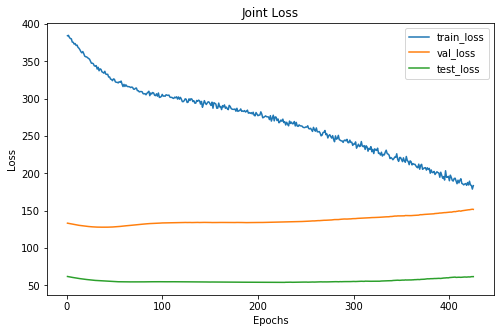

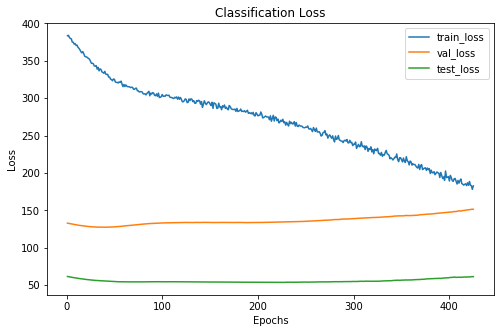

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
15  24   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      142     42      21
 1      145     50      23
 2       69     28      12
xxxxxxxxxxxxxx epoch: 125 xxxxxxxxxxxxxx


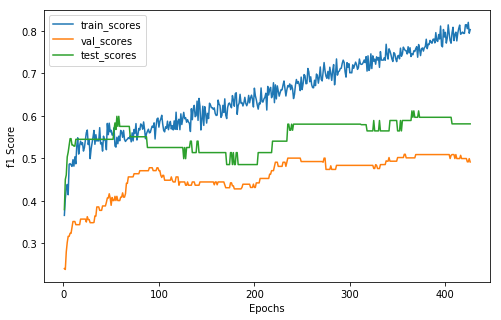

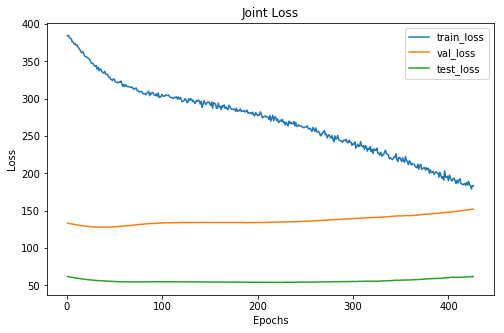

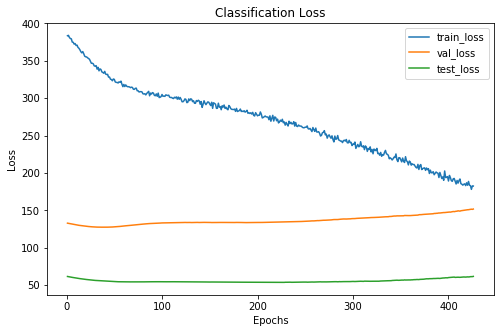

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
16  23   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      145     43      21
 1      140     49      23
 2       71     28      12
xxxxxxxxxxxxxx epoch: 126 xxxxxxxxxxxxxx


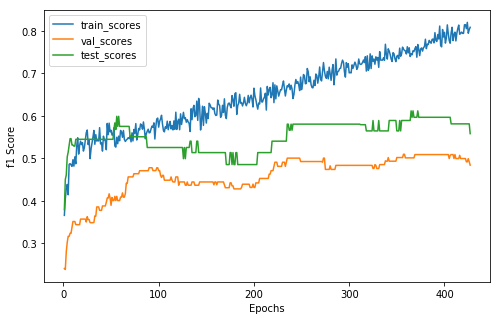

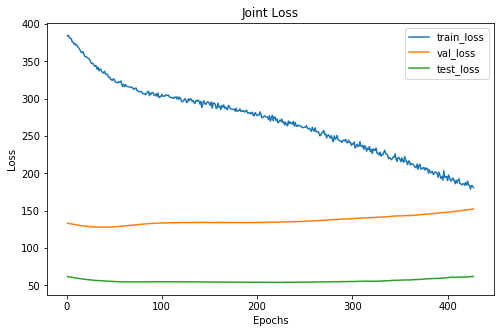

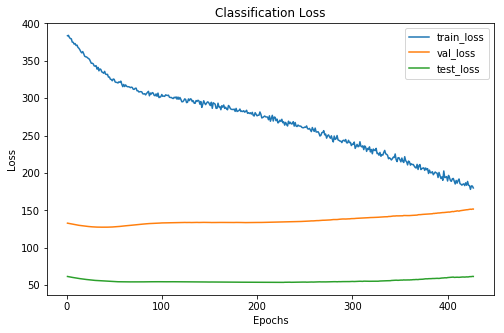

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  23   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     42      21
 1      144     50      24
 2       69     28      11
xxxxxxxxxxxxxx epoch: 127 xxxxxxxxxxxxxx


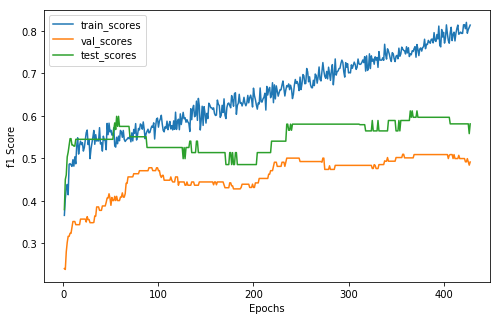

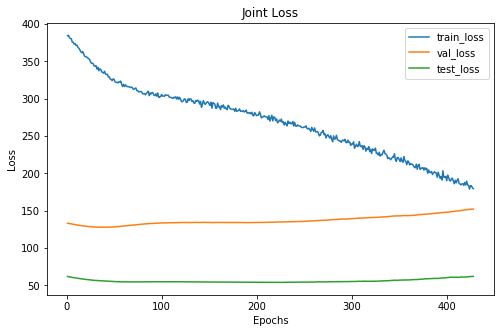

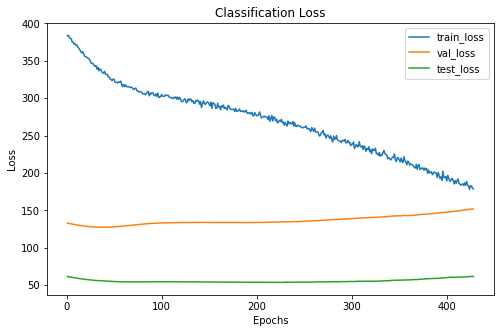

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
16  23   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      144     43      21
 1      145     49      23
 2       67     28      12
xxxxxxxxxxxxxx epoch: 128 xxxxxxxxxxxxxx


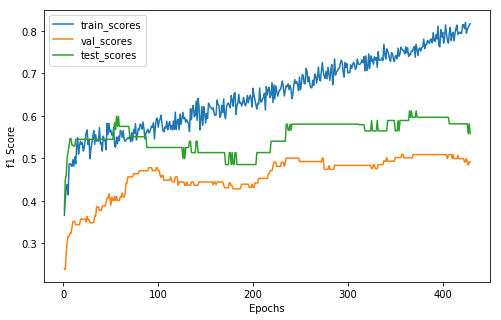

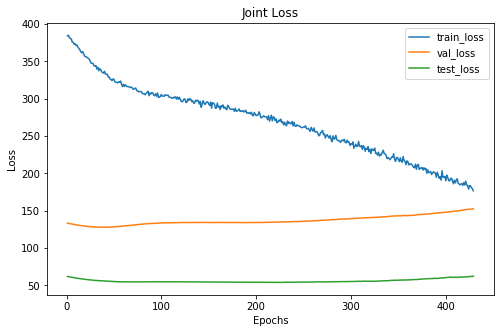

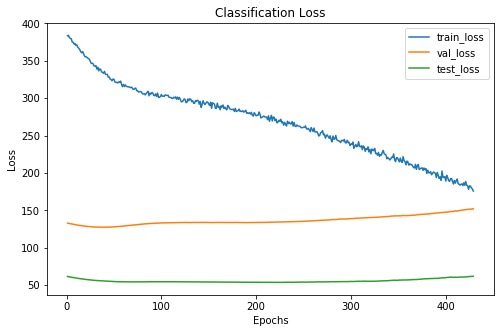

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
16  23   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     43      21
 1      146     49      24
 2       70     28      11
xxxxxxxxxxxxxx epoch: 129 xxxxxxxxxxxxxx


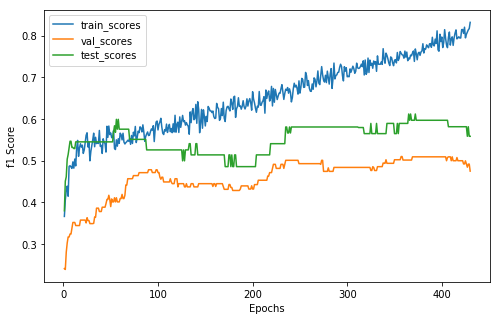

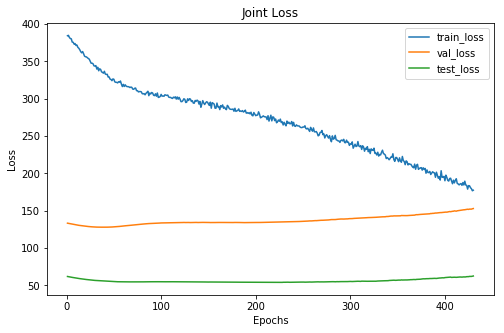

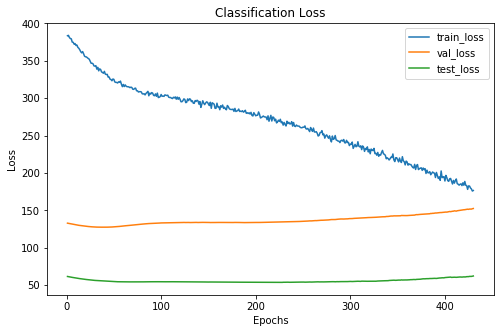

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  23   7
 8  17  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      134     42      21
 1      145     51      24
 2       77     27      11
xxxxxxxxxxxxxx epoch: 130 xxxxxxxxxxxxxx


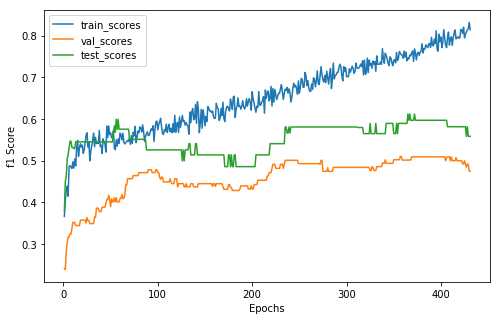

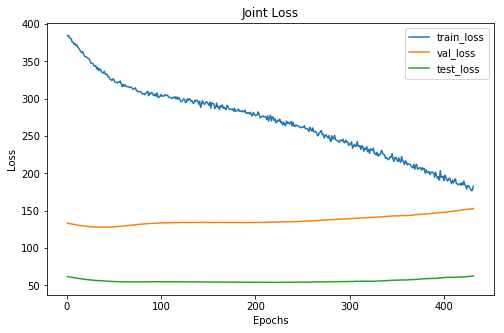

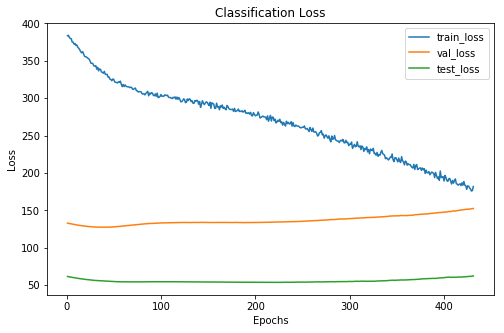

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  23   7
 8  17  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      135     42      21
 1      154     51      24
 2       67     27      11
xxxxxxxxxxxxxx epoch: 131 xxxxxxxxxxxxxx


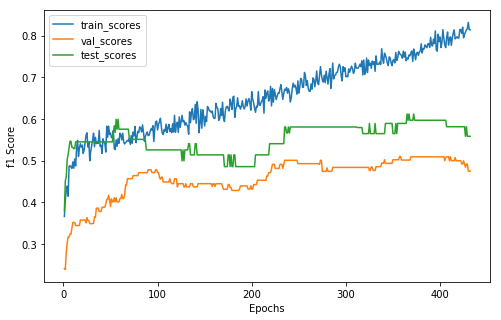

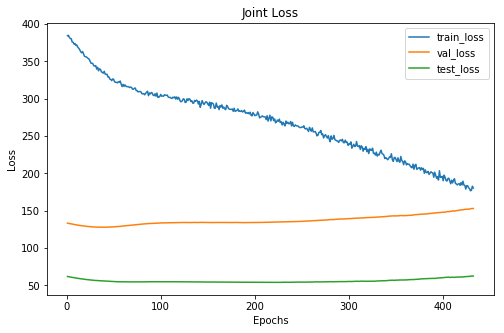

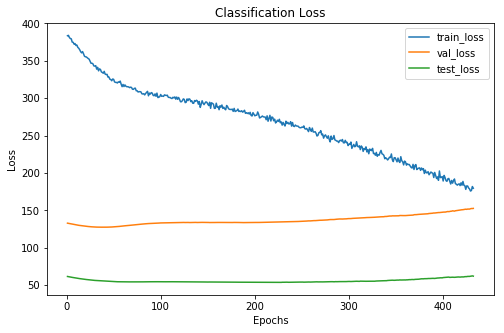

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  23   7
 8  17  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      137     42      21
 1      150     51      24
 2       69     27      11
xxxxxxxxxxxxxx epoch: 132 xxxxxxxxxxxxxx


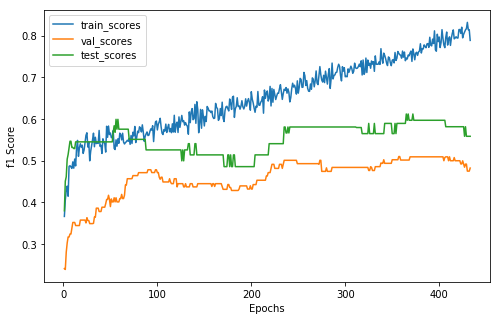

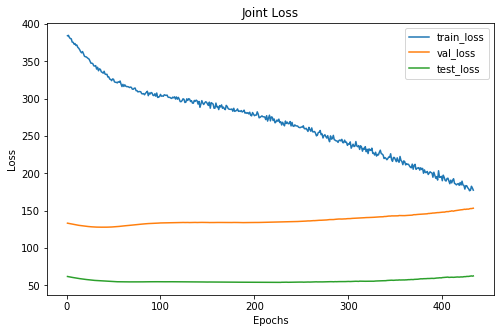

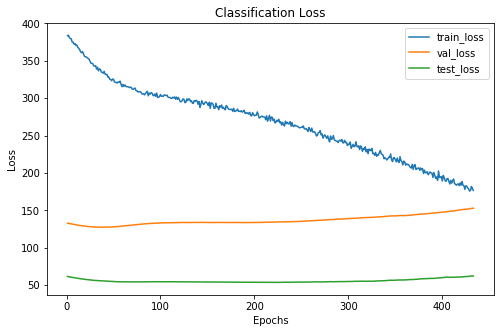

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
16  23   7
 8  17  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      142     43      21
 1      145     50      24
 2       69     27      11
xxxxxxxxxxxxxx epoch: 133 xxxxxxxxxxxxxx


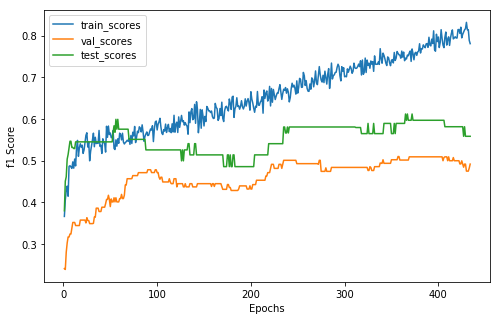

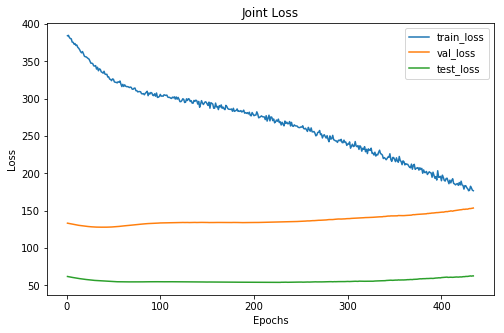

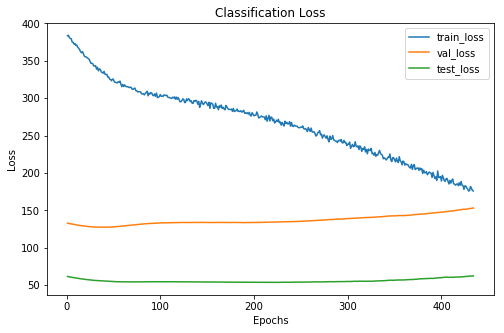

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
16  23   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      139     43      21
 1      145     49      24
 2       72     28      11
xxxxxxxxxxxxxx epoch: 134 xxxxxxxxxxxxxx


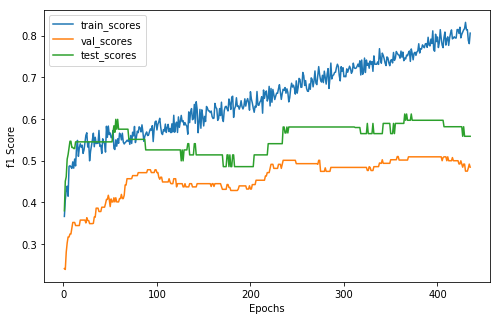

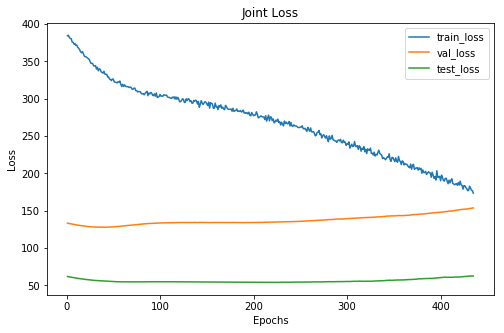

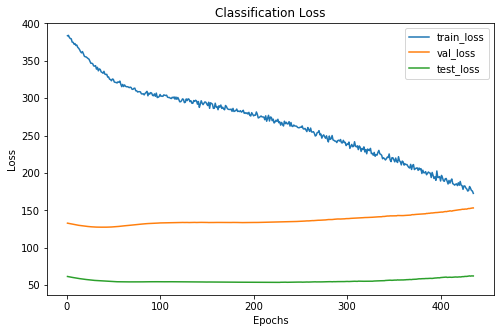

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  23   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      139     42      21
 1      145     50      24
 2       72     28      11
xxxxxxxxxxxxxx epoch: 135 xxxxxxxxxxxxxx


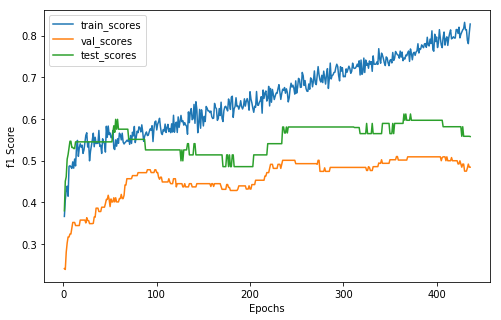

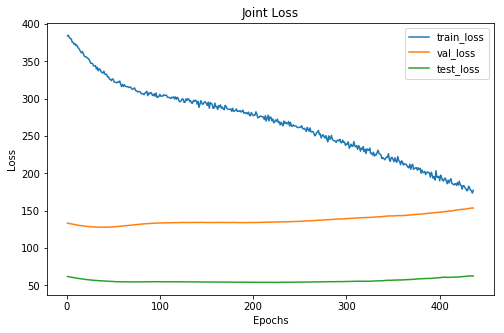

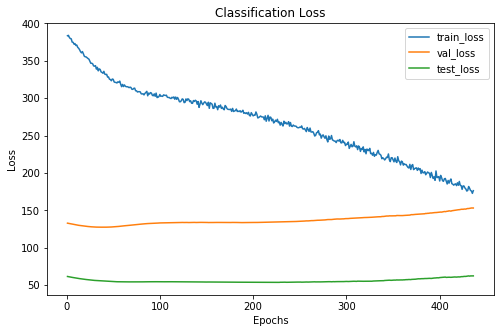

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  23   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      144     42      20
 1      147     50      25
 2       65     28      11
xxxxxxxxxxxxxx epoch: 136 xxxxxxxxxxxxxx


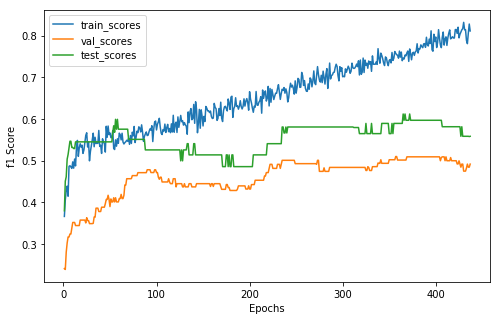

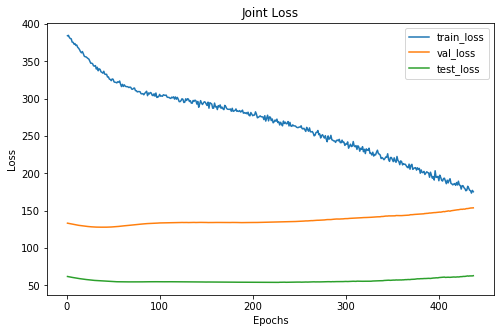

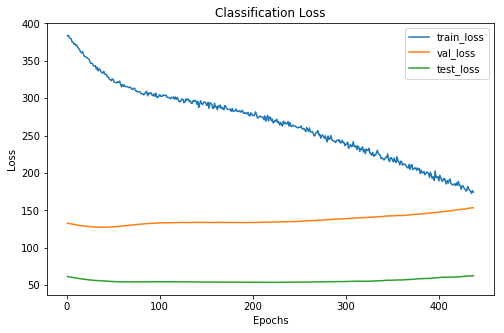

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
16  23   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     43      21
 1      146     49      24
 2       70     28      11
xxxxxxxxxxxxxx epoch: 137 xxxxxxxxxxxxxx


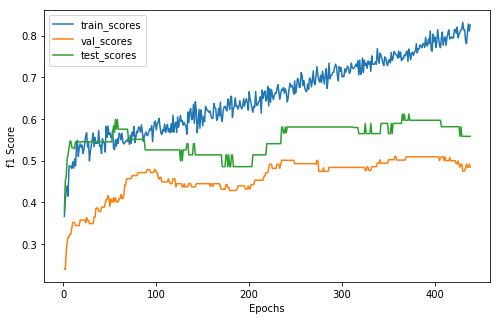

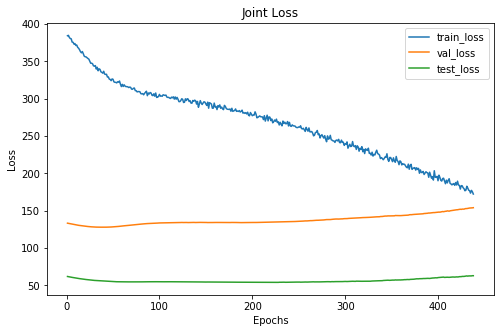

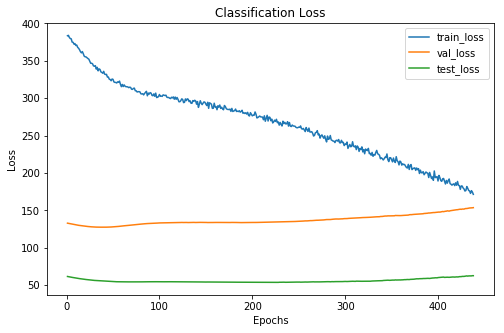

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  23   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     42      21
 1      145     50      24
 2       71     28      11
xxxxxxxxxxxxxx epoch: 138 xxxxxxxxxxxxxx


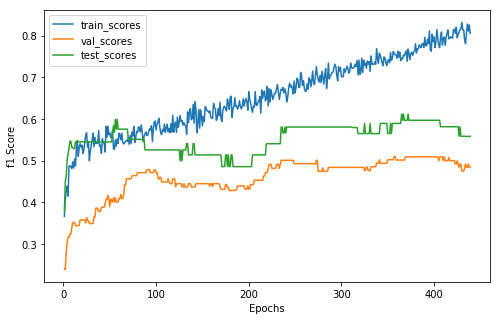

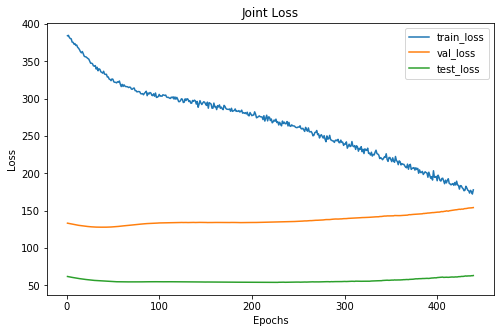

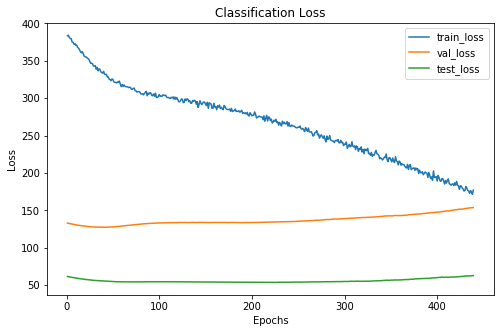

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  23   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      137     42      21
 1      155     50      24
 2       64     28      11
xxxxxxxxxxxxxx epoch: 139 xxxxxxxxxxxxxx


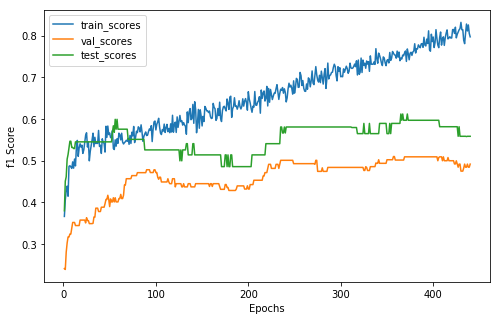

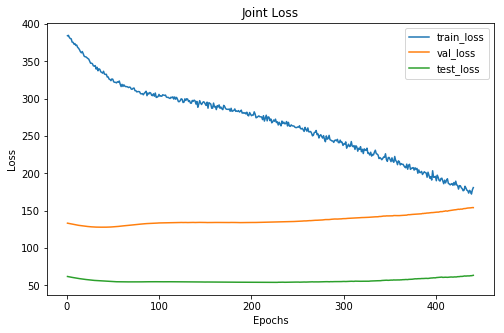

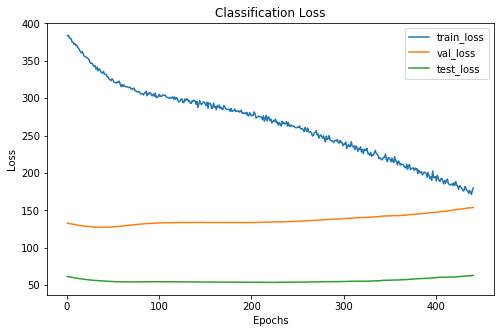

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
16  23   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      141     43      21
 1      147     49      24
 2       68     28      11
xxxxxxxxxxxxxx epoch: 140 xxxxxxxxxxxxxx


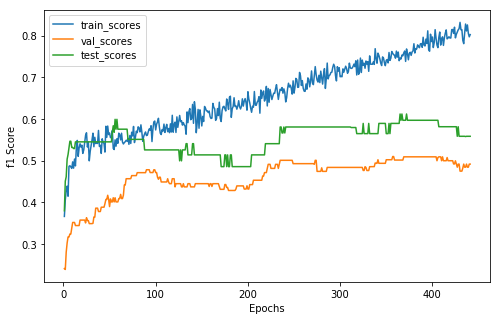

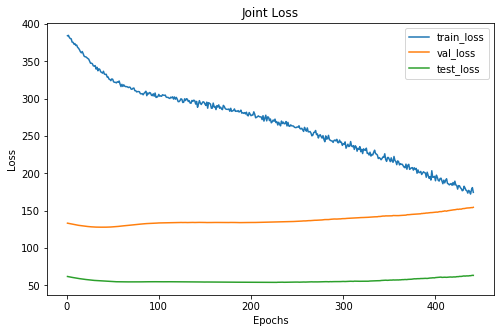

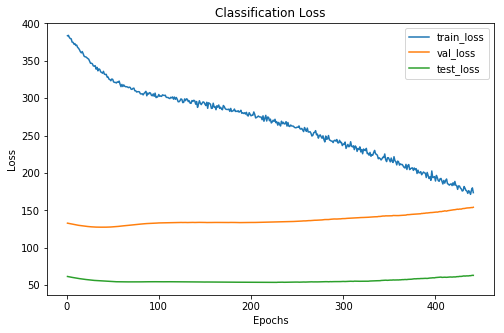

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
16  23   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      146     43      21
 1      141     49      24
 2       69     28      11
xxxxxxxxxxxxxx epoch: 141 xxxxxxxxxxxxxx


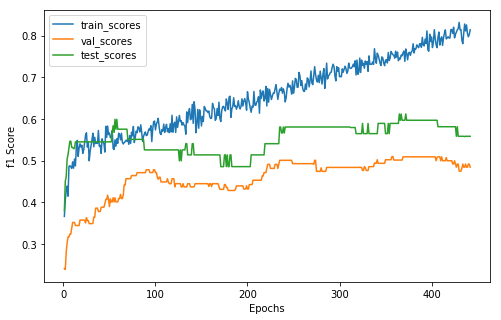

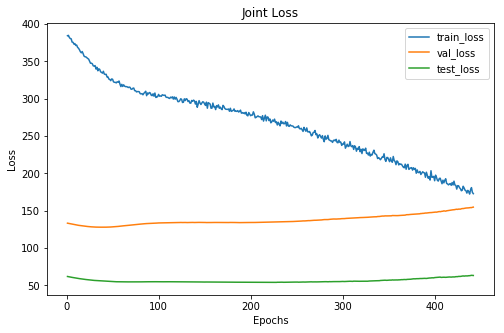

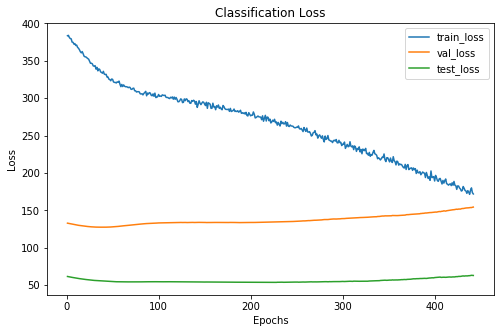

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  23   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      145     42      21
 1      145     50      24
 2       66     28      11
xxxxxxxxxxxxxx epoch: 142 xxxxxxxxxxxxxx


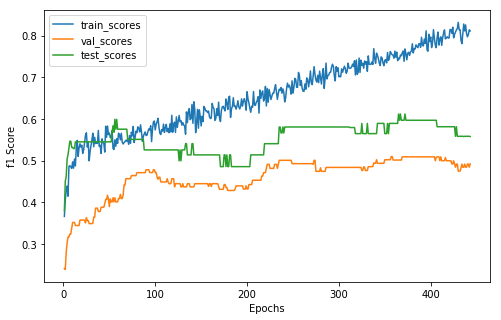

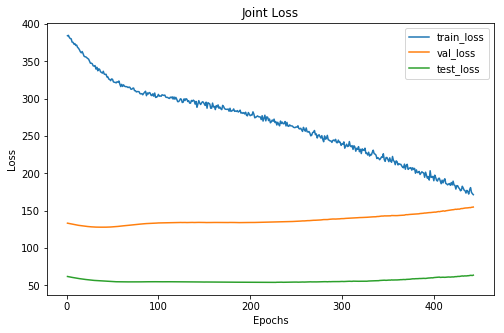

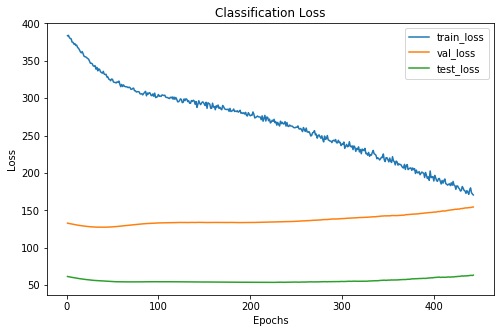

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  24   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      141     41      20
 1      148     51      25
 2       67     28      11
xxxxxxxxxxxxxx epoch: 143 xxxxxxxxxxxxxx


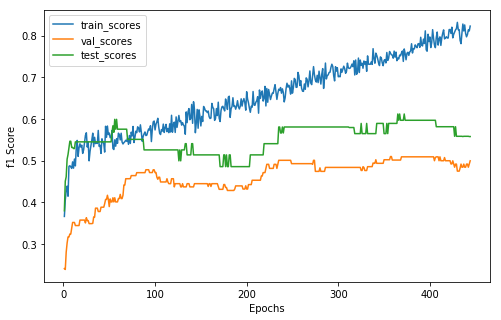

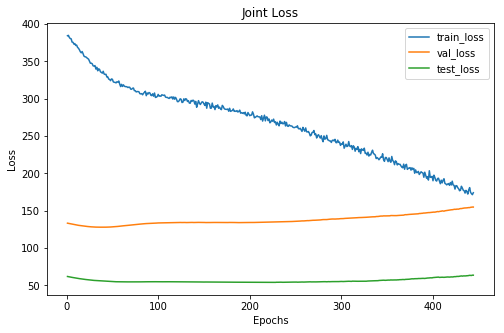

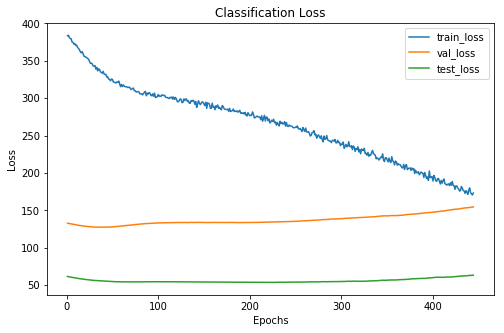

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
15  24   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      135     42      20
 1      152     50      25
 2       69     28      11
xxxxxxxxxxxxxx epoch: 144 xxxxxxxxxxxxxx


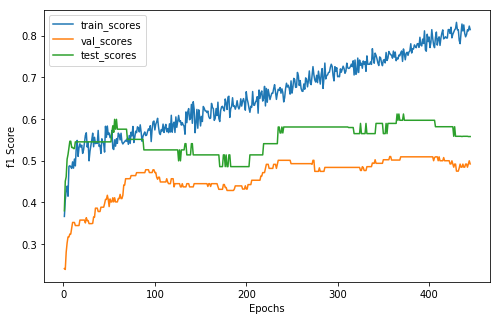

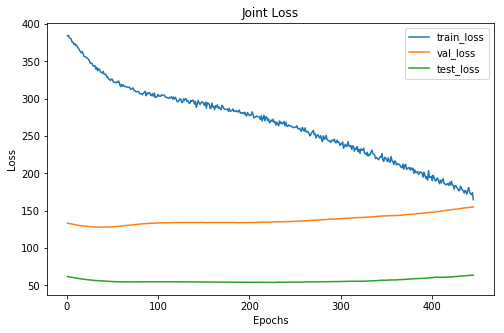

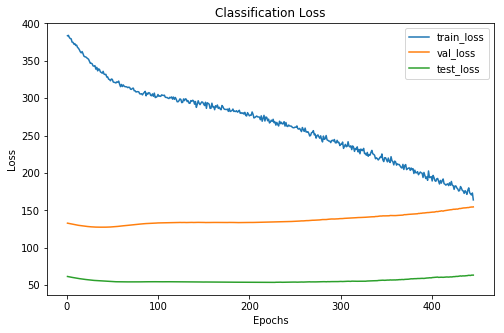

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  24   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     41      20
 1      145     51      25
 2       71     28      11
xxxxxxxxxxxxxx epoch: 145 xxxxxxxxxxxxxx


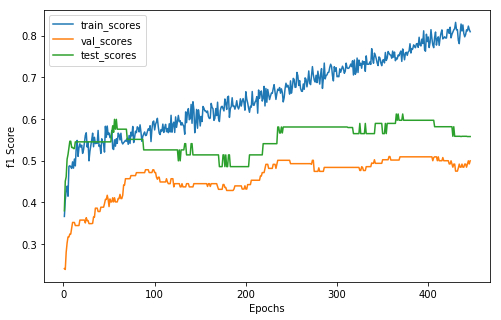

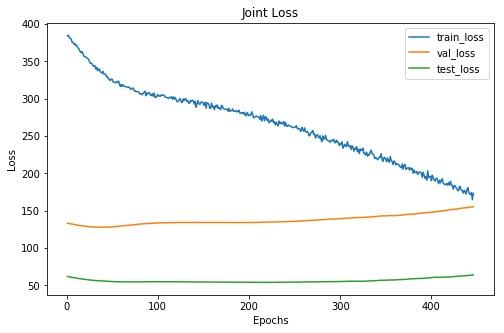

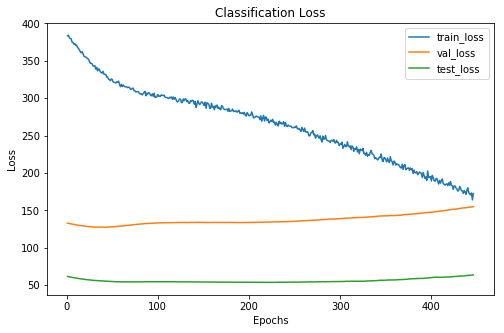

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
15  24   7
 8  16  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      134     42      20
 1      143     50      25
 2       79     28      11
xxxxxxxxxxxxxx epoch: 146 xxxxxxxxxxxxxx


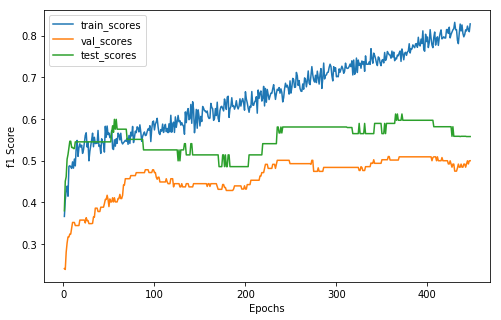

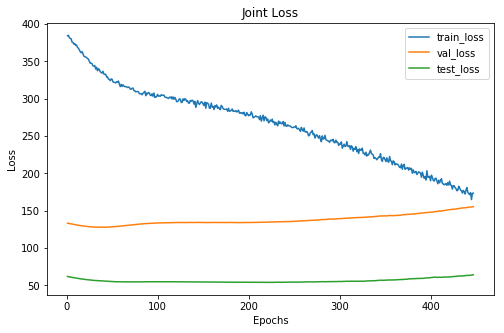

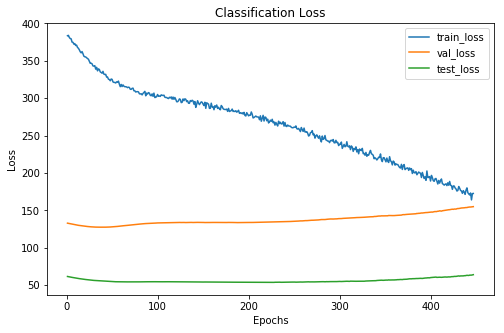

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
15  24   7
 9  15  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      144     43      20
 1      145     49      25
 2       67     28      11
xxxxxxxxxxxxxx epoch: 147 xxxxxxxxxxxxxx


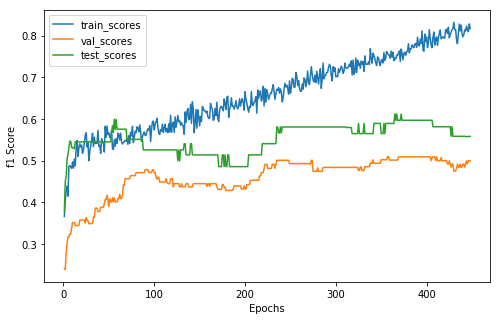

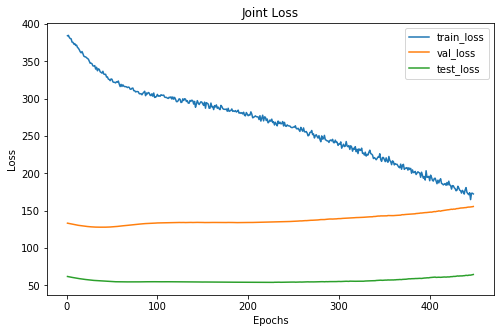

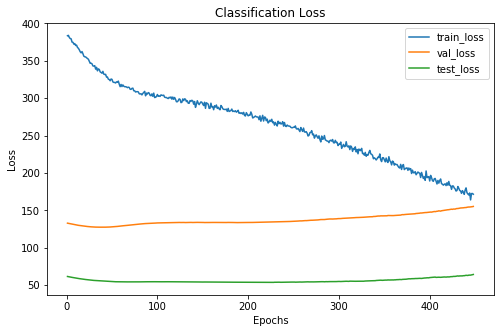

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
15  24   7
 9  15  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      134     43      21
 1      153     49      24
 2       69     28      11
xxxxxxxxxxxxxx epoch: 148 xxxxxxxxxxxxxx


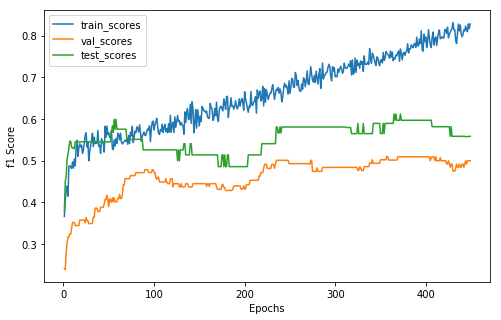

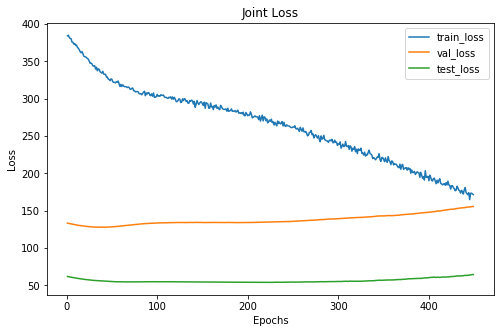

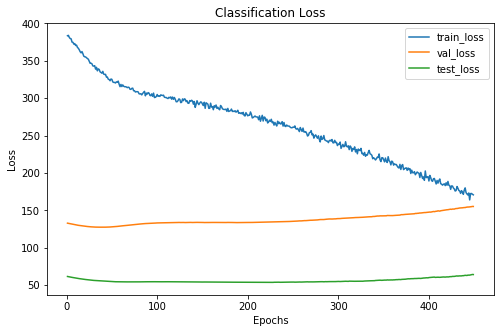

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
15  24   7
 9  15  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      145     43      21
 1      145     49      24
 2       66     28      11
xxxxxxxxxxxxxx epoch: 149 xxxxxxxxxxxxxx


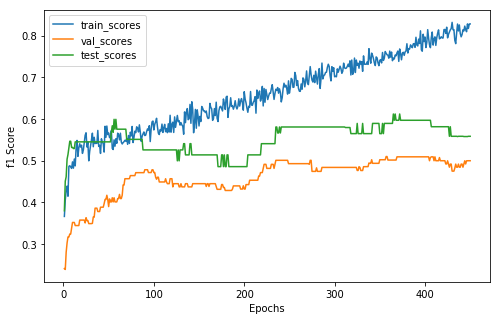

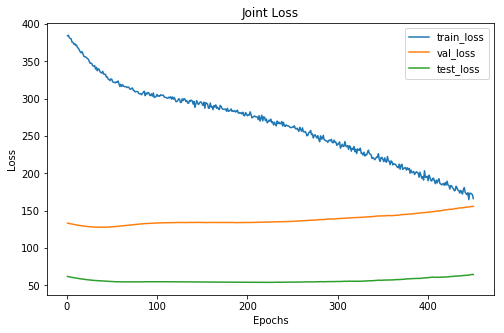

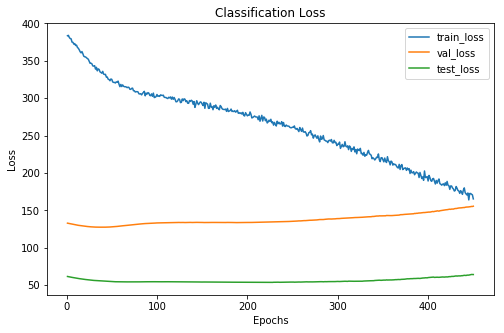

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
15  24   7
 9  15  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      142     43      21
 1      147     49      24
 2       67     28      11
xxxxxxxxxxxxxx epoch: 150 xxxxxxxxxxxxxx


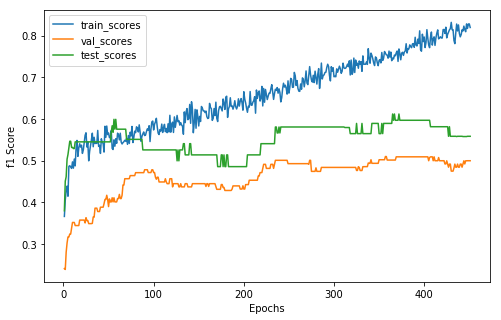

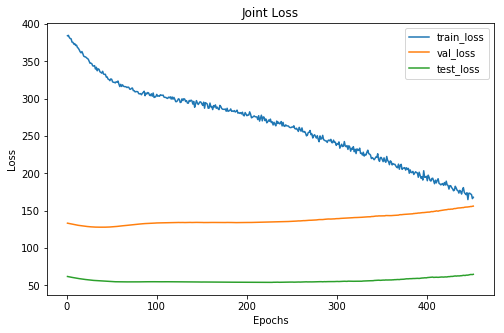

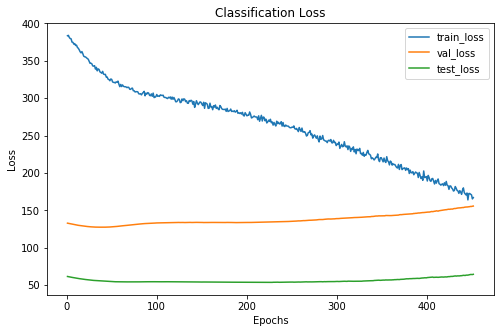

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
15  24   7
 9  15  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      145     43      21
 1      146     49      24
 2       65     28      11
xxxxxxxxxxxxxx epoch: 151 xxxxxxxxxxxxxx


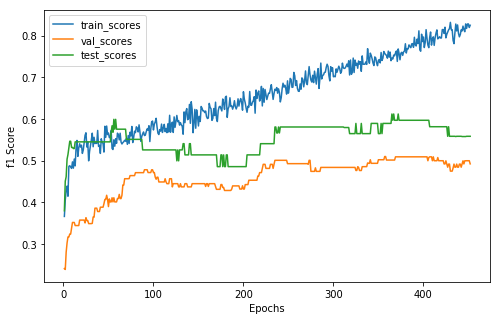

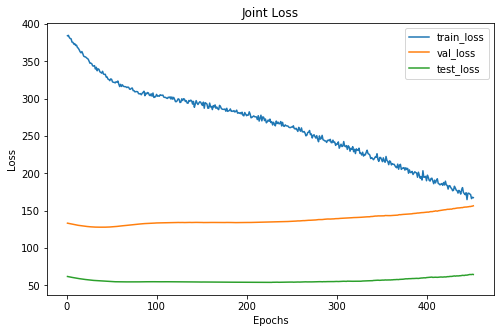

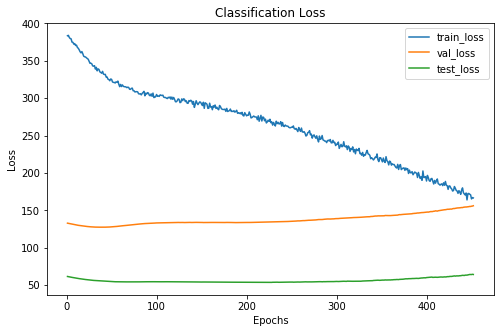

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  24   7
 9  15  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      142     42      21
 1      150     50      24
 2       64     28      11
xxxxxxxxxxxxxx epoch: 152 xxxxxxxxxxxxxx


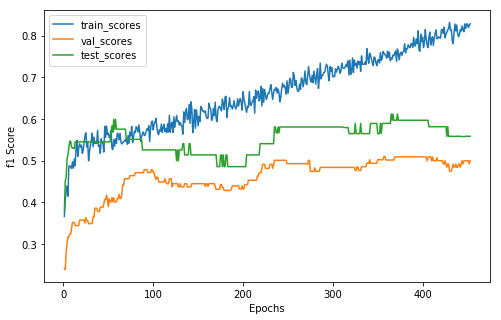

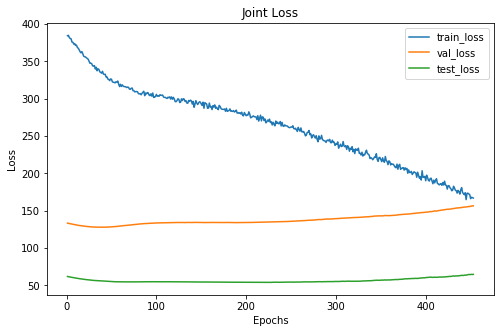

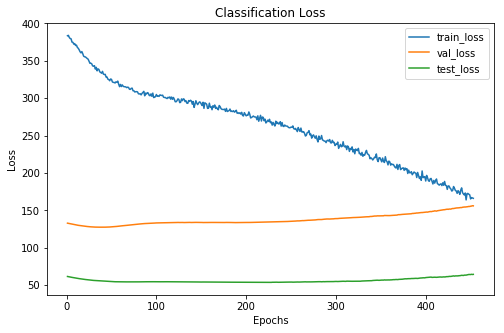

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
15  24   7
 9  15  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      142     43      21
 1      142     49      24
 2       72     28      11
xxxxxxxxxxxxxx epoch: 153 xxxxxxxxxxxxxx


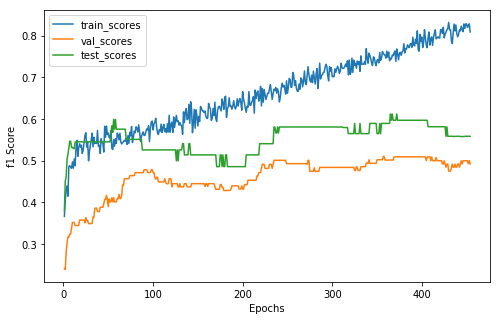

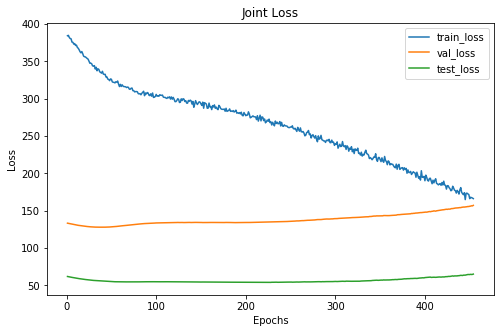

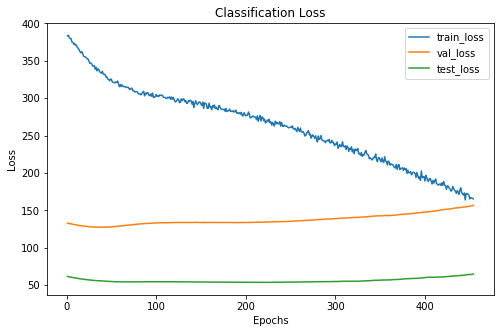

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  24   7
 9  15  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     42      21
 1      144     50      24
 2       72     28      11
xxxxxxxxxxxxxx epoch: 154 xxxxxxxxxxxxxx


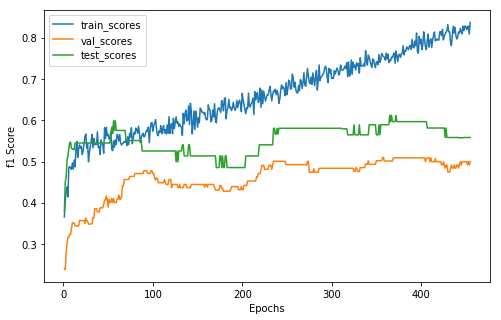

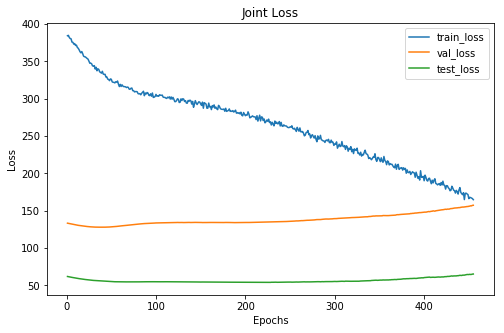

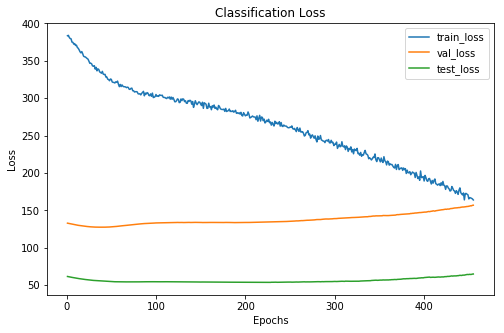

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
15  24   7
 9  15  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      133     43      21
 1      154     49      24
 2       69     28      11
xxxxxxxxxxxxxx epoch: 155 xxxxxxxxxxxxxx


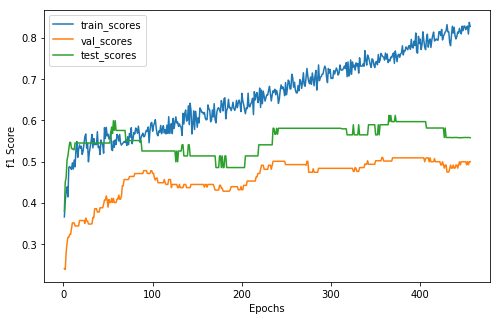

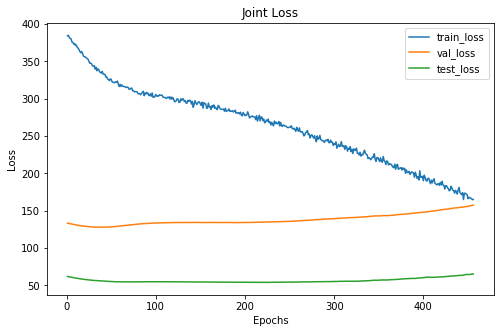

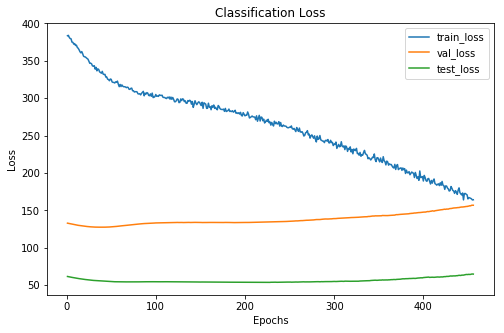

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
15  24   7
 9  15  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      147     43      20
 1      146     49      25
 2       63     28      11
xxxxxxxxxxxxxx epoch: 156 xxxxxxxxxxxxxx


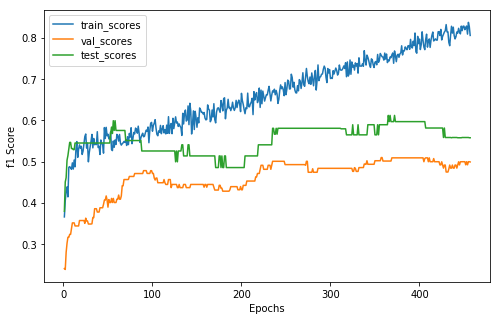

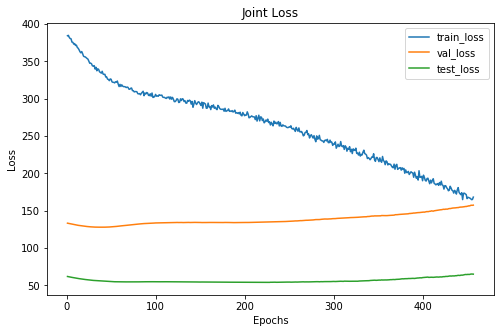

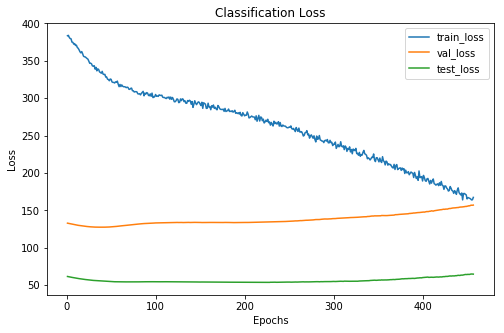

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
14  24   8
 9  15  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      141     42      20
 1      145     49      25
 2       70     29      11
xxxxxxxxxxxxxx epoch: 157 xxxxxxxxxxxxxx


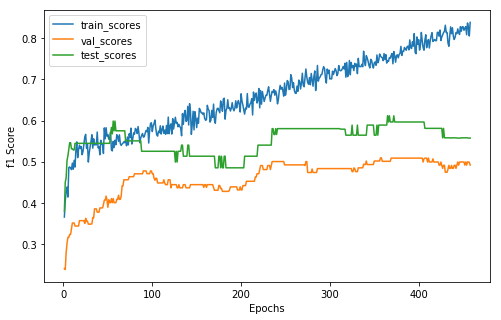

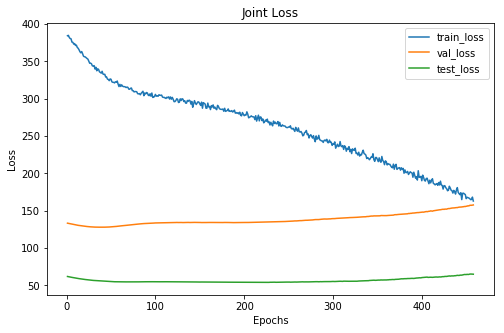

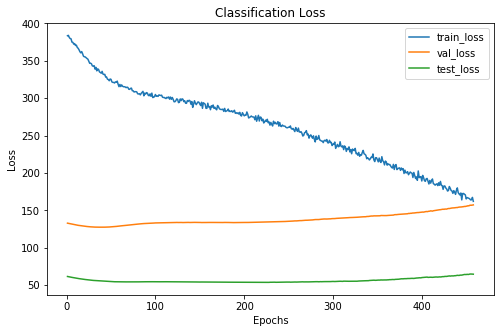

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  24   7
 9  15  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     42      20
 1      155     50      25
 2       61     28      11
xxxxxxxxxxxxxx epoch: 158 xxxxxxxxxxxxxx


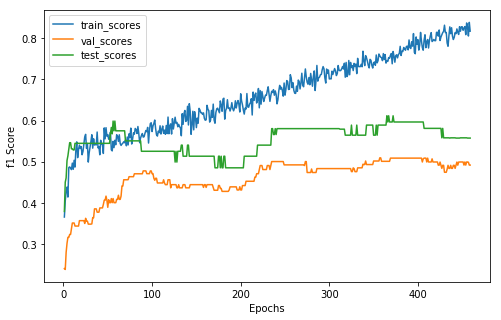

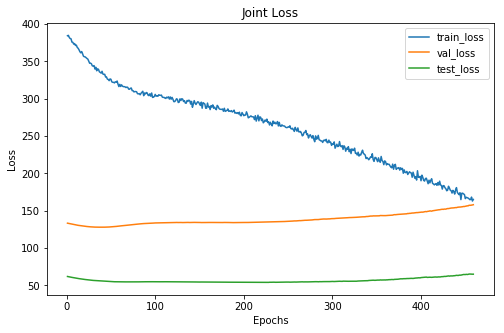

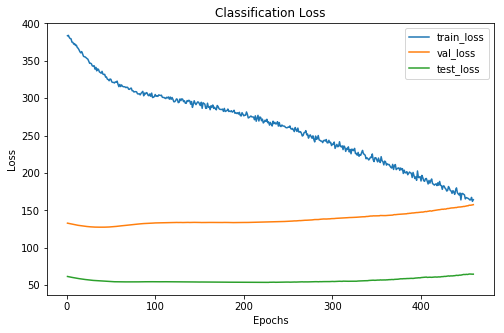

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  24   7
 9  15  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      139     42      20
 1      144     50      25
 2       73     28      11
xxxxxxxxxxxxxx epoch: 159 xxxxxxxxxxxxxx


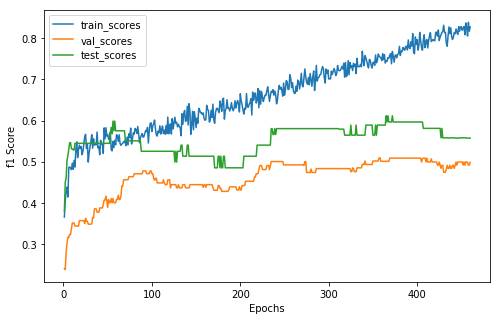

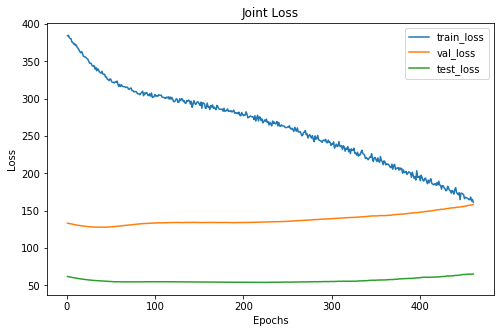

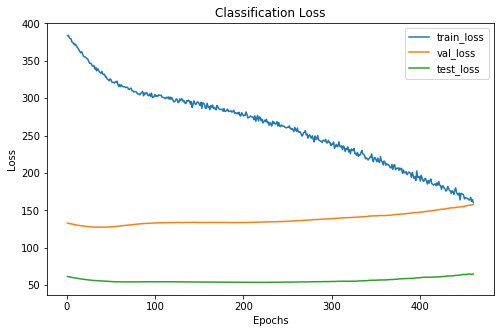

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
14  24   8
 9  15  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      145     42      20
 1      147     49      25
 2       64     29      11
xxxxxxxxxxxxxx epoch: 160 xxxxxxxxxxxxxx


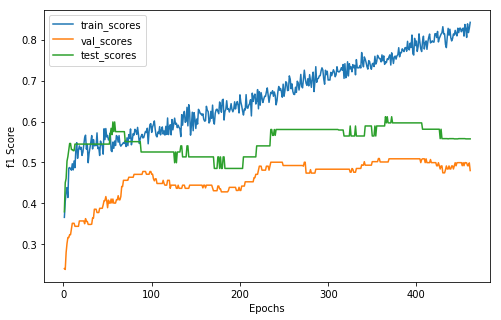

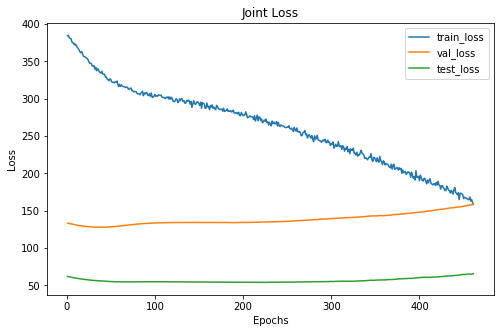

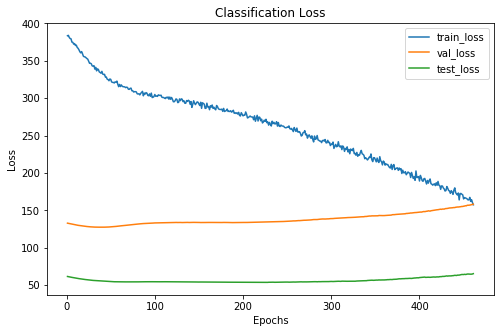

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
15  24   7
 9  17  15
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      137     43      20
 1      152     51      25
 2       67     26      11
xxxxxxxxxxxxxx epoch: 161 xxxxxxxxxxxxxx


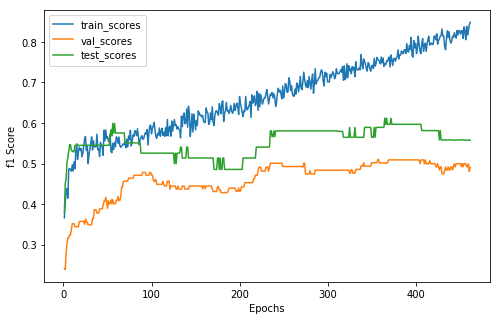

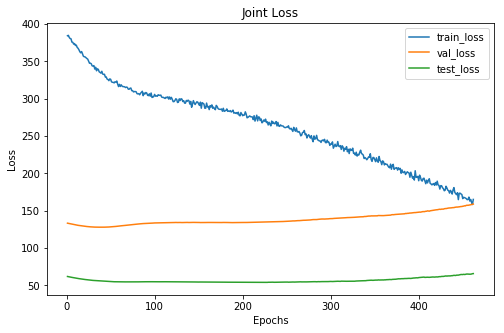

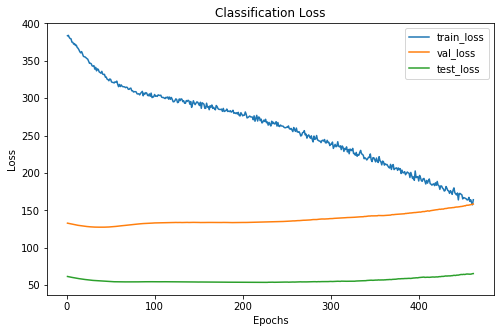

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
15  24   7
 9  16  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      136     43      20
 1      146     50      25
 2       74     27      11
xxxxxxxxxxxxxx epoch: 162 xxxxxxxxxxxxxx


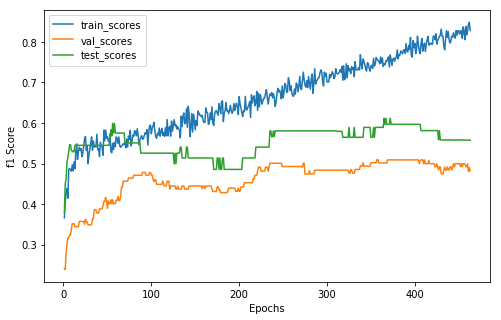

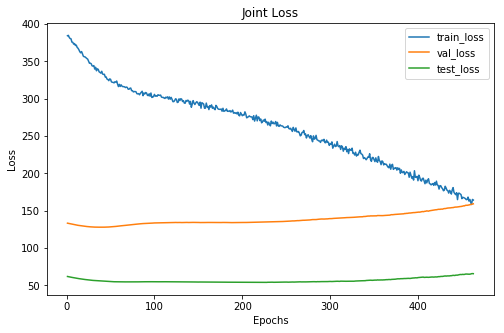

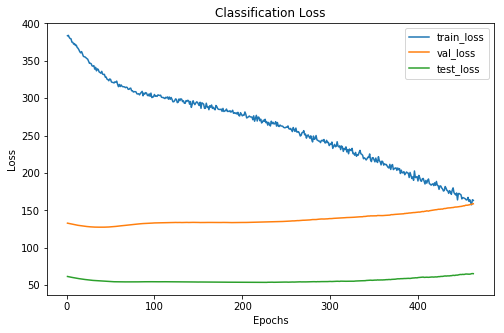

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  24   7
 9  16  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     42      20
 1      144     51      25
 2       69     27      11
xxxxxxxxxxxxxx epoch: 163 xxxxxxxxxxxxxx


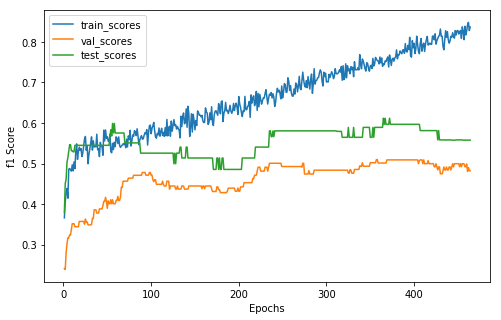

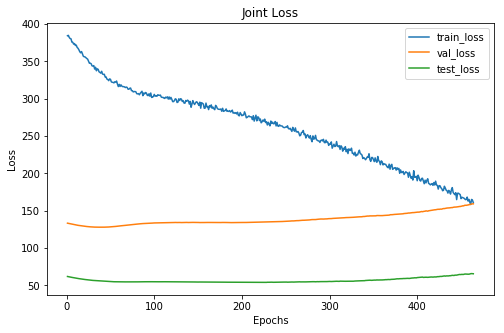

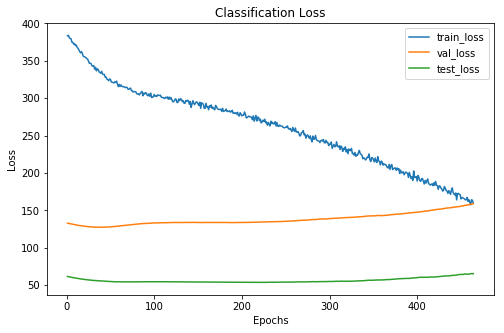

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  24   8
 9  16  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      137     41      20
 1      149     51      25
 2       70     28      11
xxxxxxxxxxxxxx epoch: 164 xxxxxxxxxxxxxx


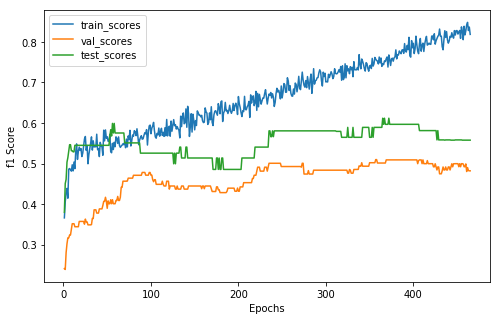

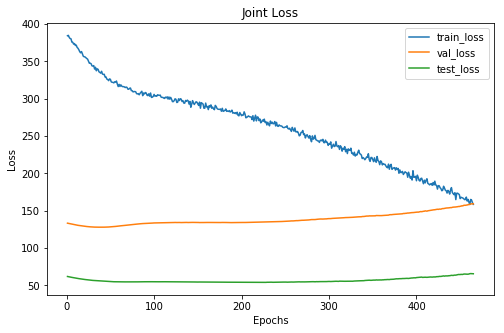

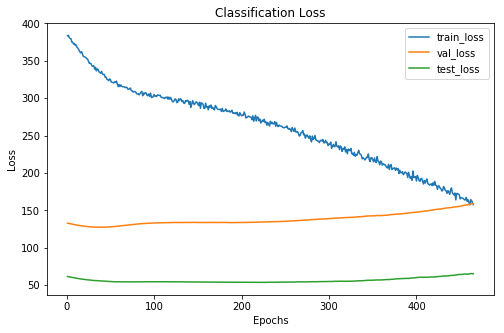

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  24   8
 9  16  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      147     41      20
 1      146     51      25
 2       63     28      11
xxxxxxxxxxxxxx epoch: 165 xxxxxxxxxxxxxx


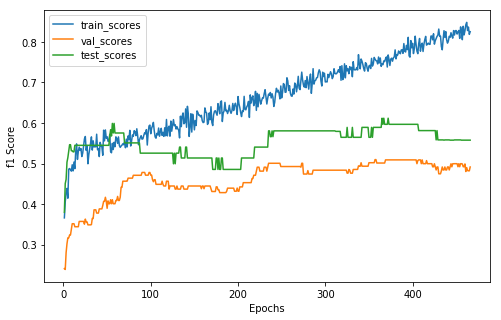

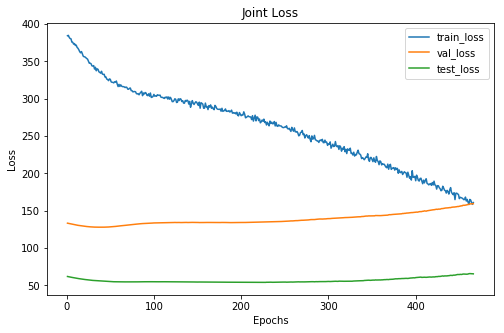

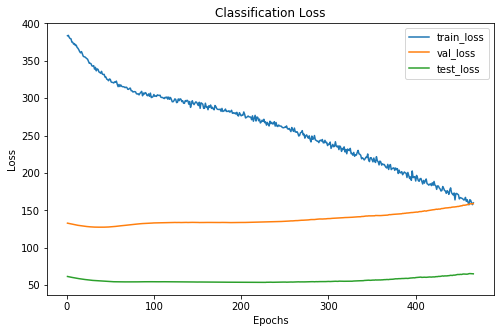

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  24   8
 9  15  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      141     41      20
 1      147     50      25
 2       68     29      11
xxxxxxxxxxxxxx epoch: 166 xxxxxxxxxxxxxx


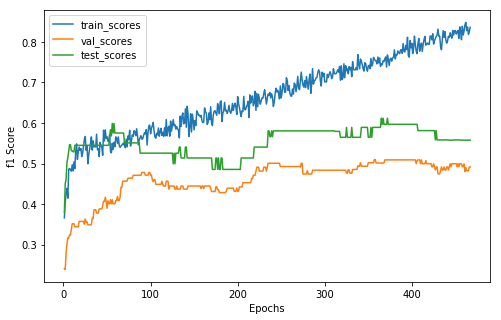

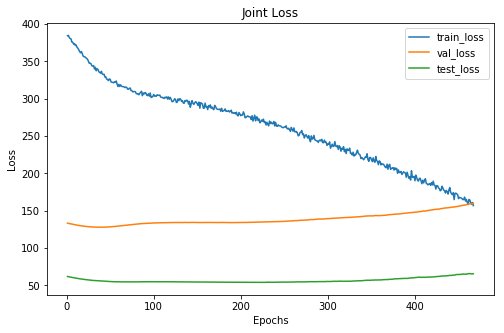

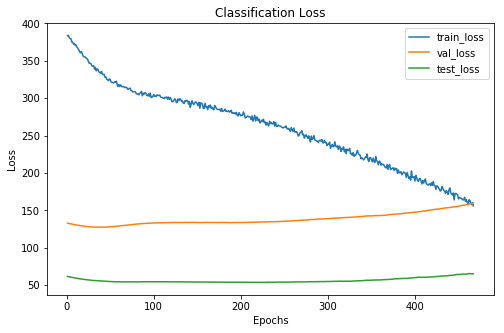

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  24   8
 9  15  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     41      20
 1      153     50      25
 2       63     29      11
xxxxxxxxxxxxxx epoch: 167 xxxxxxxxxxxxxx


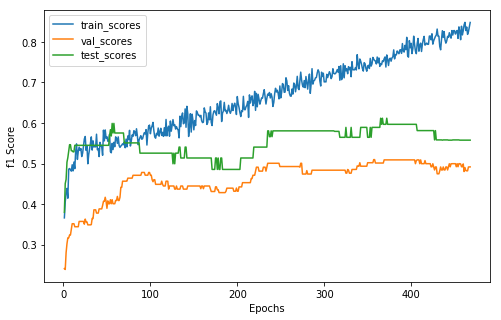

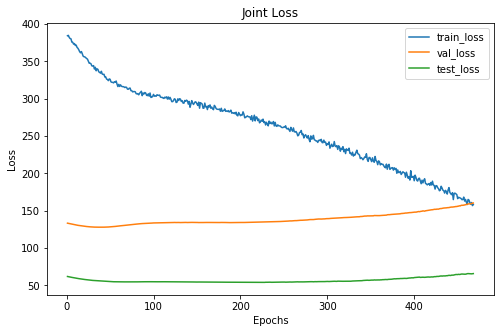

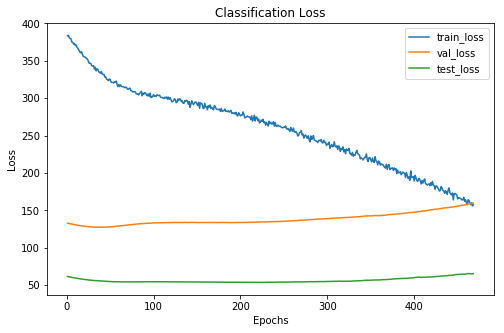

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  24   8
10  14  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      138     42      20
 1      148     49      25
 2       70     29      11
xxxxxxxxxxxxxx epoch: 168 xxxxxxxxxxxxxx


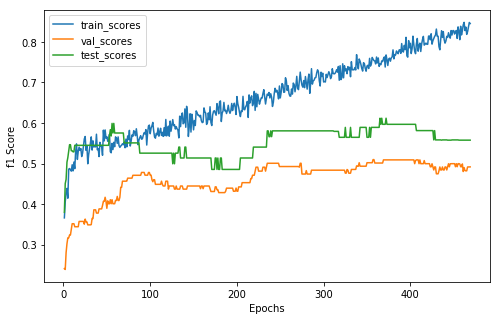

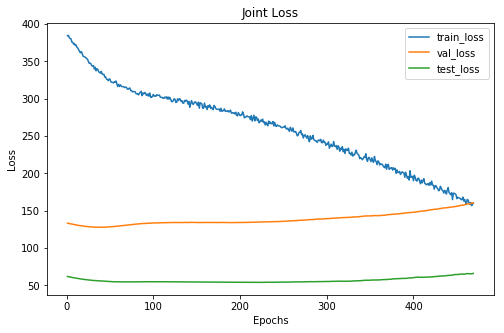

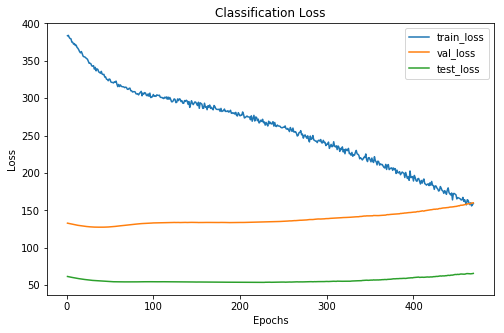

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  24   8
10  14  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      132     42      20
 1      155     49      25
 2       69     29      11
xxxxxxxxxxxxxx epoch: 169 xxxxxxxxxxxxxx


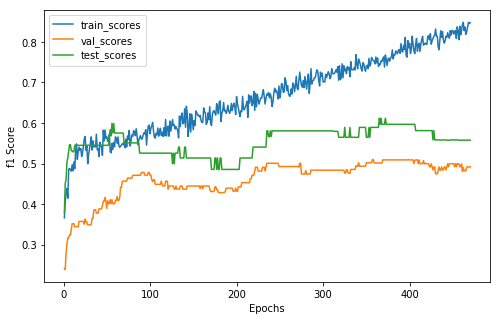

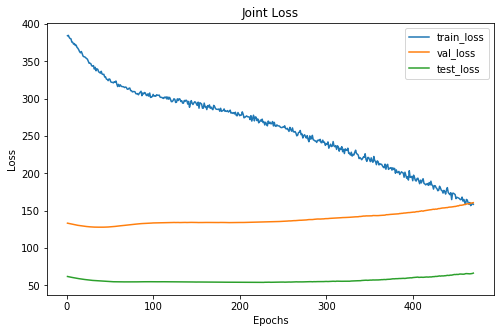

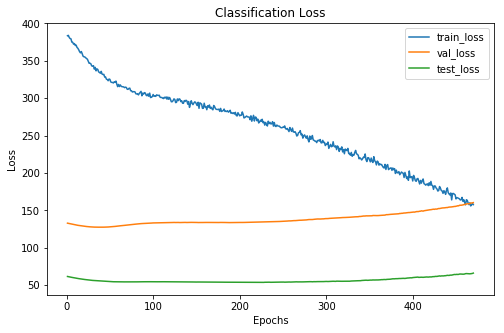

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  24   7
 9  15  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      136     42      20
 1      151     50      25
 2       69     28      11
xxxxxxxxxxxxxx epoch: 170 xxxxxxxxxxxxxx


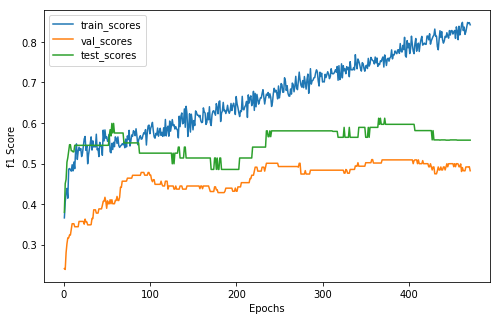

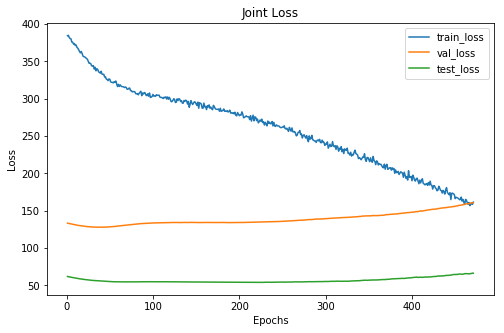

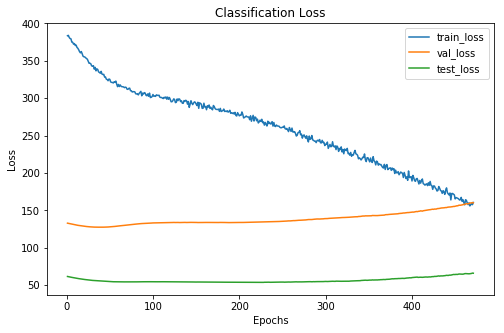

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  24   8
10  15  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      145     42      20
 1      139     50      25
 2       72     28      11
xxxxxxxxxxxxxx epoch: 171 xxxxxxxxxxxxxx


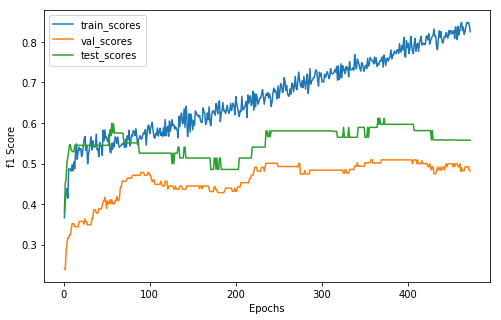

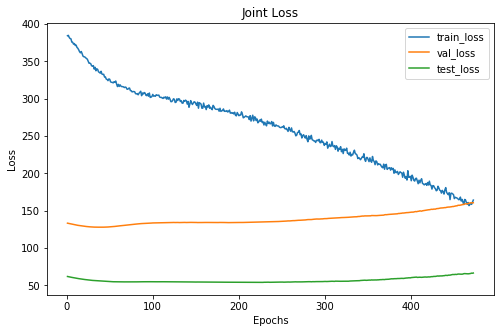

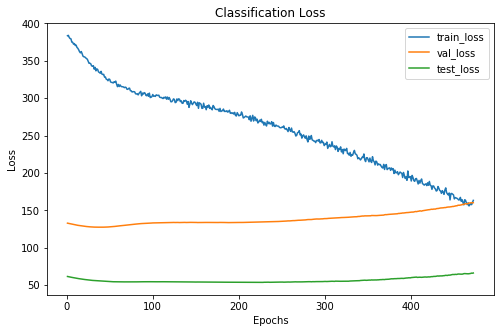

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  24   8
10  15  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      139     42      20
 1      150     50      25
 2       67     28      11
xxxxxxxxxxxxxx epoch: 172 xxxxxxxxxxxxxx


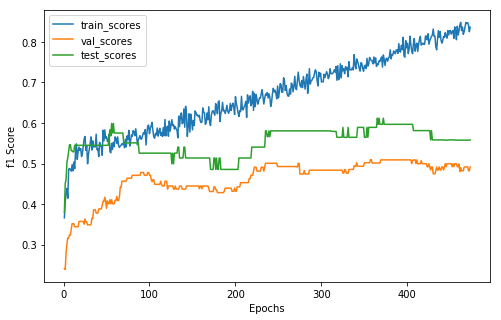

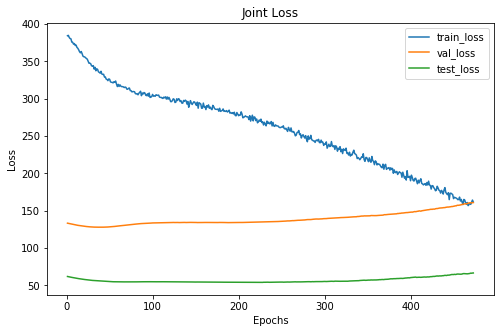

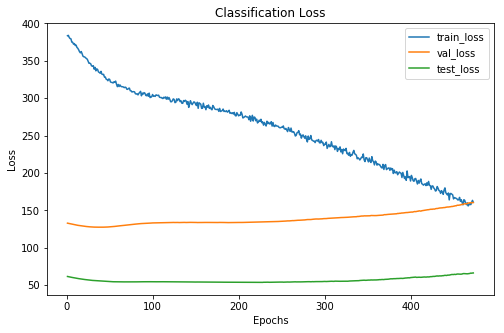

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  24   8
10  14  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      145     42      21
 1      141     49      24
 2       70     29      11
xxxxxxxxxxxxxx epoch: 173 xxxxxxxxxxxxxx


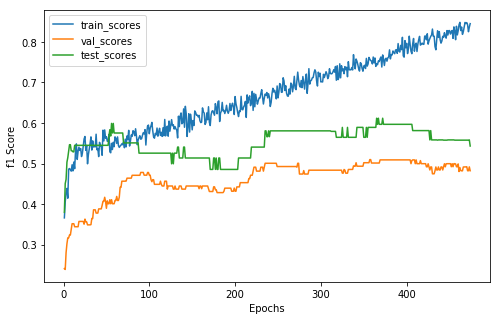

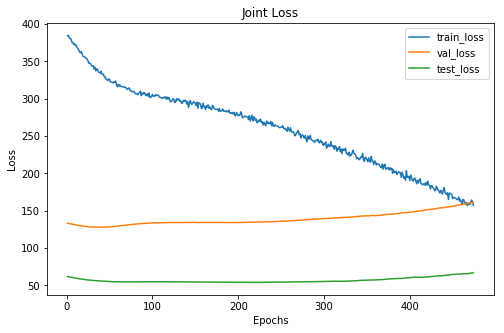

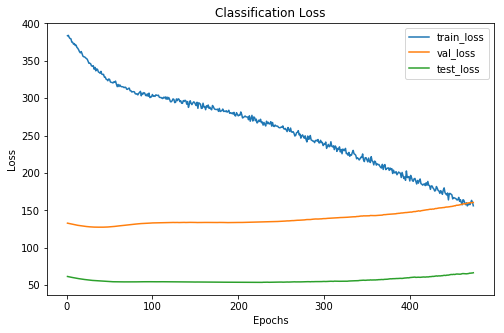

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  24   8
10  15  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     42      22
 1      143     50      23
 2       70     28      11
xxxxxxxxxxxxxx epoch: 174 xxxxxxxxxxxxxx


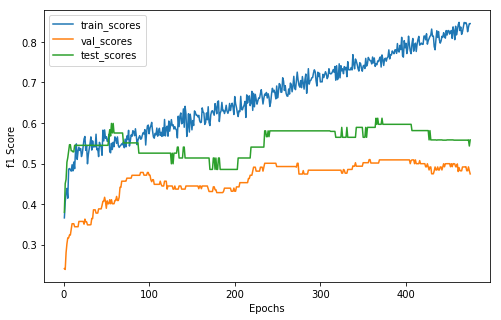

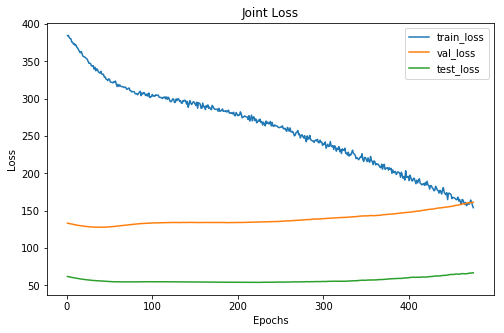

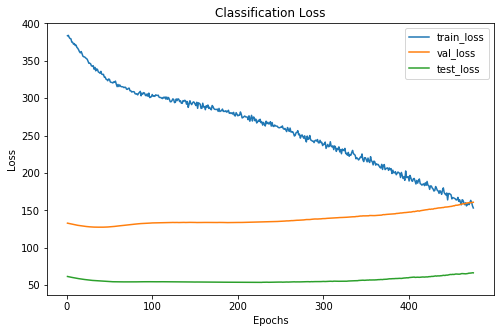

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  23   8
10  15  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      134     43      21
 1      155     49      24
 2       67     28      11
xxxxxxxxxxxxxx epoch: 175 xxxxxxxxxxxxxx


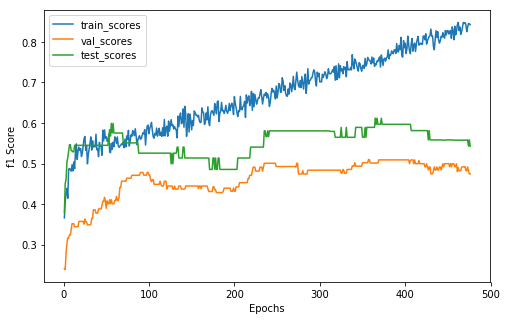

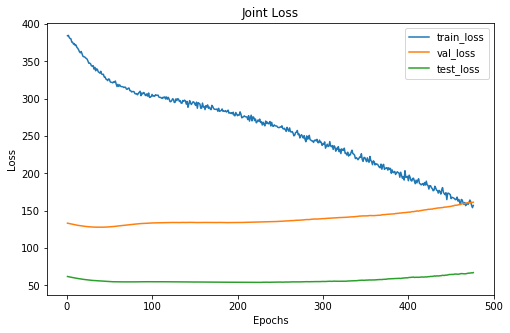

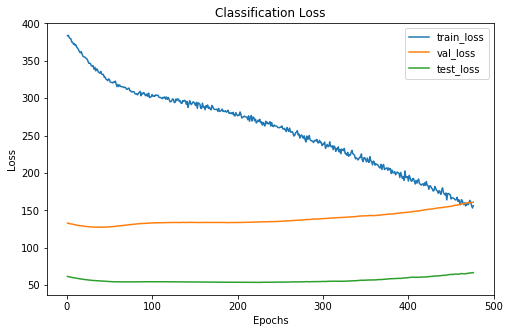

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  23   8
10  15  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      138     43      21
 1      149     49      24
 2       69     28      11
xxxxxxxxxxxxxx epoch: 176 xxxxxxxxxxxxxx


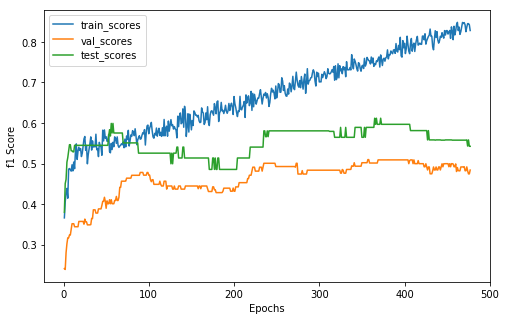

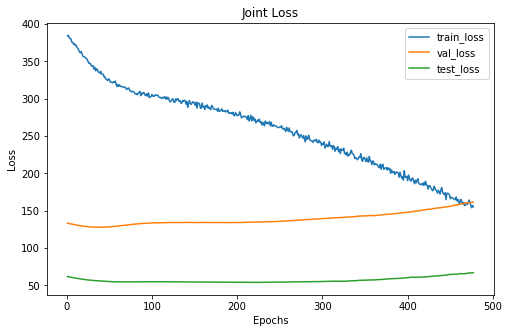

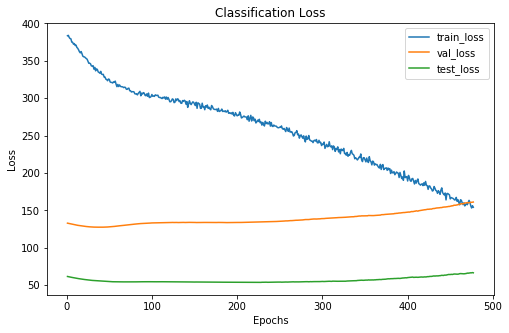

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  23   8
10  14  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      141     43      21
 1      147     48      24
 2       68     29      11
xxxxxxxxxxxxxx epoch: 177 xxxxxxxxxxxxxx


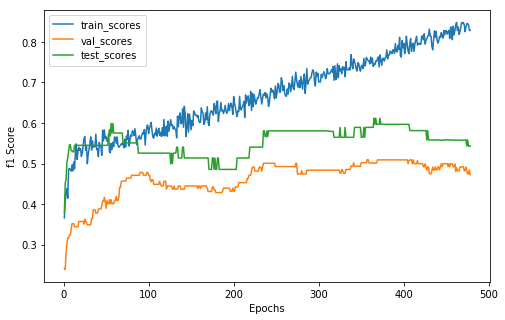

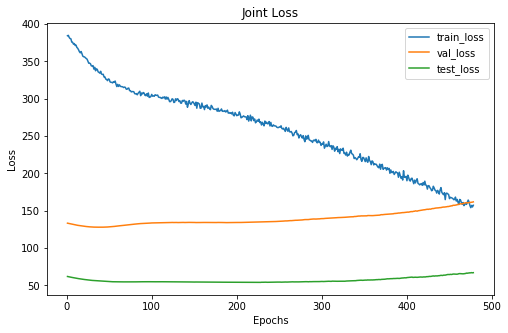

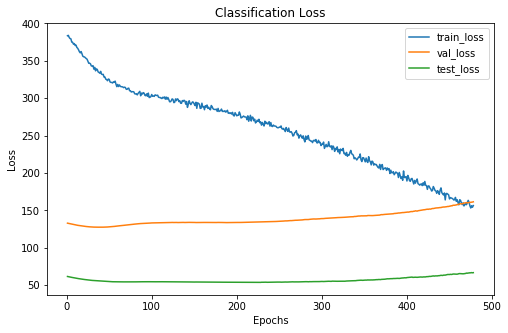

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  24   8
10  16  15
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     42      22
 1      143     51      23
 2       73     27      11
xxxxxxxxxxxxxx epoch: 178 xxxxxxxxxxxxxx


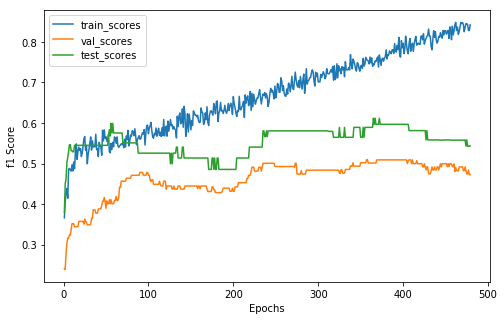

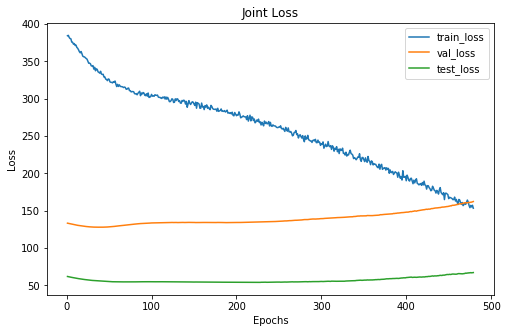

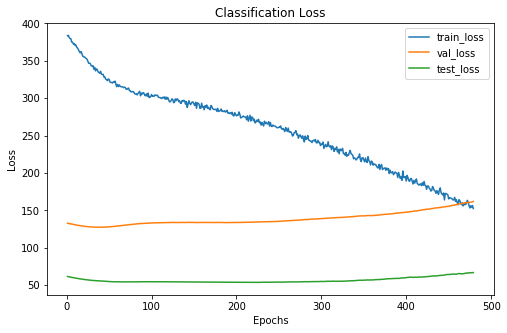

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  24   8
10  16  15
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     42      22
 1      142     51      23
 2       71     27      11
xxxxxxxxxxxxxx epoch: 179 xxxxxxxxxxxxxx


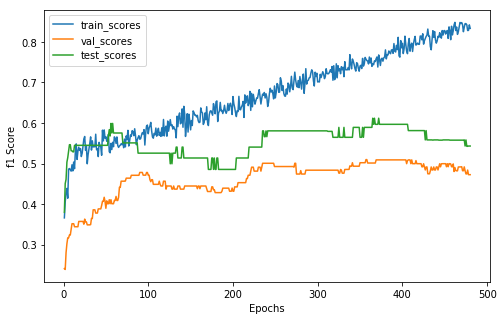

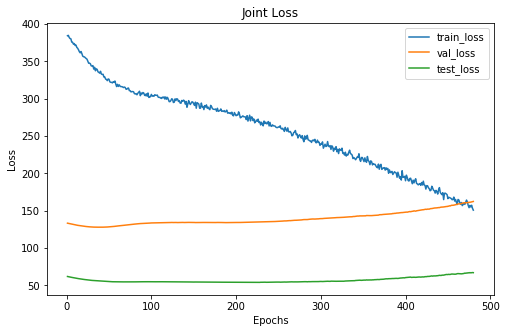

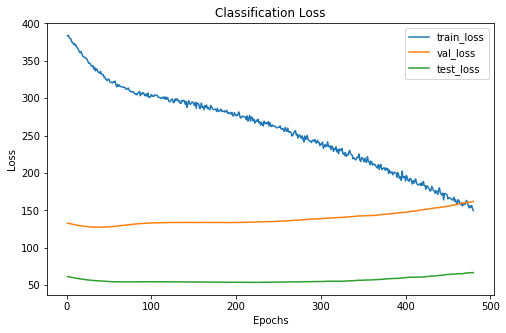

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  24   8
10  16  15
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     42      22
 1      150     51      23
 2       66     27      11
xxxxxxxxxxxxxx epoch: 180 xxxxxxxxxxxxxx


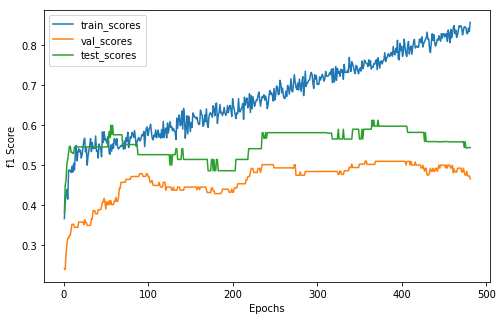

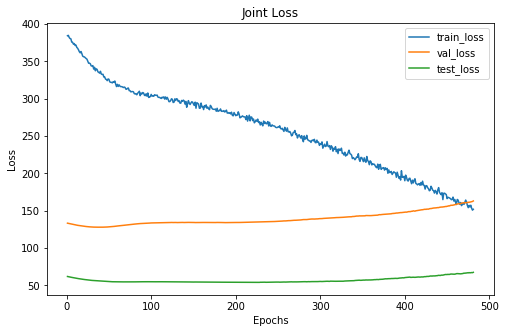

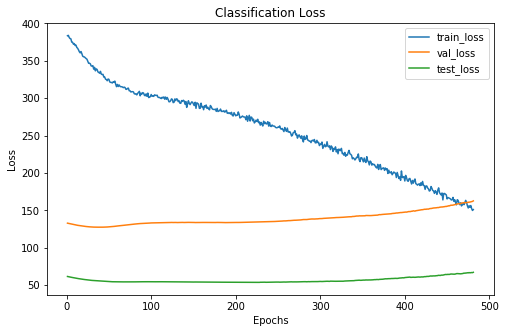

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  23   8
10  16  15
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     43      22
 1      145     50      23
 2       68     27      11
xxxxxxxxxxxxxx epoch: 181 xxxxxxxxxxxxxx


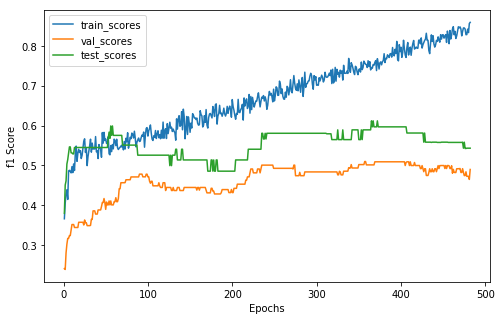

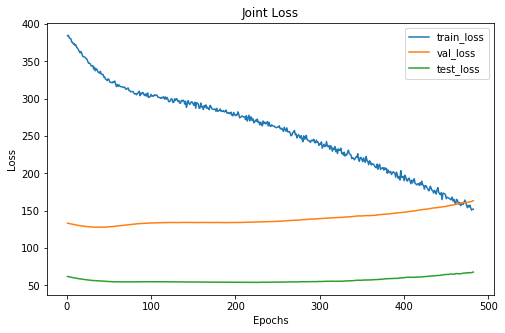

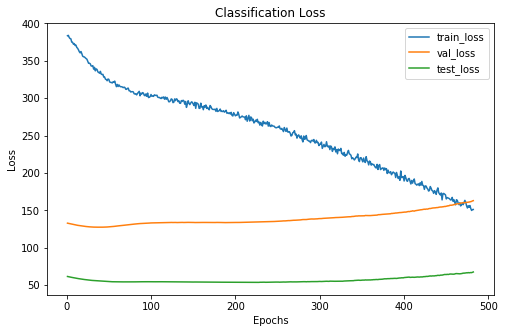

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
14  24   8
10  15  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      141     43      22
 1      146     49      23
 2       69     28      11
xxxxxxxxxxxxxx epoch: 182 xxxxxxxxxxxxxx


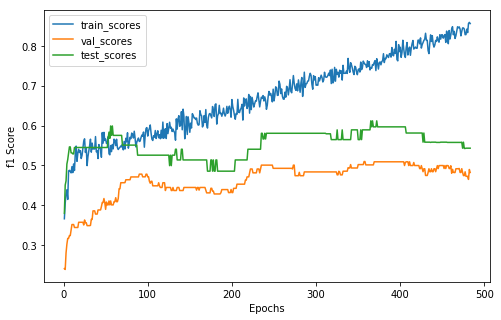

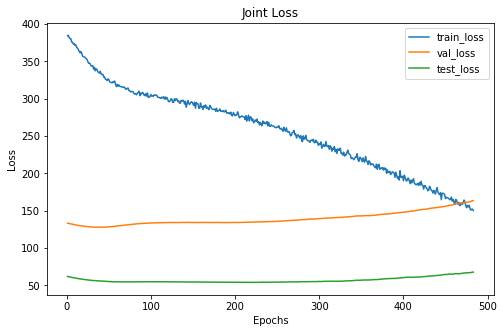

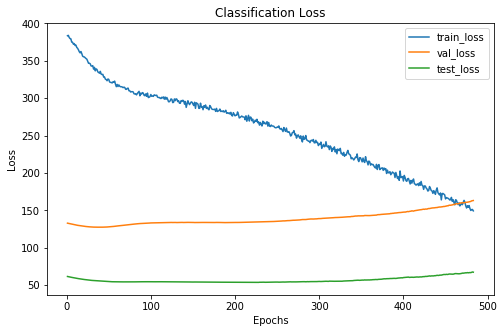

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  24   8
10  15  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      141     42      22
 1      148     50      23
 2       67     28      11
xxxxxxxxxxxxxx epoch: 183 xxxxxxxxxxxxxx


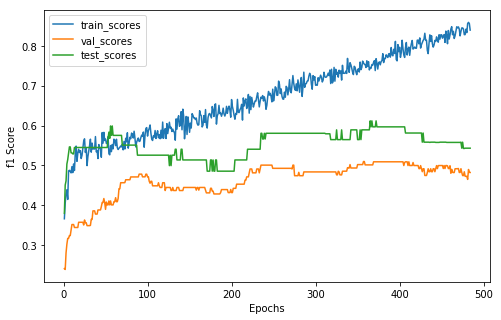

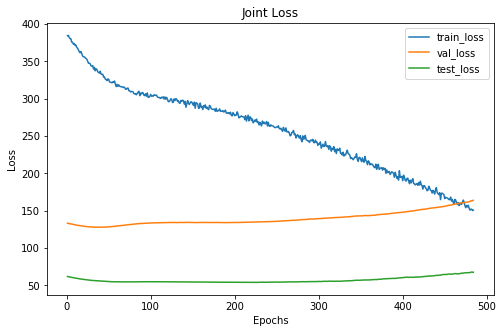

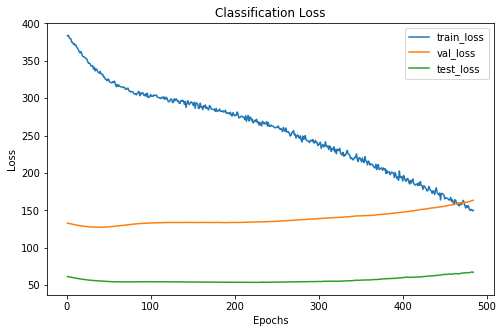

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  24   8
10  15  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      136     42      22
 1      148     50      23
 2       72     28      11
xxxxxxxxxxxxxx epoch: 184 xxxxxxxxxxxxxx


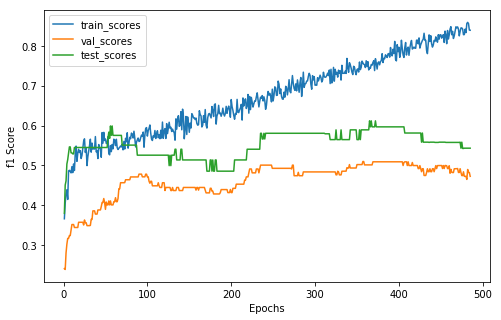

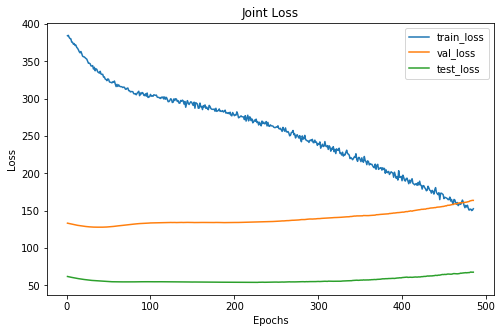

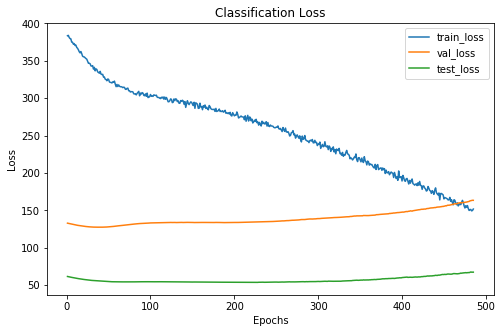

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
14  24   8
10  16  15
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      144     42      22
 1      142     51      23
 2       70     27      11
xxxxxxxxxxxxxx epoch: 185 xxxxxxxxxxxxxx


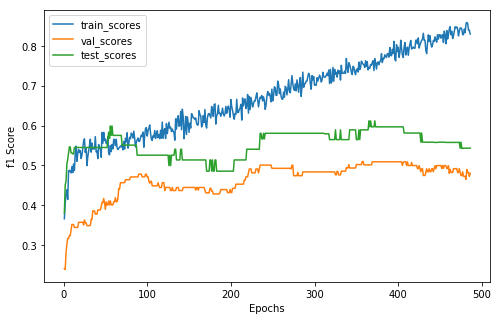

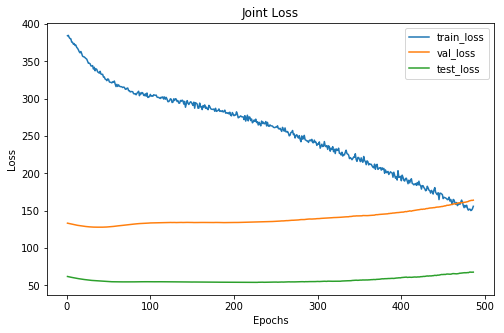

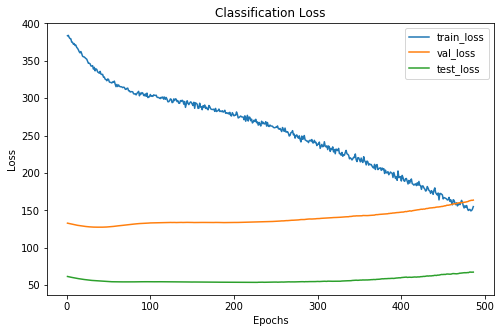

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
14  24   8
10  16  15
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      141     43      22
 1      152     50      23
 2       63     27      11
xxxxxxxxxxxxxx epoch: 186 xxxxxxxxxxxxxx


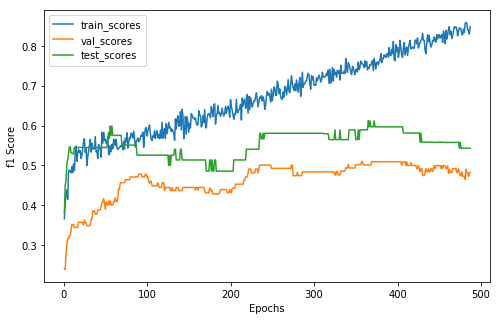

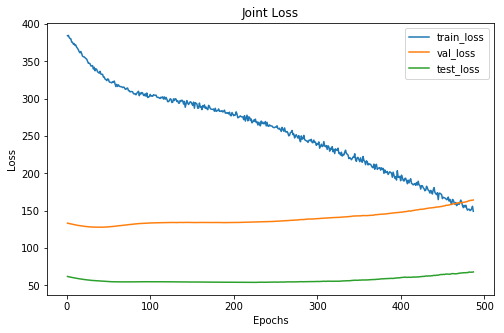

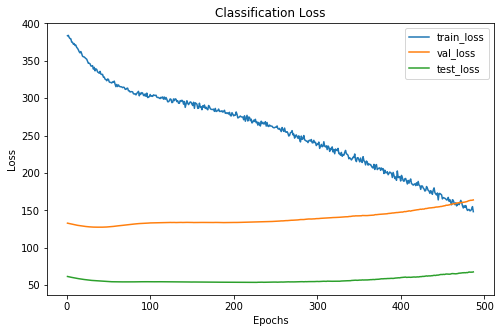

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
15  23   8
10  15  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      138     44      22
 1      148     48      23
 2       70     28      11
xxxxxxxxxxxxxx epoch: 187 xxxxxxxxxxxxxx


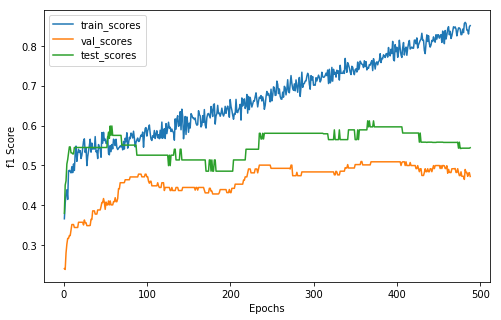

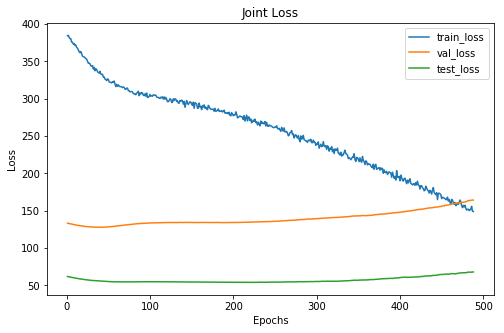

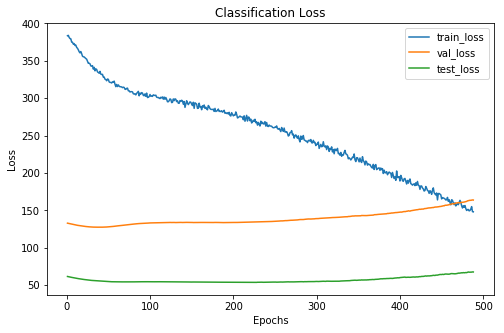

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
15  23   8
10  16  15
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     44      23
 1      142     49      22
 2       74     27      11
xxxxxxxxxxxxxx epoch: 188 xxxxxxxxxxxxxx


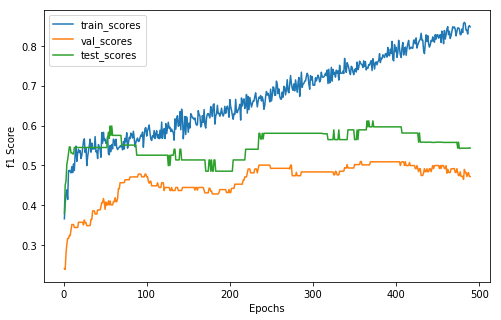

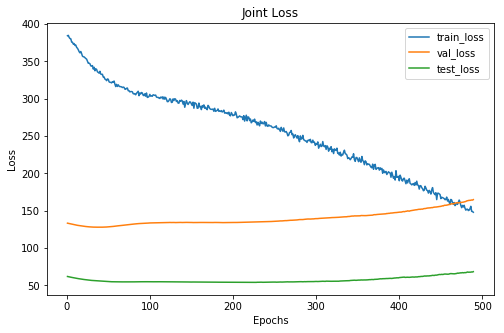

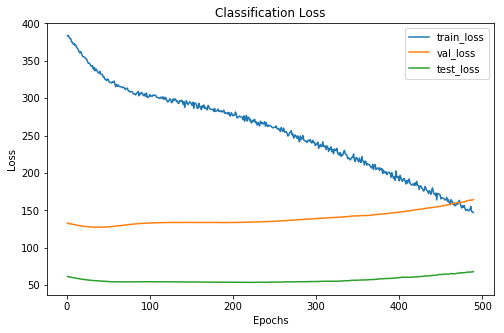

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
15  23   8
 9  17  15
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     43      22
 1      146     50      23
 2       70     27      11
xxxxxxxxxxxxxx epoch: 189 xxxxxxxxxxxxxx


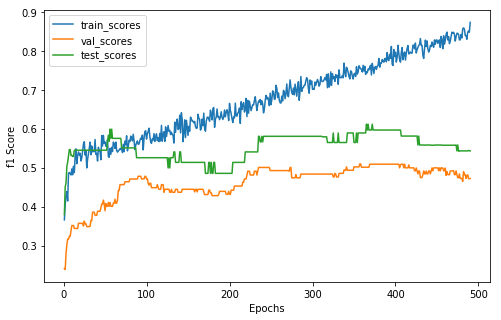

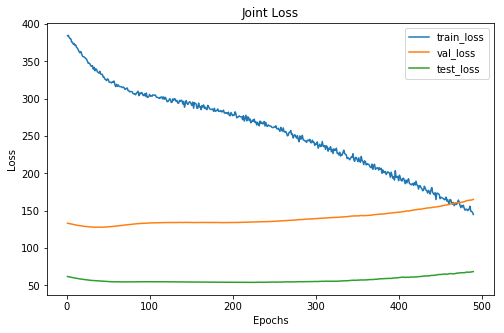

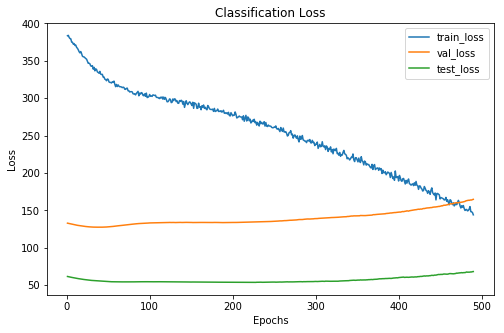

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
15  23   8
 9  17  15
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     43      22
 1      143     50      23
 2       70     27      11
xxxxxxxxxxxxxx epoch: 190 xxxxxxxxxxxxxx


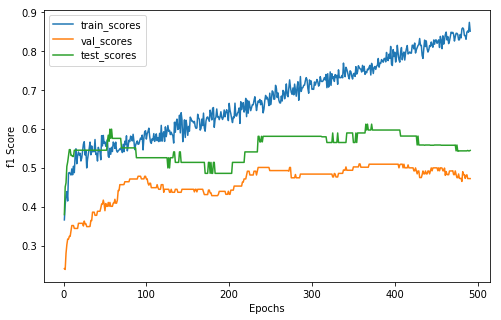

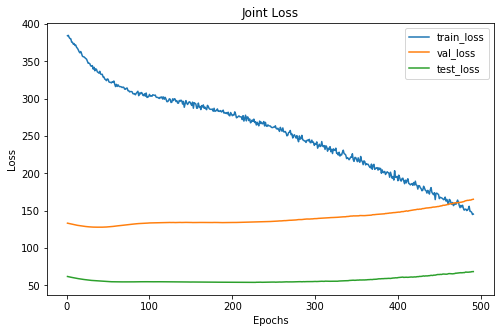

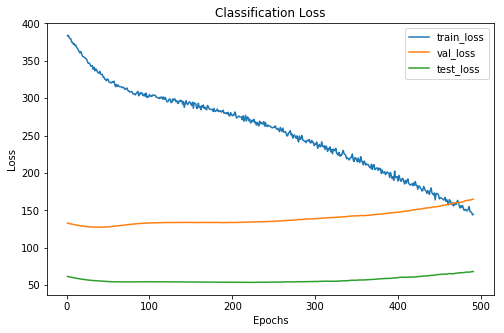

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
15  23   8
 9  17  15
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     43      23
 1      144     50      22
 2       69     27      11
xxxxxxxxxxxxxx epoch: 191 xxxxxxxxxxxxxx


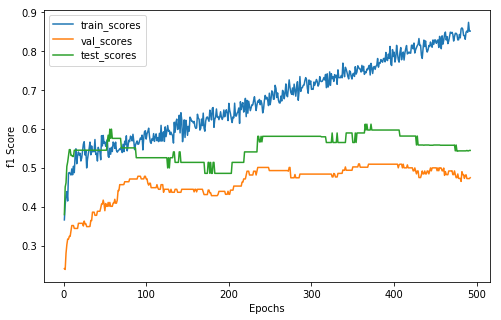

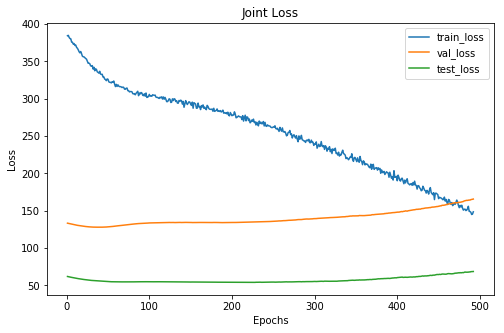

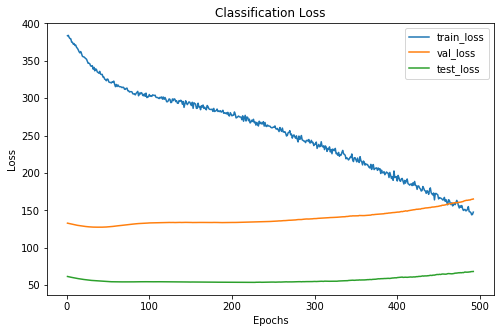

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  23   8
 9  16  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      141     42      23
 1      143     50      22
 2       72     28      11
xxxxxxxxxxxxxx epoch: 192 xxxxxxxxxxxxxx


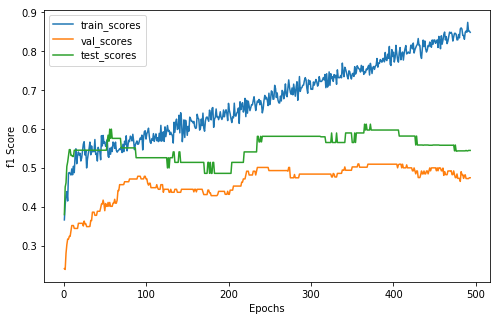

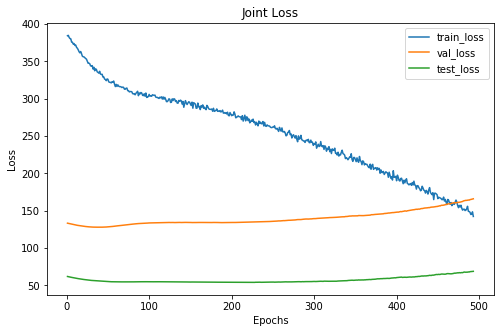

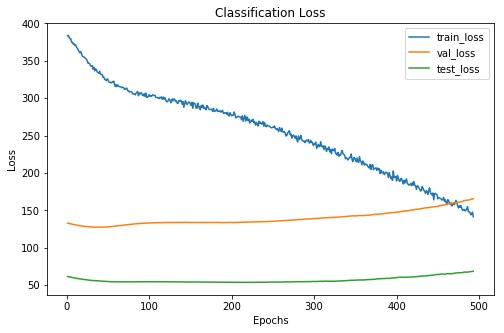

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  23   8
 9  16  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      146     42      23
 1      139     50      22
 2       71     28      11
xxxxxxxxxxxxxx epoch: 193 xxxxxxxxxxxxxx


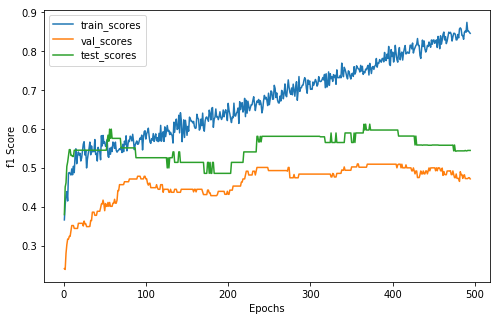

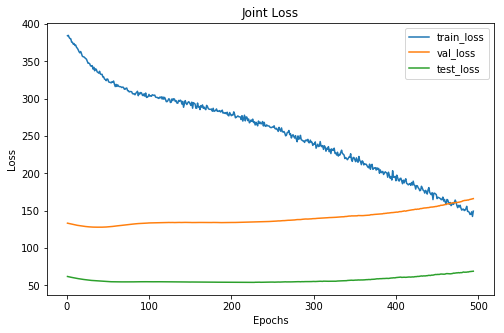

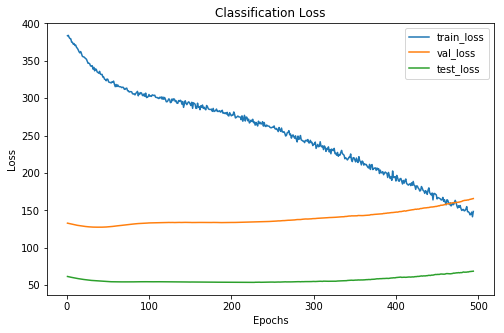

Cofusion Matrix For Val Set: 
--  --  --
20   9   4
16  22   8
 9  17  15
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      141     45      23
 1      146     48      22
 2       69     27      11
xxxxxxxxxxxxxx epoch: 194 xxxxxxxxxxxxxx


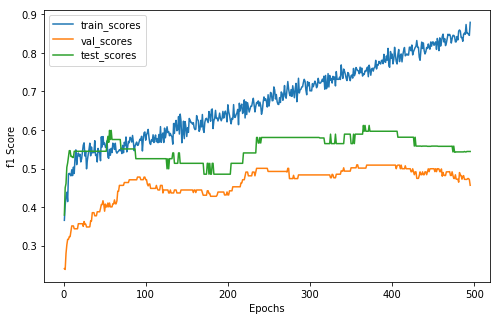

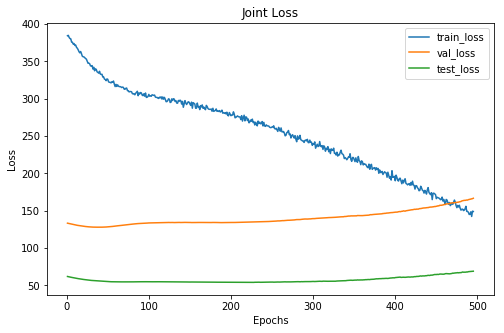

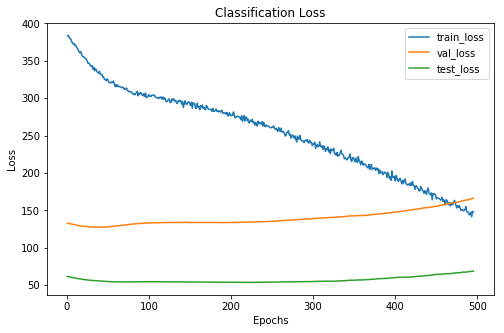

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  22   8
 9  17  15
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      144     43      23
 1      144     50      22
 2       68     27      11
xxxxxxxxxxxxxx epoch: 195 xxxxxxxxxxxxxx


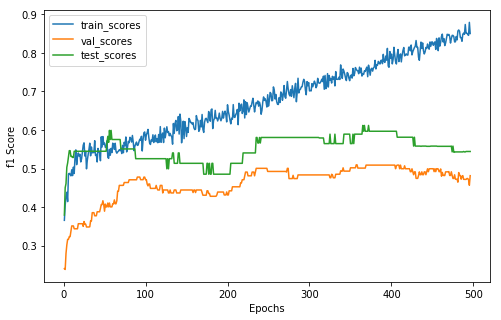

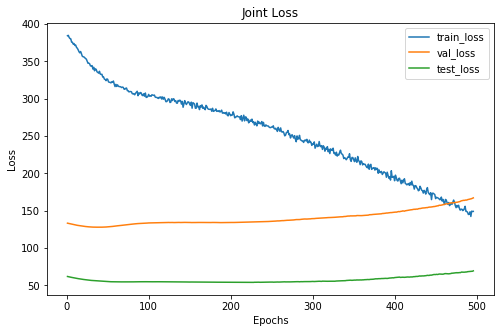

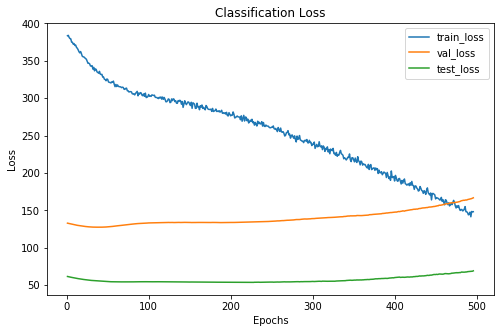

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
15  23   8
 9  16  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     43      23
 1      151     49      22
 2       65     28      11
xxxxxxxxxxxxxx epoch: 196 xxxxxxxxxxxxxx


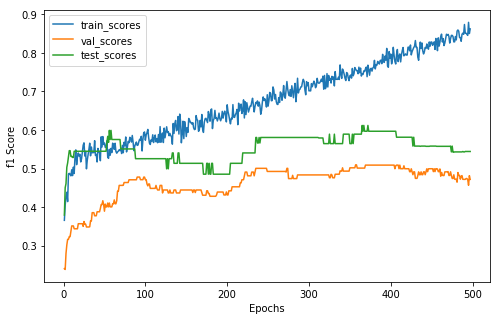

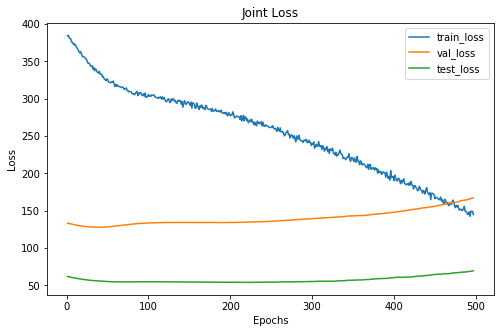

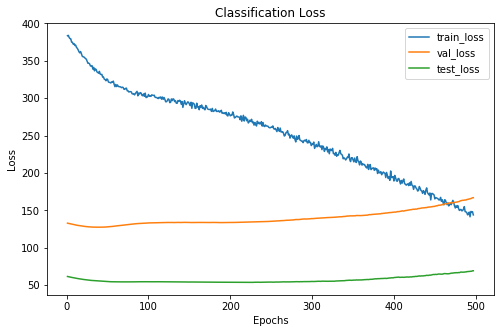

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
15  23   8
 9  17  15
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     43      23
 1      143     50      22
 2       70     27      11
xxxxxxxxxxxxxx epoch: 197 xxxxxxxxxxxxxx


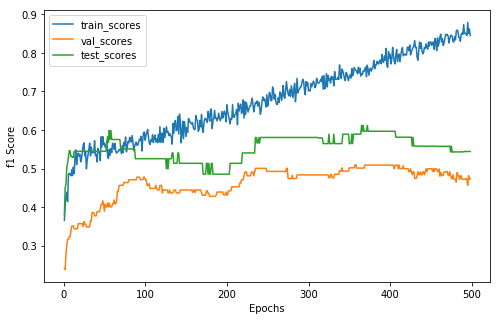

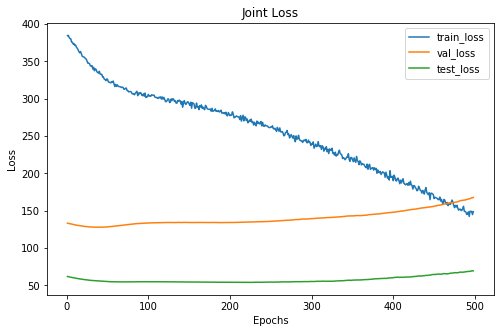

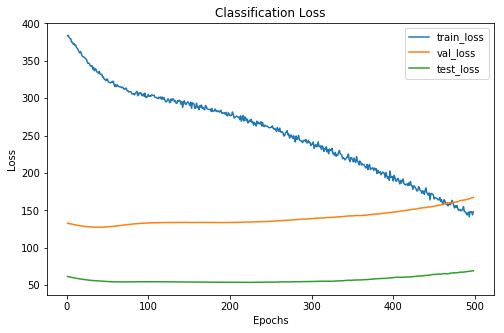

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  23   8
 9  16  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      139     42      23
 1      149     50      22
 2       68     28      11
xxxxxxxxxxxxxx epoch: 198 xxxxxxxxxxxxxx


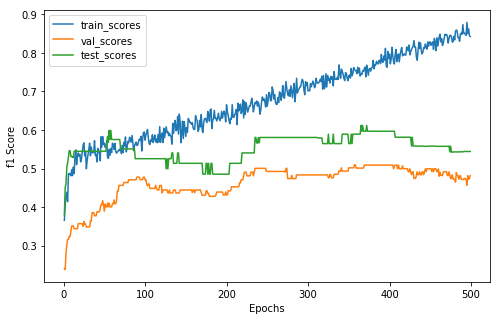

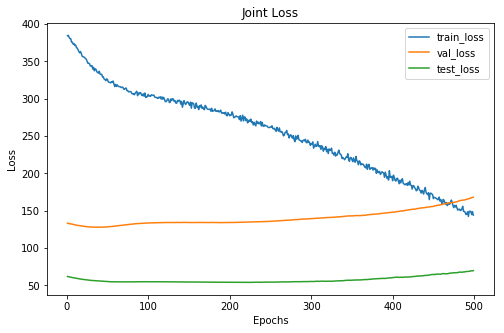

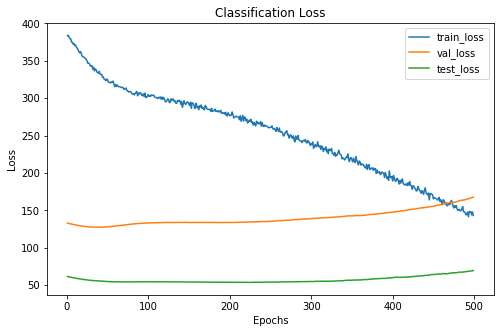

Cofusion Matrix For Val Set: 
--  --  --
19  10   4
15  23   8
 9  16  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      141     43      23
 1      145     49      22
 2       70     28      11
xxxxxxxxxxxxxx epoch: 199 xxxxxxxxxxxxxx


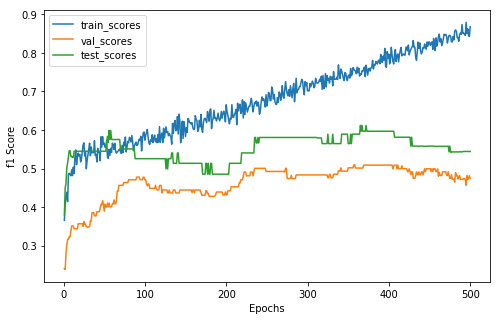

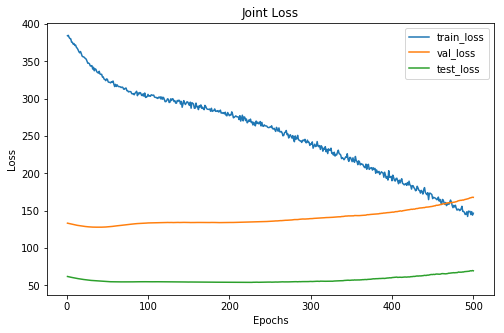

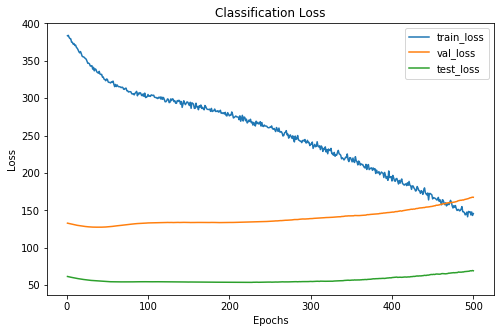

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  23   8
 9  16  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     42      23
 1      146     50      22
 2       67     28      11
xxxxxxxxxxxxxx epoch: 200 xxxxxxxxxxxxxx


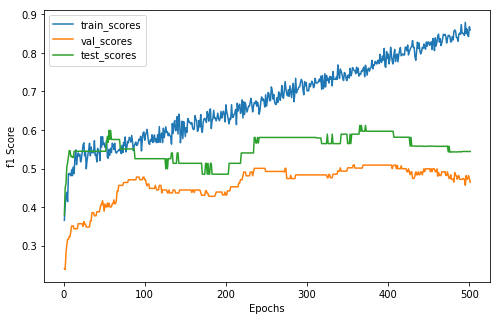

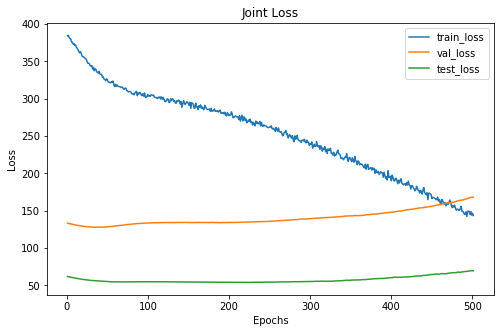

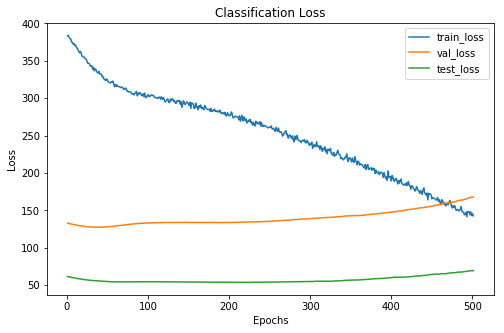

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  23   8
 9  17  15
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      141     42      23
 1      143     51      22
 2       72     27      11
xxxxxxxxxxxxxx epoch: 201 xxxxxxxxxxxxxx


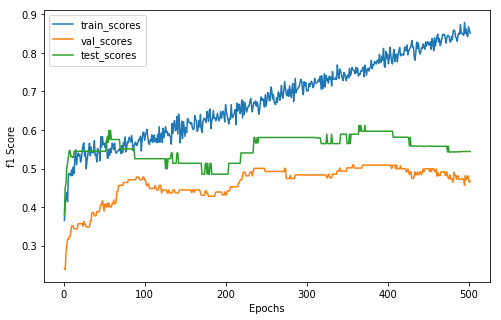

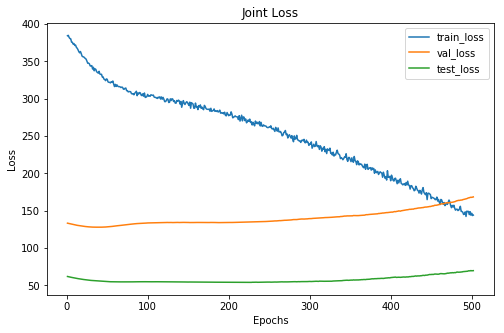

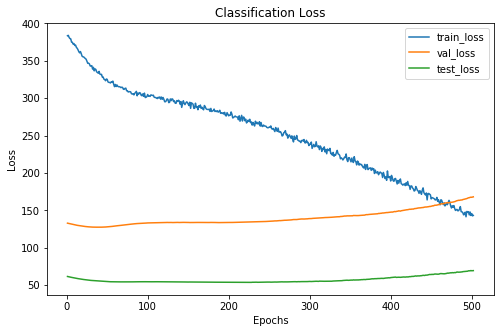

Cofusion Matrix For Val Set: 
--  --  --
17  12   4
15  23   8
 9  16  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      142     41      23
 1      141     51      22
 2       73     28      11
xxxxxxxxxxxxxx epoch: 202 xxxxxxxxxxxxxx


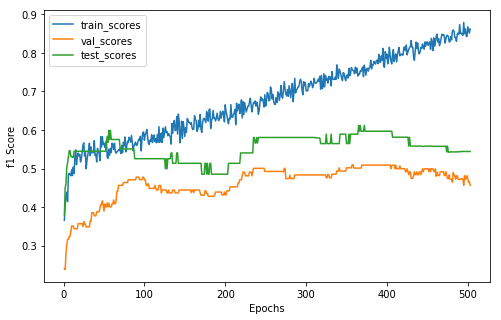

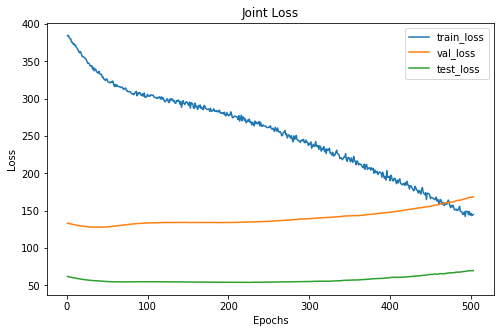

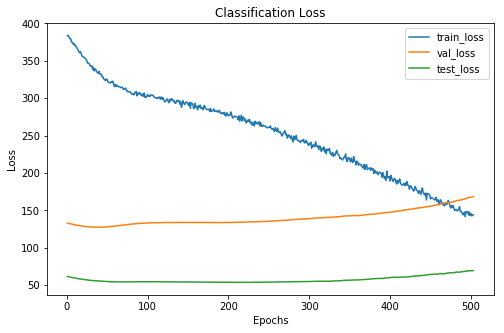

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  22   8
 9  17  15
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     43      23
 1      147     50      22
 2       69     27      11
xxxxxxxxxxxxxx epoch: 203 xxxxxxxxxxxxxx


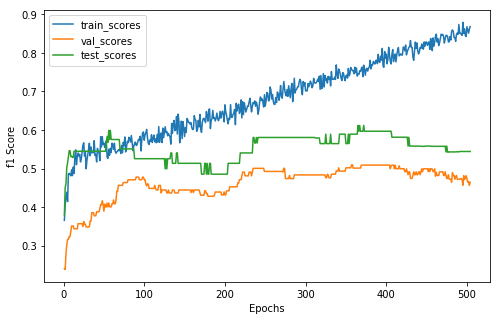

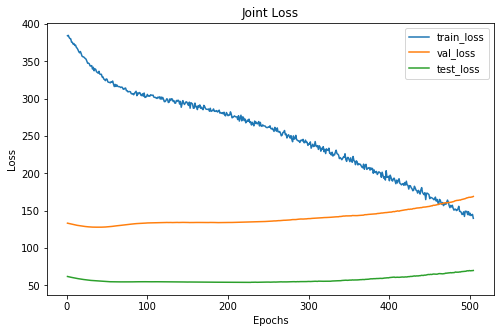

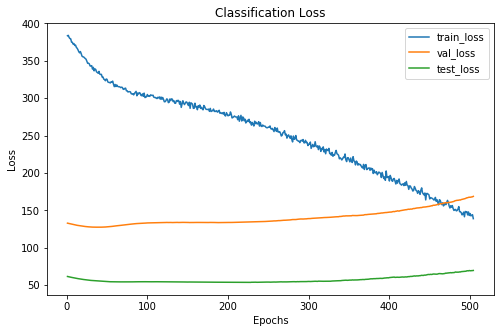

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  23   8
 9  17  15
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      141     42      23
 1      143     51      22
 2       72     27      11
xxxxxxxxxxxxxx epoch: 204 xxxxxxxxxxxxxx


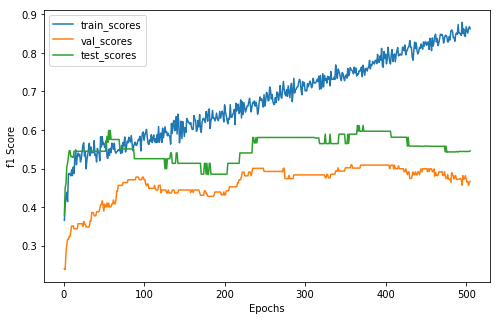

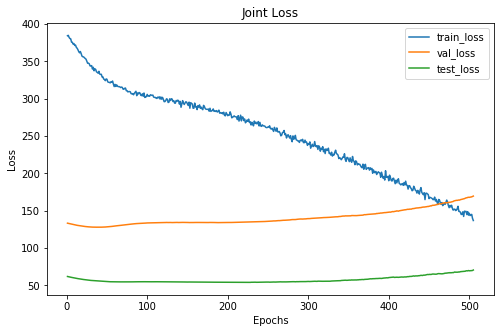

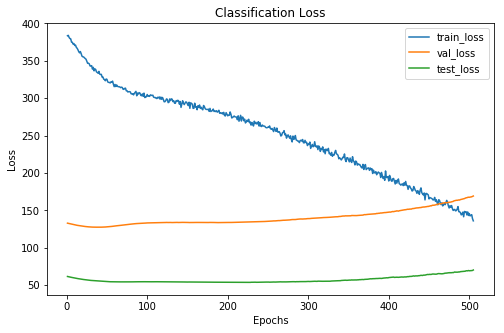

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  22   8
 9  16  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      139     43      24
 1      141     49      21
 2       76     28      11
xxxxxxxxxxxxxx epoch: 205 xxxxxxxxxxxxxx


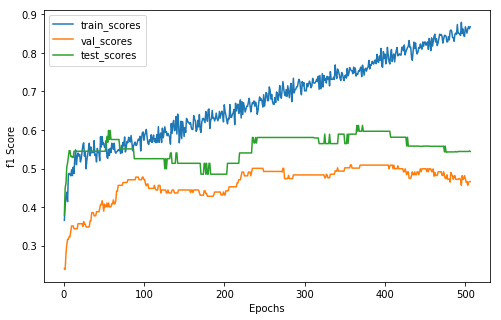

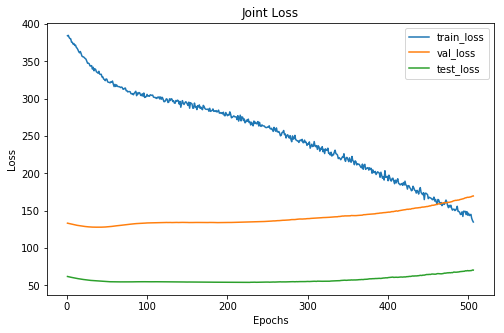

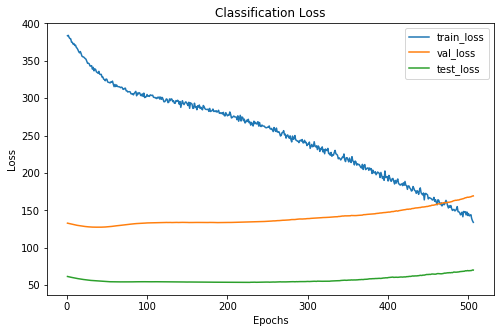

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  22   8
 9  16  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      142     43      23
 1      143     49      22
 2       71     28      11
xxxxxxxxxxxxxx epoch: 206 xxxxxxxxxxxxxx


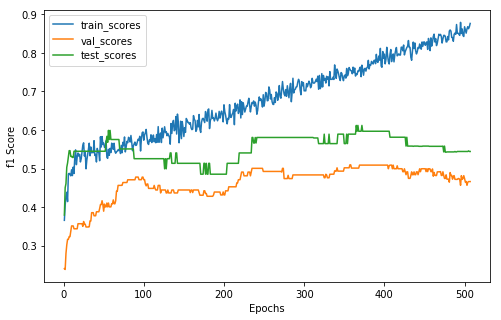

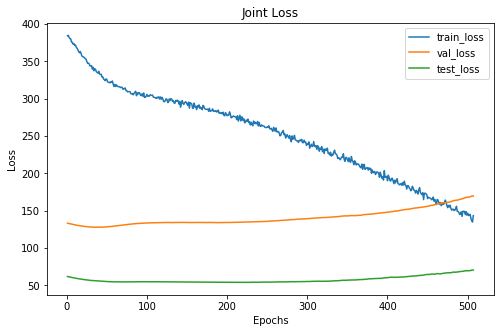

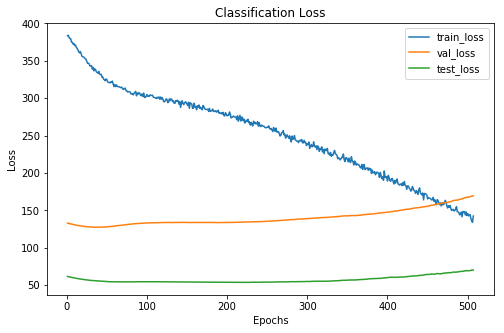

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  22   8
 9  16  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     43      23
 1      145     49      22
 2       71     28      11
xxxxxxxxxxxxxx epoch: 207 xxxxxxxxxxxxxx


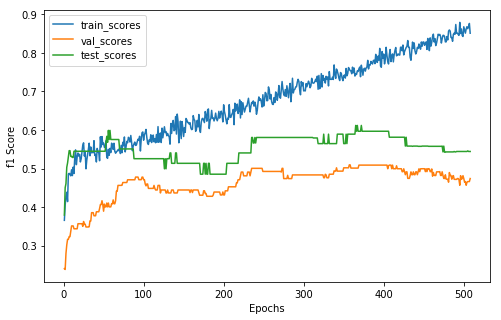

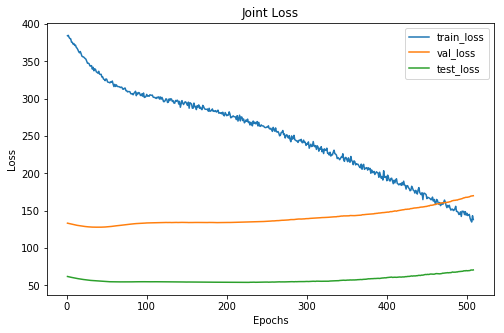

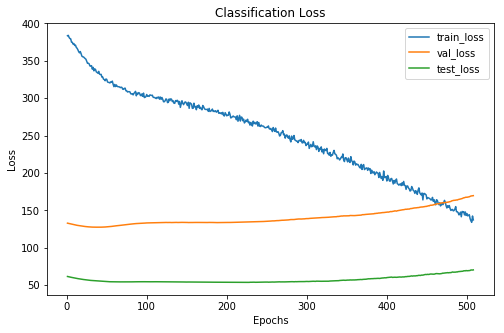

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
15  23   8
 9  16  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     42      23
 1      145     50      22
 2       71     28      11
xxxxxxxxxxxxxx epoch: 208 xxxxxxxxxxxxxx


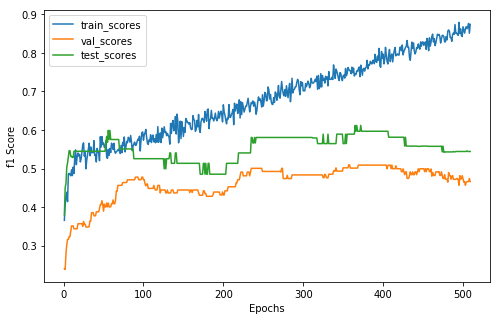

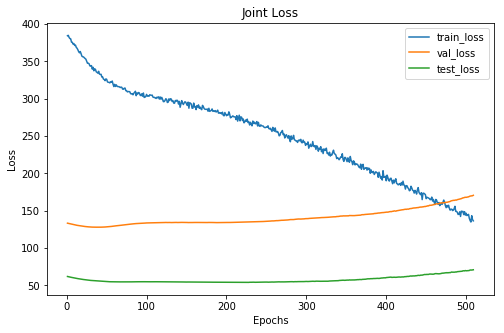

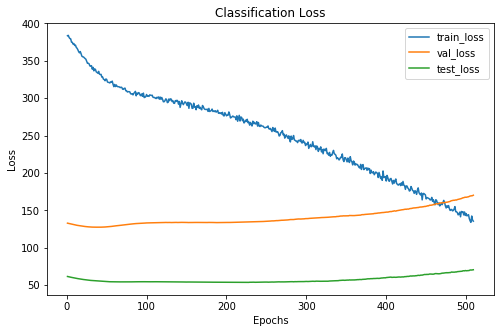

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  22   8
 9  16  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      137     43      23
 1      146     49      22
 2       73     28      11
xxxxxxxxxxxxxx epoch: 209 xxxxxxxxxxxxxx


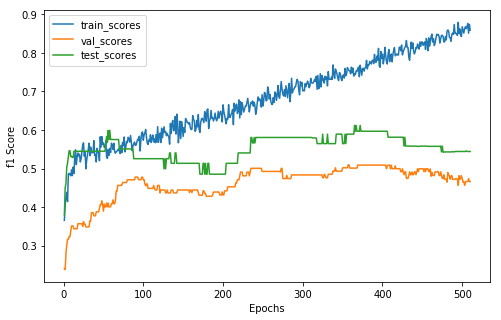

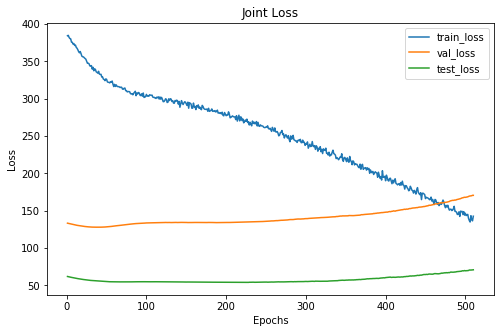

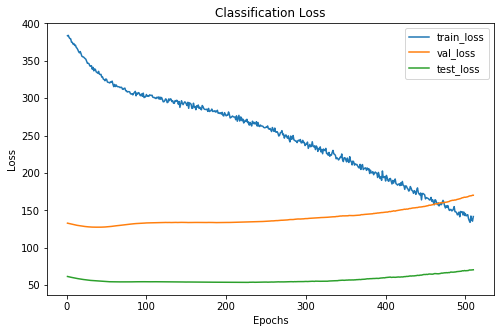

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  22   8
 9  16  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      140     43      23
 1      149     49      22
 2       67     28      11
xxxxxxxxxxxxxx epoch: 210 xxxxxxxxxxxxxx


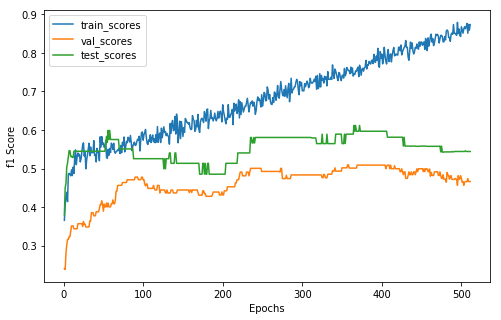

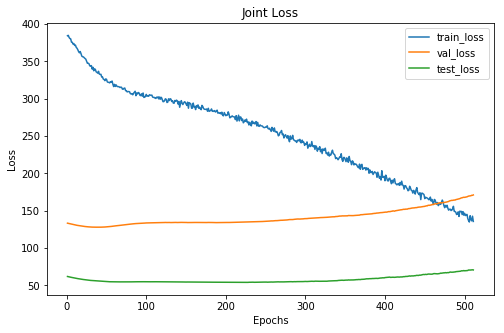

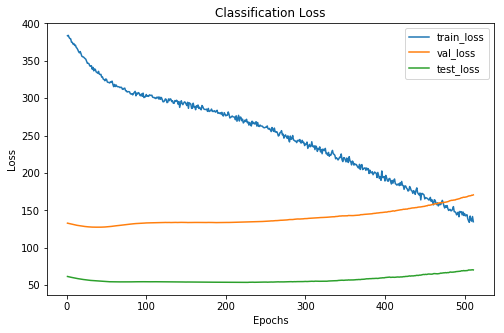

Cofusion Matrix For Val Set: 
--  --  --
17  12   4
15  23   8
 9  16  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      143     41      23
 1      144     51      22
 2       69     28      11
xxxxxxxxxxxxxx epoch: 211 xxxxxxxxxxxxxx


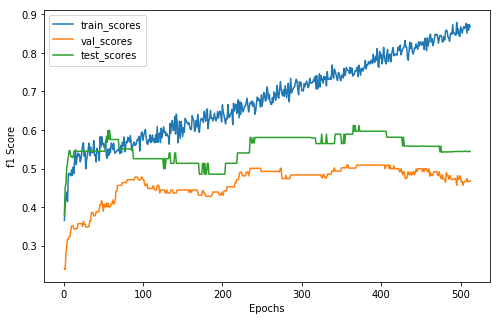

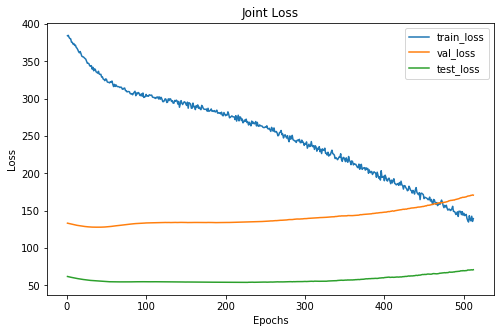

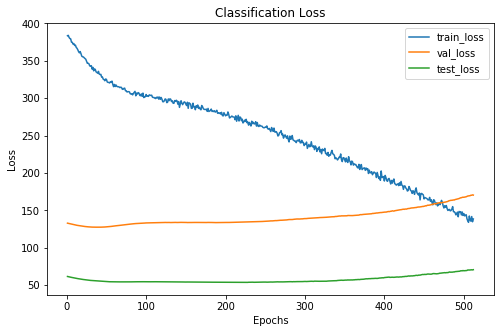

Cofusion Matrix For Val Set: 
--  --  --
17  12   4
16  22   8
 9  15  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      139     42      23
 1      148     49      22
 2       69     29      11
xxxxxxxxxxxxxx epoch: 212 xxxxxxxxxxxxxx


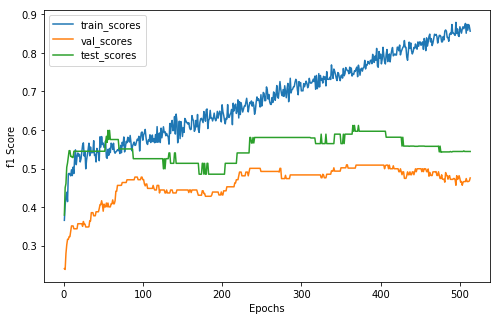

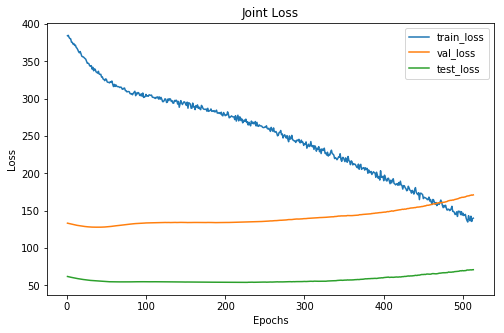

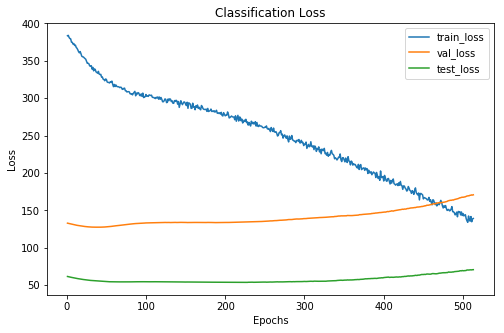

Cofusion Matrix For Val Set: 
--  --  --
18  11   4
16  22   8
 9  15  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      139     43      23
 1      150     48      22
 2       67     29      11


In [ ]:
# total_loss_over_epochs, scores_over_epochs = plotting.get_empty_stat_over_n_epoch_dictionaries()
# reconstruction_loss_over_epochs = deepcopy(total_loss_over_epochs)
# classification_loss_over_epochs = deepcopy(total_loss_over_epochs)
# validation_user_statistics_over_epochs = []


for epoch in range(n_epochs):
    
    (train_total_loss, train_total_reconstruction_loss , train_total_classification_loss, 
     train_labels, train_preds, train_users) = trainer.evaluate_multitask_learner(data, 
                                                                      'train_ids',
                                                                      model,
                                                                      reconstruction_criterion ,
                                                                      classification_criterion,
                                                                      optimizer=optimizer,
                                                                      alpha=alpha,
                                                                      beta=beta,
                                                                      use_histogram=use_historgram)
    
    (val_total_loss, val_total_reconstruction_loss , val_total_classification_loss, 
     val_labels, val_preds, val_users) =  trainer.evaluate_multitask_learner(data,
                                                                  'val_ids',
                                                                  model,
                                                                  reconstruction_criterion,
                                                                  classification_criterion,
                                                                  alpha=alpha,
                                                                  beta=beta,
                                                                  use_histogram=use_historgram)
    
    (test_total_loss, test_total_reconstruction_loss , test_total_classification_loss, 
     test_labels, test_preds, test_users) =  trainer.evaluate_multitask_learner(data, 
                                                                    'test_ids',
                                                                    model,
                                                                    reconstruction_criterion,
                                                                    classification_criterion,
                                                                    alpha=alpha,
                                                                    beta=beta,
                                                                    use_histogram=use_historgram)
    
    ######## Appending losses ######## 
    total_loss_over_epochs['train_loss'].append(train_total_loss)
    total_loss_over_epochs['val_loss'].append(val_total_loss)
    total_loss_over_epochs['test_loss'].append(test_total_loss)
    
    reconstruction_loss_over_epochs['train_loss'].append(train_total_reconstruction_loss)
    reconstruction_loss_over_epochs['val_loss'].append(val_total_reconstruction_loss)
    reconstruction_loss_over_epochs['test_loss'].append(test_total_reconstruction_loss)
    
    classification_loss_over_epochs['train_loss'].append(train_total_classification_loss)
    classification_loss_over_epochs['val_loss'].append(val_total_classification_loss)
    classification_loss_over_epochs['test_loss'].append(test_total_classification_loss)

    
    ######## Appending Metrics ######## 
    train_scores = metrics.precision_recall_fscore_support(conversions.tensor_list_to_int_list(train_labels),
                                                           conversions.tensor_list_to_int_list(train_preds), average='weighted')
    val_scores = metrics.precision_recall_fscore_support(conversions.tensor_list_to_int_list(val_labels),
                                                         conversions.tensor_list_to_int_list(val_preds), average='weighted')
    test_scores = metrics.precision_recall_fscore_support(conversions.tensor_list_to_int_list(test_labels),
                                                          conversions.tensor_list_to_int_list(test_preds), average='weighted')

    scores_over_epochs['train_scores'].append(train_scores)
    scores_over_epochs['val_scores'].append(val_scores)
    scores_over_epochs['test_scores'].append(test_scores)
    
    validation_user_statistics_over_epochs.append(statistics.generate_training_statistics_for_user(val_labels, 
                                                                                                val_preds, 
                                                                                                val_users))

    if epoch%1 == 0:
        print("xxxxxxxxxxxxxx epoch: {} xxxxxxxxxxxxxx".format(epoch))
        plotting.plot_score_over_n_epochs(scores_over_epochs, score_type='f1', fig_size=(8,5))
        plotting.plot_loss_over_n_epochs(total_loss_over_epochs, fig_size=(8, 5), title="Joint Loss")
#         plotting.plot_loss_over_n_epochs(reconstruction_loss_over_epochs, fig_size=(8, 5), title="Reconstruction Loss")
        plotting.plot_loss_over_n_epochs(classification_loss_over_epochs, fig_size=(8, 5), title="Classification Loss")
        
        print("Cofusion Matrix For Val Set: ")
        print(tabulate( metrics.confusion_matrix(conversions.tensor_list_to_int_list(val_labels), 
                                                 conversions.tensor_list_to_int_list(val_preds))))
        print("Predicted Label Distribution:")
        print(statistics.get_train_test_val_label_counts_from_predictions(train_preds, val_preds, test_preds))


In [7]:
outfile = open('../data/training_data/midterm_splits/{}_dropout.matrix'.format(data_file_name), 'wb')
pickle.dump(validation_user_statistics_over_epochs, outfile)
outfile.close()